<a href="https://colab.research.google.com/github/plaban1981/Deep-Learning-KERAS/blob/master/Traffics_Sign_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


https://www.murtazahassan.com/courses/opencv-projects/lesson/code-5/

In [3]:
import os
import random
import pandas as pd
import numpy as np
import cv2
from PIL import Image
#
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout,Conv2D,MaxPooling2D,Flatten
from tensorflow.keras.optimizers import Adam,RMSprop
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

## Set Parameters

In [ ]:
#! unzip "/content/drive/My Drive/Adrain/Murtuza/myData.zip" -d "/content/drive/My Drive/Adrain/Murtuza/"
!unzip "/content/labels.zip" -d "/content/drive/My Drive/Adrain/Murtuza/"

Archive:  /content/labels.zip
  inflating: /content/drive/My Drive/Adrain/Murtuza/labels.csv  


In [4]:
path = "/content/drive/My Drive/Adrain/Murtuza/myData/"
classes = os.listdir(path)

In [5]:
len(classes)

43

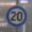

In [8]:
Image.open("/content/drive/My Drive/Adrain/Murtuza/myData/0/0_10000_1577671998.6491628.png")

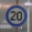

In [7]:
Image.open("/content/drive/My Drive/Adrain/Murtuza/myData/0/0_10001_1577671998.65016.png")

# simple & hassle-free progress bars

In [7]:
import tqdm
from tqdm import tqdm 

# Preprocessing Images

In [8]:
images = []
labels = []
for img_folder in tqdm(os.listdir(path)):
  #print(img_folder)
  image_list = os.listdir(path + str(img_folder))
  #print(image_list)
  imgPaths  = path + img_folder + "/"
  #print(imgPaths)
  for i in image_list:
    finalpath = imgPaths + i
    #print(imgPaths)
    img = cv2.imread(finalpath)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img = cv2.equalizeHist(img)
    img = img/255.0
    images.append(img)
    labels.append(img_folder)
    #break

100%|██████████| 43/43 [1:29:47<00:00, 125.28s/it]


In [9]:
images[0].shape

(32, 32)

In [10]:
images = np.array(images)
labels = np.array(labels)

In [11]:
images.shape,labels.shape

((34799, 32, 32), (34799,))

In [12]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(images, labels, test_size=0.2,random_state=42)
X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size=0.2,random_state=42)

In [13]:
imageDimensions =(32,32,3)
print("Data Shapes")
print("Train",end = "");print(X_train.shape,y_train.shape)
print("Validation",end = "");print(X_validation.shape,y_validation.shape)
print("Test",end = "");print(X_test.shape,y_test.shape)


Data Shapes
Train(22271, 32, 32) (22271,)
Validation(5568, 32, 32) (5568,)
Test(6960, 32, 32) (6960,)


In [14]:
data=pd.read_csv("/content/drive/My Drive/Adrain/Murtuza/labels.csv")
print("data shape ",data.shape,type(data))

data shape  (43, 2) <class 'pandas.core.frame.DataFrame'>


In [15]:
data.head()

,ClassId,Name
0,0,Speed limit (20km/h)
1,1,Speed limit (30km/h)
2,2,Speed limit (50km/h)
3,3,Speed limit (60km/h)
4,4,Speed limit (70km/h)


In [ ]:
classes[5:]

['13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '2',
 '20',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '28',
 '29',
 '3',
 '30',
 '31',
 '32',
 '33',
 '34',
 '35',
 '36',
 '37',
 '38',
 '39',
 '4',
 '40',
 '41',
 '42',
 '5',
 '6',
 '7',
 '8',
 '9']

In [16]:
data.tail()

,ClassId,Name
38,38,Keep right
39,39,Keep left
40,40,Roundabout mandatory
41,41,End of no passing
42,42,End of no passing by vechiles over 3.5 metric ...


In [85]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43 entries, 0 to 42
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   ClassId  43 non-null     int64 
 1   Name     43 non-null     object
dtypes: int64(1), object(1)
memory usage: 816.0+ bytes


# Display Label Counts

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


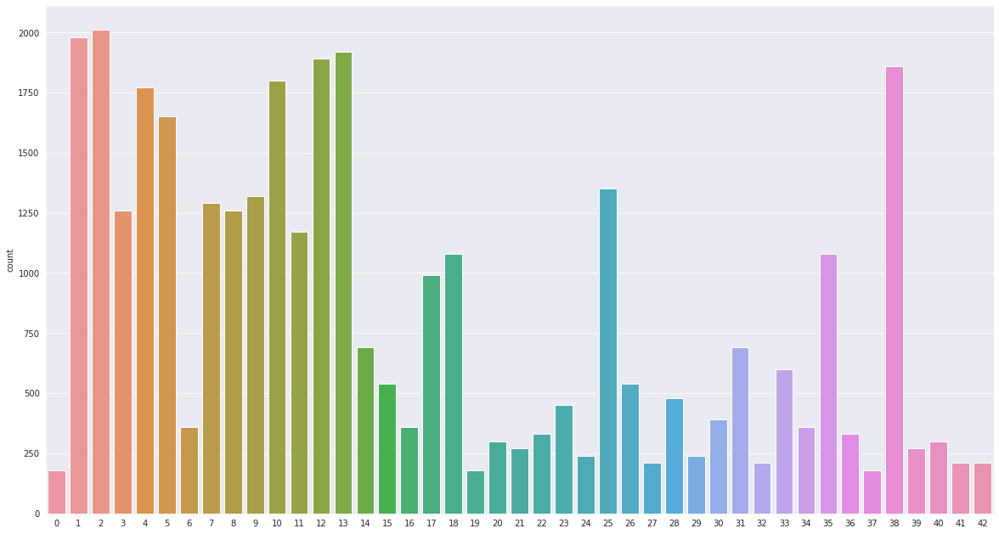

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
classsess = labels.astype(int)
sns.set_style('darkgrid')
plt.figure(figsize=(20,11))
sns.countplot(classsess)
plt.show()

# TO CHECK IF THE TRAINING IS DONE PROPERLY

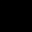

In [18]:
from google.colab.patches import cv2_imshow
#cv2.imshow("GrayScale Images",X_train[random.randint(0,len(X_train)-1)])
cv2_imshow(X_train[random.randint(0,len(X_train)-1)])

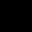

In [ ]:
cv2_imshow(X_validation[random.randint(0,len(X_validation)-1)])

# ADD A DEPTH OF 1 as the model requires a 4 dimensional input

In [19]:
X_train=X_train.reshape(X_train.shape[0],X_train.shape[1],X_train.shape[2],1)
X_validation=X_validation.reshape(X_validation.shape[0],X_validation.shape[1],X_validation.shape[2],1)
X_test=X_test.reshape(X_test.shape[0],X_test.shape[1],X_test.shape[2],1)

# AUGMENTATAION OF IMAGES

In [20]:
dataGen= ImageDataGenerator(width_shift_range=0.1,   # 0.1 = 10%     IF MORE THAN 1 E.G 10 THEN IT REFFERS TO NO. OF  PIXELS EG 10 PIXELS
                            height_shift_range=0.1,
                            zoom_range=0.2,  # 0.2 MEANS CAN GO FROM 0.8 TO 1.2
                            shear_range=0.1,  # MAGNITUDE OF SHEAR ANGLE
                            rotation_range=10)  # DEGREES
dataGen.fit(X_train)
batches= dataGen.flow(X_train,y_train,batch_size=20)  # REQUESTING DATA GENRATOR TO GENERATE IMAGES  BATCH SIZE = NO. OF IMAGES CREAED EACH TIME ITS CALLED
X_batch,y_batch = next(batches)

# TO SHOW AGMENTED IMAGE SAMPLES

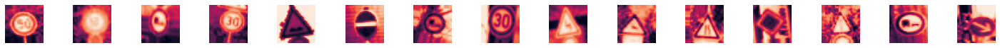

In [21]:
fig,axs=plt.subplots(1,15,figsize=(20,5))
fig.tight_layout()
 
for i in range(15):
    axs[i].imshow(X_batch[i].reshape(imageDimensions[0],imageDimensions[1]))
    axs[i].axis('off')
plt.show()
 

## One Hot encode the labels


In [22]:
y_train = to_categorical(y_train,len(classes))
y_validation = to_categorical(y_validation,len(classes))
y_test = to_categorical(y_test,len(classes))

In [23]:
y_train.shape,y_validation.shape,y_test.shape

((22271, 43), (5568, 43), (6960, 43))

In [24]:
y_train

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

# CONVOLUTION NEURAL NETWORK MODEL

In [28]:
batch_size_val=50  # how many to process together
steps_per_epoch_val=2000
epochs_val=10

In [26]:
def myModel():
    no_Of_Filters=60
    size_of_Filter=(5,5) # THIS IS THE KERNEL THAT MOVE AROUND THE IMAGE TO GET THE FEATURES.
                         # THIS WOULD REMOVE 2 PIXELS FROM EACH BORDER WHEN USING 32 32 IMAGE
    size_of_Filter2=(3,3)
    size_of_pool=(2,2)  # SCALE DOWN ALL FEATURE MAP TO GERNALIZE MORE, TO REDUCE OVERFITTING
    no_Of_Nodes = 500   # NO. OF NODES IN HIDDEN LAYERS
    model= Sequential()
    model.add((Conv2D(no_Of_Filters,size_of_Filter,input_shape=(imageDimensions[0],imageDimensions[1],1),activation='relu')))  
    # ADDING MORE CONVOLUTION LAYERS = LESS FEATURES BUT CAN CAUSE ACCURACY TO INCREASE
    model.add((Conv2D(no_Of_Filters, size_of_Filter, activation='relu')))
    model.add(MaxPooling2D(pool_size=size_of_pool)) # DOES NOT EFFECT THE DEPTH/NO OF FILTERS
 
    model.add((Conv2D(no_Of_Filters//2, size_of_Filter2,activation='relu')))
    model.add((Conv2D(no_Of_Filters // 2, size_of_Filter2, activation='relu')))
    model.add(MaxPooling2D(pool_size=size_of_pool))
    model.add(Dropout(0.5))
 
    model.add(Flatten())
    model.add(Dense(no_Of_Nodes,activation='relu'))
    model.add(Dropout(0.5)) # INPUTS NODES TO DROP WITH EACH UPDATE 1 ALL 0 NONE
    model.add(Dense(len(classes),activation='softmax')) # OUTPUT LAYER
    # COMPILE MODEL
    model.compile(Adam(lr=0.001),loss='categorical_crossentropy',metrics=['accuracy'])
    return model

# Train the Model

In [38]:
model = myModel()
print(model.summary())
history=model.fit(dataGen.flow(X_train,y_train,batch_size=32),steps_per_epoch=50,epochs=100,validation_data=(X_validation,y_validation))

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_32 (Conv2D)           (None, 28, 28, 60)        1560      
_________________________________________________________________
conv2d_33 (Conv2D)           (None, 24, 24, 60)        90060     
_________________________________________________________________
max_pooling2d_16 (MaxPooling (None, 12, 12, 60)        0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 10, 10, 30)        16230     
_________________________________________________________________
conv2d_35 (Conv2D)           (None, 8, 8, 30)          8130      
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 4, 4, 30)          0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 4, 4, 30)         

# Training Accuracy vs Validation Accuracy

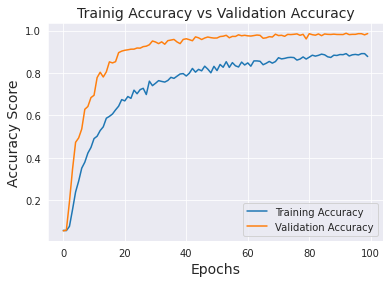

In [40]:
plt.plot(history.history['accuracy'],label='Training Accuracy')
plt.plot(history.history['val_accuracy'],label='Validation Accuracy')
plt.xlabel('Epochs',fontsize=14)
plt.ylabel('Accuracy Score',fontsize=14)
plt.title('Trainig Accuracy vs Validation Accuracy',fontsize=14)
plt.legend()
plt.show()


# Training Loss versus Validation Loss

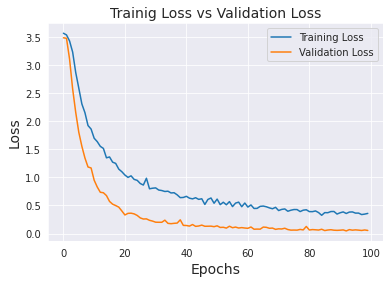

In [41]:
plt.plot(history.history['loss'],label='Training Loss')
plt.plot(history.history['val_loss'],label='Validation Loss')
plt.xlabel('Epochs',fontsize=14)
plt.ylabel('Loss',fontsize=14)
plt.title('Trainig Loss vs Validation Loss',fontsize=14)
plt.legend()
plt.show()

# Inference

In [43]:
!wget "https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcT97O2weixBZqAsYMKffSdaNMJP33kBC_PNNg&usqp=CAU"

--2020-10-13 10:42:53--  https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcT97O2weixBZqAsYMKffSdaNMJP33kBC_PNNg&usqp=CAU
Resolving encrypted-tbn0.gstatic.com (encrypted-tbn0.gstatic.com)... 173.194.217.113, 173.194.217.100, 173.194.217.102, ...
Connecting to encrypted-tbn0.gstatic.com (encrypted-tbn0.gstatic.com)|173.194.217.113|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9932 (9.7K) [image/png]
Saving to: ‘images?q=tbn:ANd9GcT97O2weixBZqAsYMKffSdaNMJP33kBC_PNNg&usqp=CAU’

images?q=tbn:ANd9Gc 100%[===================>]   9.70K  --.-KB/s    in 0s      

2020-10-13 10:42:53 (92.6 MB/s) - ‘images?q=tbn:ANd9GcT97O2weixBZqAsYMKffSdaNMJP33kBC_PNNg&usqp=CAU’ saved [9932/9932]



In [108]:
!wget "https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQHDEVGWHBjeVFD-8vbWleaxQA1t3RF5trVhQ&usqp=CAU"

--2020-10-13 11:45:54--  https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcQHDEVGWHBjeVFD-8vbWleaxQA1t3RF5trVhQ&usqp=CAU
Resolving encrypted-tbn0.gstatic.com (encrypted-tbn0.gstatic.com)... 74.125.31.101, 74.125.31.100, 74.125.31.102, ...
Connecting to encrypted-tbn0.gstatic.com (encrypted-tbn0.gstatic.com)|74.125.31.101|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5047 (4.9K) [image/png]
Saving to: ‘images?q=tbn:ANd9GcQHDEVGWHBjeVFD-8vbWleaxQA1t3RF5trVhQ&usqp=CAU’

images?q=tbn:ANd9Gc 100%[===================>]   4.93K  --.-KB/s    in 0s      

2020-10-13 11:45:54 (73.9 MB/s) - ‘images?q=tbn:ANd9GcQHDEVGWHBjeVFD-8vbWleaxQA1t3RF5trVhQ&usqp=CAU’ saved [5047/5047]



# Load Image from Internet

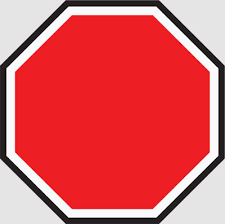

In [110]:
Image.open("/content/images?q=tbn:ANd9GcQHDEVGWHBjeVFD-8vbWleaxQA1t3RF5trVhQ&usqp=CAU")

# Preprocess the image as required by the model

In [123]:
threshold = 0.5         # PROBABLITY THRESHOLD
font = cv2.FONT_HERSHEY_SIMPLEX

In [111]:
test_image_path = "/content/images?q=tbn:ANd9GcQHDEVGWHBjeVFD-8vbWleaxQA1t3RF5trVhQ&usqp=CAU"

In [138]:
img = cv2.imread(test_image_path)
img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
img = cv2.resize(img, (32,32)) 
img = cv2.equalizeHist(img)
img = img/255.0
img_tensor = img.copy()
img_tensor = img_tensor.reshape(1,img_tensor.shape[0],img_tensor.shape[1],1)
print(img_tensor.shape)

(1, 32, 32, 1)


# Make Predictions

In [139]:
predictions = model.predict(img_tensor)
classIndex = model.predict_classes(img_tensor)
probabilityValue =np.amax(predictions)


In [126]:
label_map = data.to_dict()['Name']

In [130]:
label_map[classIndex[0]]

'No vechiles'

In [129]:
classIndex[0]

15

In [122]:
probabilityValue

0.53073925

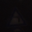

In [202]:
Image.open("/content/drive/My Drive/Adrain/Murtuza/myData/19/19_6630_1577671995.5720537.png")

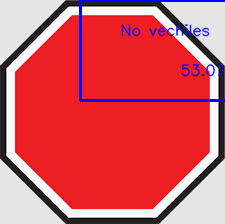

In [188]:
from google.colab.patches import cv2_imshow
if probabilityValue > threshold:
  #print(getCalssName(classIndex))
  img = cv2.imread(test_image_path)
  text = label_map[classIndex[0]]
  cv2.rectangle(img,(80,0),(300,100),(255,0,0),2)
  cv2.putText(img,text, (120, 35), font, 0.50, (255, 0, 0), 1, cv2.LINE_AA)
  cv2.putText(img, str(round(probabilityValue*100,2) )+"%", (180, 75), font, 0.5, (255, 0, 0), 1, cv2.LINE_AA)
  cv2_imshow(img)
  cv2.waitKey(0)
 

In [55]:
"""from tensorflow.keras.preprocessing.image import img_to_array,load_img
import numpy as np
img = load_img(test_image_path)
img_tensor = img_to_array(img)
img_tensor = np.expand_dims(img_tensor,axis=0)
img_tensor /=255.
print(img_tensor.shape)"""

'from tensorflow.keras.preprocessing.image import img_to_array,load_img\nimport numpy as np\nimg = load_img(test_image_path)\nimg_tensor = img_to_array(img)\nimg_tensor = np.expand_dims(img_tensor,axis=0)\nimg_tensor /=255.\nprint(img_tensor.shape)'

# Make Predictions

In [142]:
predictions = model.predict(img_tensor)

In [143]:
predictions

array([[7.41285447e-04, 2.99897947e-04, 5.88980911e-04, 2.43817177e-02,
        3.86551139e-03, 3.72041925e-03, 1.47472048e-04, 1.52618084e-02,
        2.35246316e-01, 1.61095690e-02, 2.51277437e-04, 6.60226797e-05,
        2.50913687e-02, 4.97845234e-03, 1.08644500e-01, 4.39369917e-01,
        1.64554163e-03, 2.12303060e-03, 1.56690192e-03, 1.37566865e-04,
        4.32097382e-04, 2.73649766e-05, 2.08060052e-02, 2.67050113e-04,
        1.17915995e-04, 5.53821679e-04, 8.85689259e-03, 1.09465123e-04,
        2.01161834e-03, 8.40008841e-04, 2.09938124e-04, 3.02094762e-04,
        2.39010379e-02, 1.67228410e-03, 2.51937360e-02, 2.91268365e-03,
        1.00601734e-04, 3.86435189e-04, 1.31202871e-02, 8.63680523e-03,
        1.22630724e-03, 3.98956984e-03, 8.83851026e-05]], dtype=float32)

In [144]:
np.argmax(predictions)

15

In [150]:
data[data['ClassId'] == np.argmax(predictions)]

,ClassId,Name
15,15,No vechiles


In [203]:
data[data['ClassId'] == 19]

,ClassId,Name
19,19,Dangerous curve to the left


In [194]:
!wget "https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcThjgWXOKsWpS16UDVhqw7ECP5YHFR6tlQM1Q&usqp=CAU"

--2020-10-13 13:56:45--  https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcThjgWXOKsWpS16UDVhqw7ECP5YHFR6tlQM1Q&usqp=CAU
Resolving encrypted-tbn0.gstatic.com (encrypted-tbn0.gstatic.com)... 173.194.217.113, 173.194.217.139, 173.194.217.102, ...
Connecting to encrypted-tbn0.gstatic.com (encrypted-tbn0.gstatic.com)|173.194.217.113|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3125 (3.1K) [image/png]
Saving to: ‘images?q=tbn:ANd9GcThjgWXOKsWpS16UDVhqw7ECP5YHFR6tlQM1Q&usqp=CAU’

images?q=tbn:ANd9Gc 100%[===================>]   3.05K  --.-KB/s    in 0s      

2020-10-13 13:56:45 (33.2 MB/s) - ‘images?q=tbn:ANd9GcThjgWXOKsWpS16UDVhqw7ECP5YHFR6tlQM1Q&usqp=CAU’ saved [3125/3125]



# Second Image

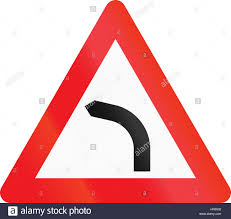

In [225]:
Image.open("/content/turn.png")

In [226]:
def image_preprocessing(test_image_path):
  img = cv2.imread(test_image_path)
  img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
  img = cv2.resize(img, (32,32)) 
  img = cv2.equalizeHist(img)
  img = img/255.0
  img_tensor = img.copy()
  img_tensor = img_tensor.reshape(1,img_tensor.shape[0],img_tensor.shape[1],1)
  print(img_tensor.shape)
  return img_tensor

In [235]:
def make_predictions(img_tensor):
  predictions = model.predict(img_tensor)
  classIndex = model.predict_classes(img_tensor)
  probabilityValue =np.amax(predictions)
  print(f'The Traffic signal in the images represents : {label_map[classIndex[0]]} { classIndex}')
  img = cv2.imread(test_image_path)
  text = label_map[classIndex[0]]
  cv2.rectangle(img,(80,0),(300,100),(255,0,0),2)
  cv2.putText(img,text, (120, 35), font, 0.35, (255, 0, 0), 1, cv2.LINE_AA)
  cv2.putText(img, str(round(probabilityValue*100,2) )+"%", (180, 75), font, 0.35, (255, 0, 0), 1, cv2.LINE_AA)
  cv2_imshow(img)
  cv2.waitKey(0)

(1, 32, 32, 1)
The Traffic signal in the images represents : Dangerous curve to the left [19]


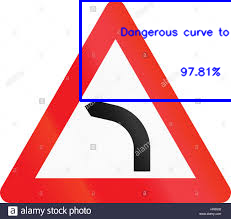

In [236]:
test_image_path = "/content/turn.png"
test_tensor =image_preprocessing(test_image_path)
make_predictions(test_tensor)

# WebCam Images

In [207]:
frameWidth= 640         # CAMERA RESOLUTION
frameHeight = 480
brightness = 180
threshold = 0.75         # PROBABLITY THRESHOLD
font = cv2.FONT_HERSHEY_SIMPLEX

# SETUP THE VIDEO CAMERA

In [276]:
cap = cv2.VideoCapture("/content/1057475374-preview.mp4")


In [277]:
from collections import deque
Q = deque(maxlen=32)
writer = None
(W, H) = (None, None)
display = 1

The Traffic signal in the images represents : Children crossing [28]
The Traffic signal in the images represents : Children crossing [28]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : No vechiles [15]
The Traffic signal in the images represents : Speed limit (50km/h) [2]
The Traffic signal in the images represents : Speed limit (120km/h) [8]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (120km/h) [8]
The Traffic signal in the images represents : Speed limit (120km/h) [8]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Sp

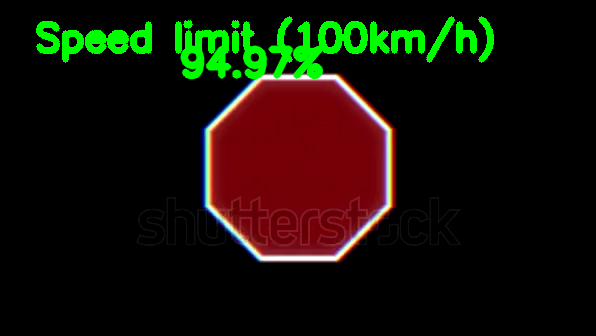

The Traffic signal in the images represents : Speed limit (100km/h) [7]


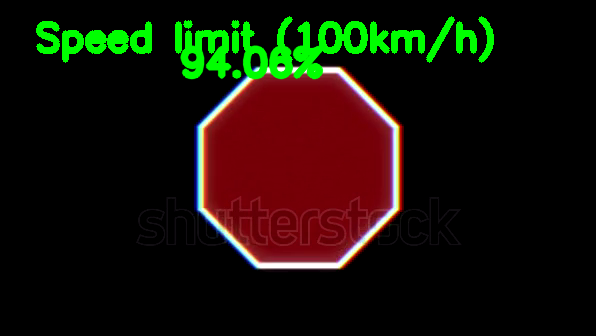

The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]


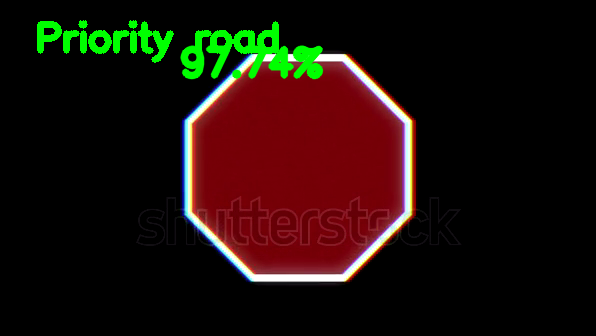

The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Speed limit (100km/h) [7]


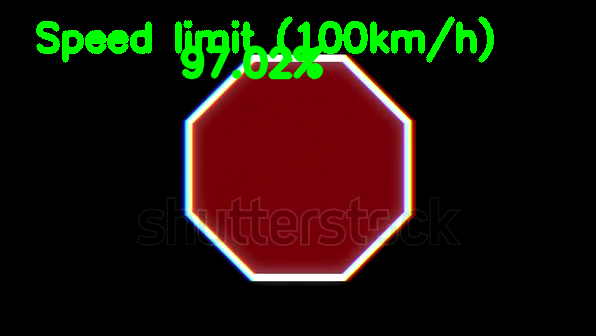

The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]


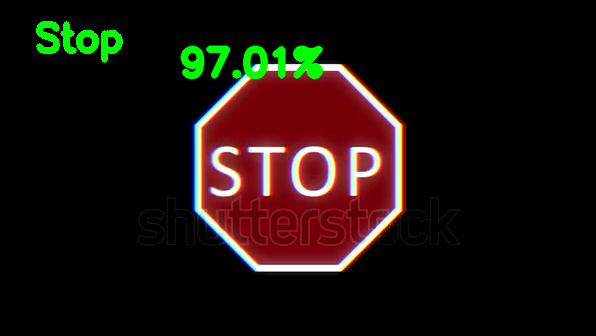

The Traffic signal in the images represents : Stop [14]


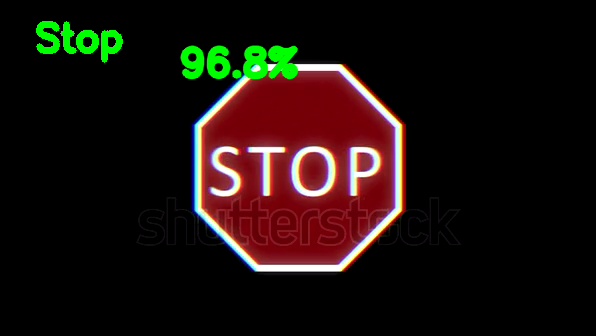

The Traffic signal in the images represents : Stop [14]


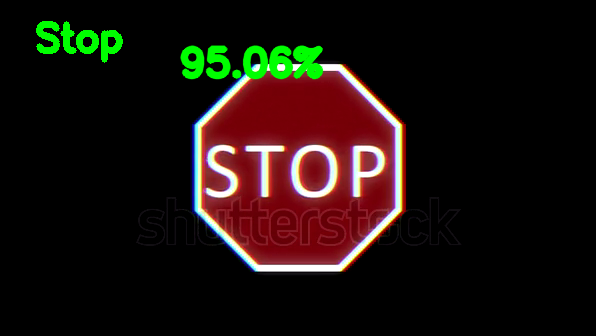

The Traffic signal in the images represents : Stop [14]


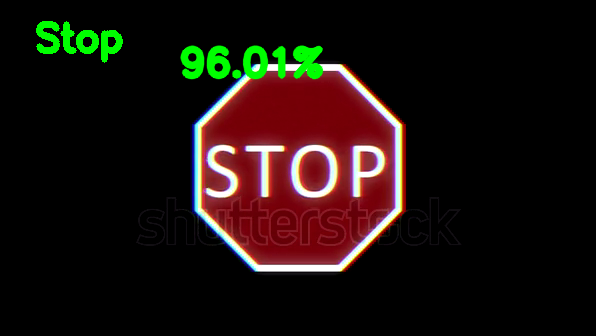

The Traffic signal in the images represents : Stop [14]


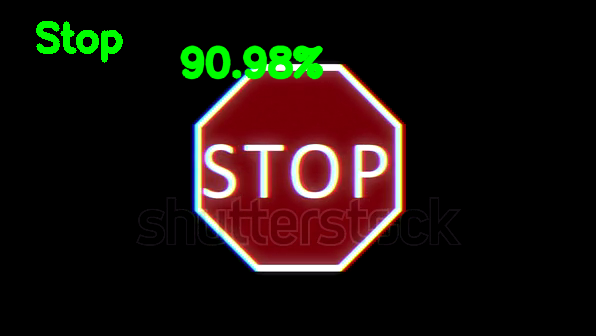

The Traffic signal in the images represents : Stop [14]


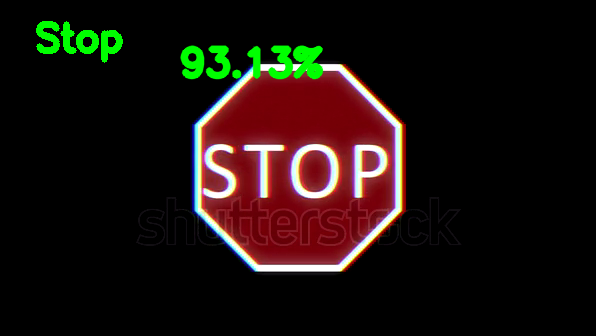

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]


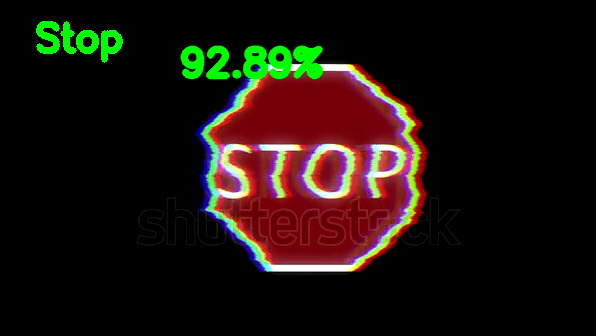

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]


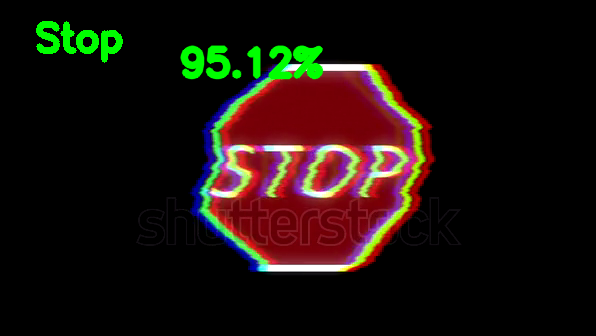

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Speed limit (80km/h) [5]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]


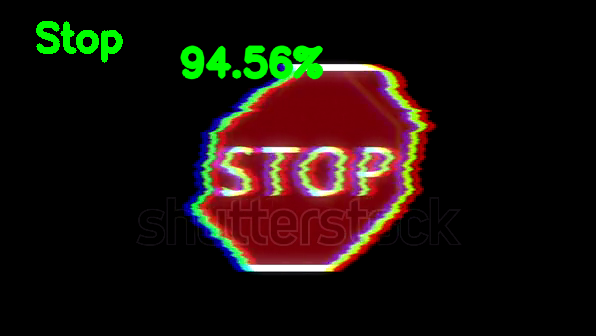

The Traffic signal in the images represents : Stop [14]


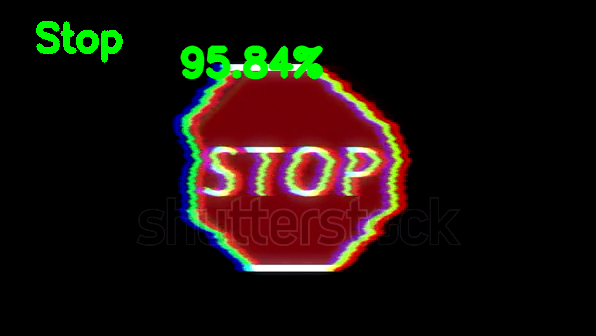

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]


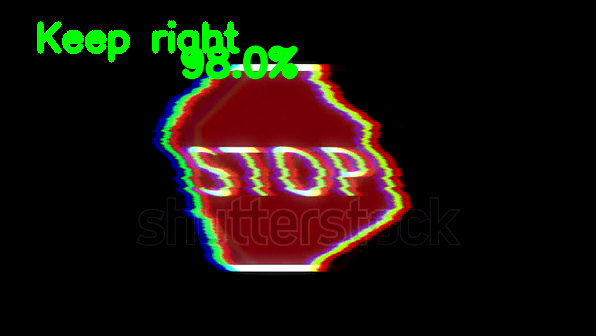

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : Stop [14]


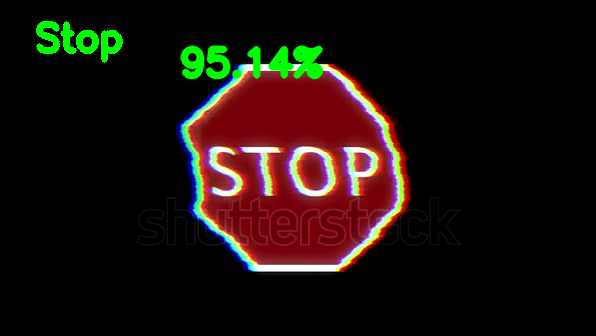

The Traffic signal in the images represents : Stop [14]


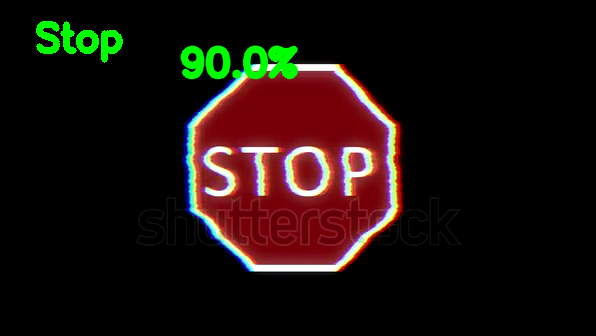

The Traffic signal in the images represents : Stop [14]


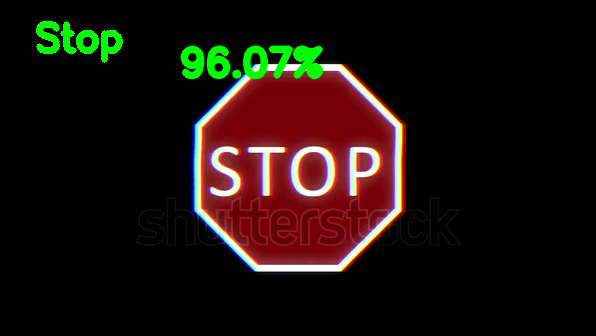

The Traffic signal in the images represents : Stop [14]


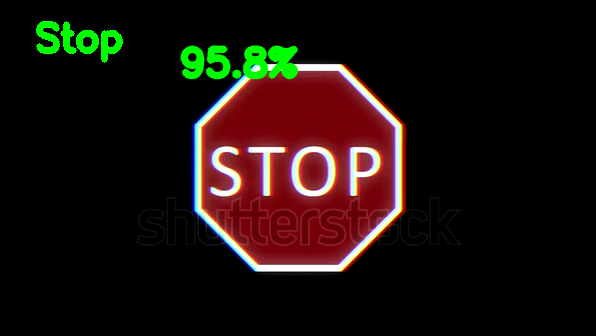

The Traffic signal in the images represents : Stop [14]


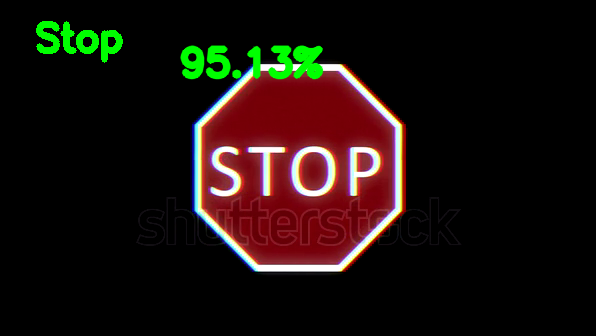

The Traffic signal in the images represents : Stop [14]


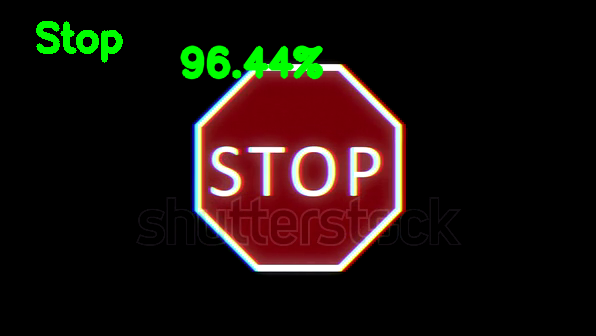

The Traffic signal in the images represents : Stop [14]


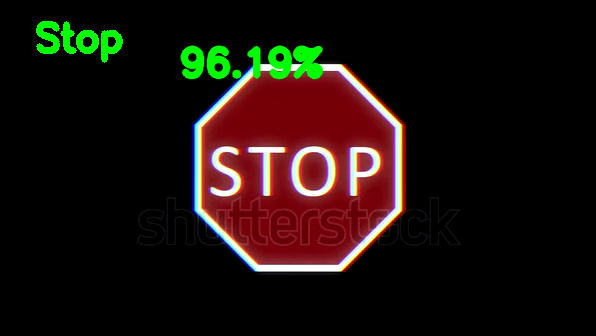

The Traffic signal in the images represents : Stop [14]


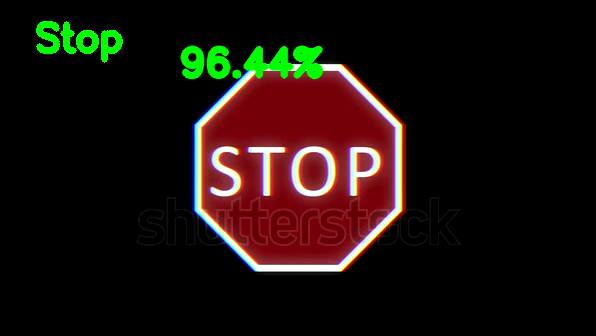

The Traffic signal in the images represents : Stop [14]


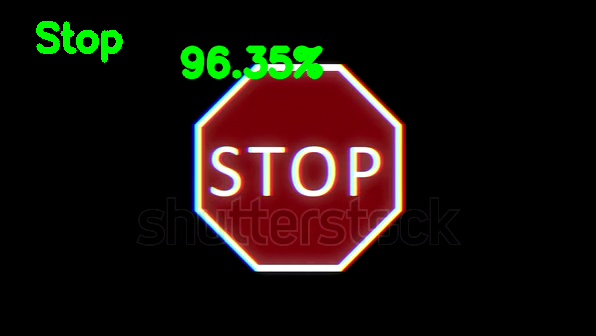

The Traffic signal in the images represents : Stop [14]


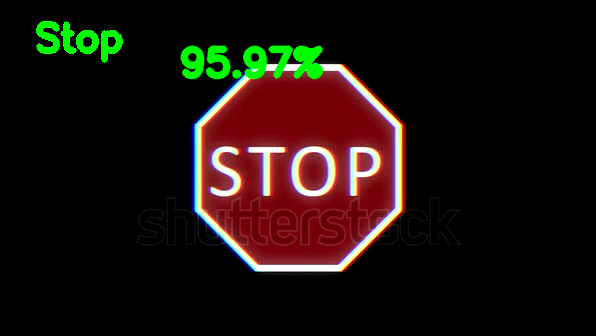

The Traffic signal in the images represents : Stop [14]


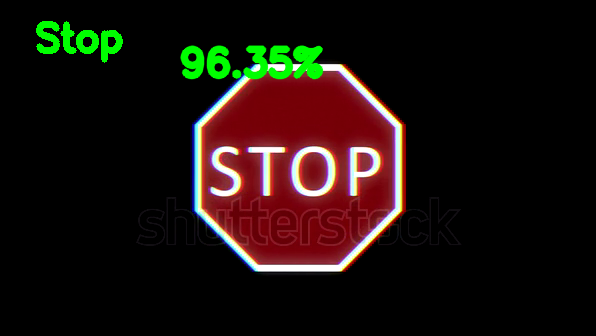

The Traffic signal in the images represents : Stop [14]


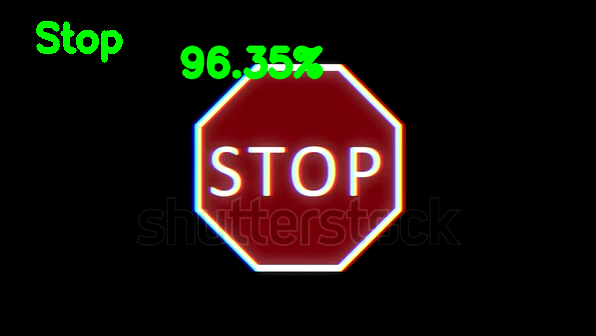

The Traffic signal in the images represents : Stop [14]


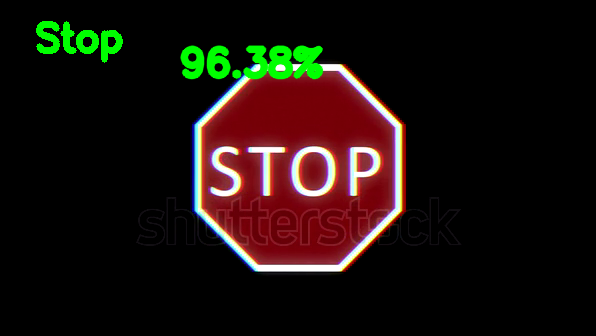

The Traffic signal in the images represents : Stop [14]


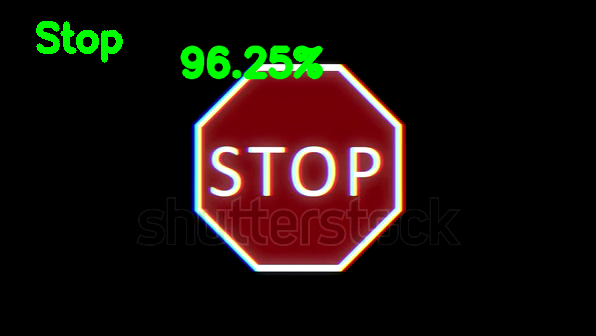

The Traffic signal in the images represents : Stop [14]


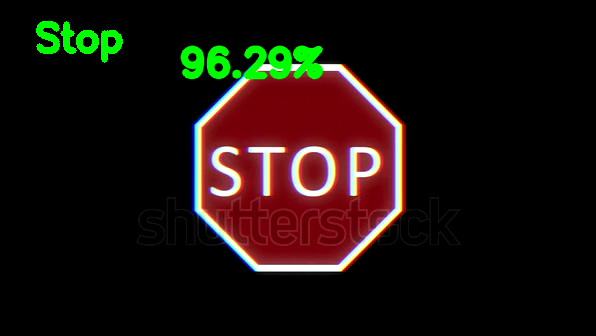

The Traffic signal in the images represents : Stop [14]


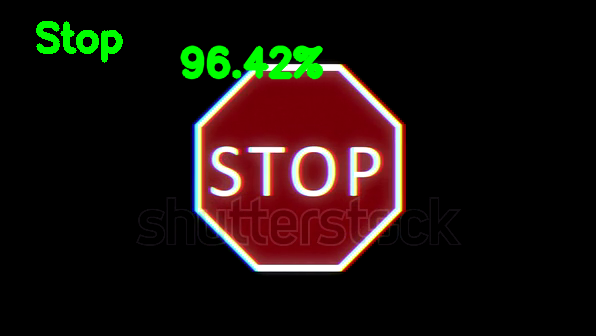

The Traffic signal in the images represents : Stop [14]


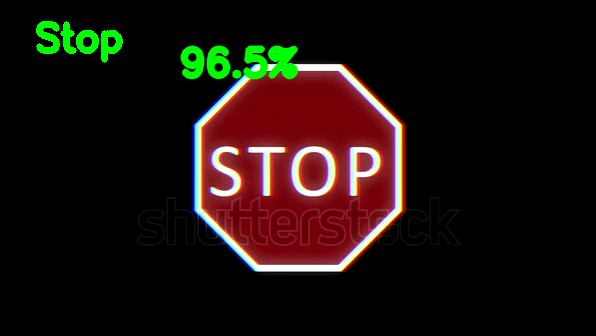

The Traffic signal in the images represents : Stop [14]


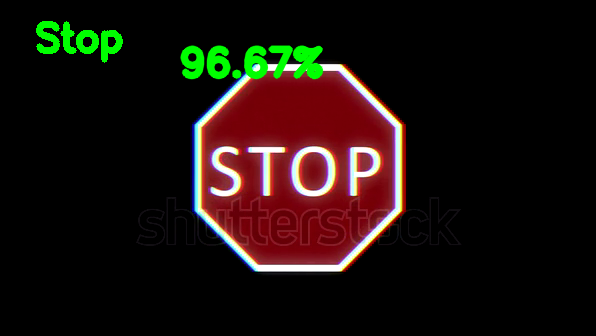

The Traffic signal in the images represents : Stop [14]


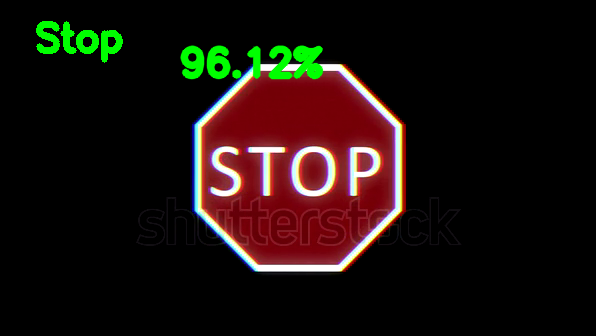

The Traffic signal in the images represents : Stop [14]


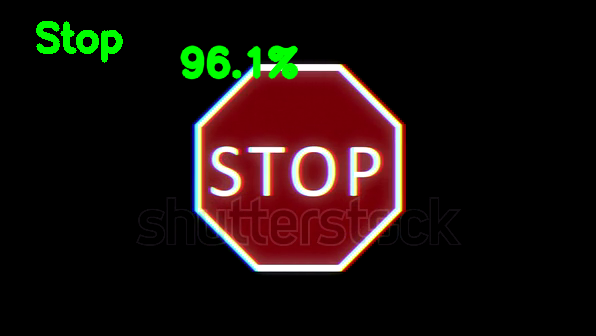

The Traffic signal in the images represents : Stop [14]


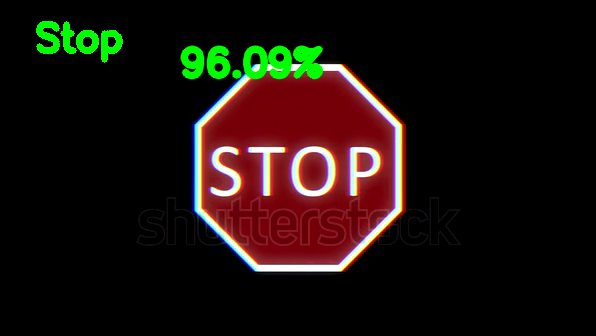

The Traffic signal in the images represents : Stop [14]


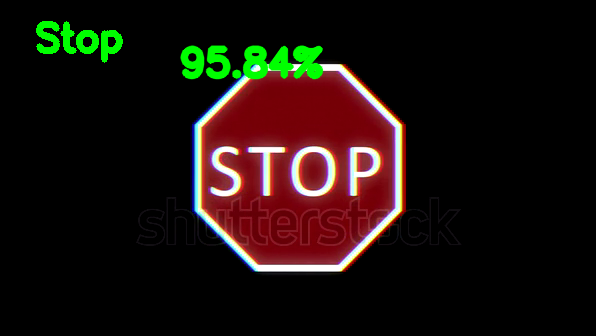

The Traffic signal in the images represents : Stop [14]


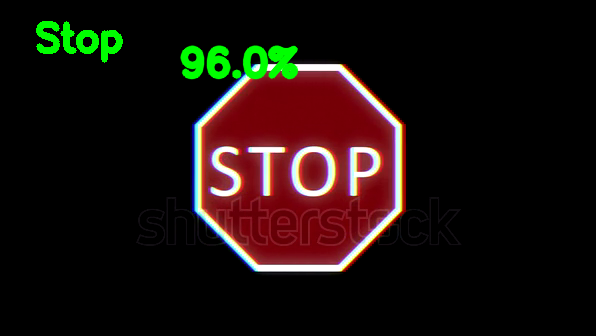

The Traffic signal in the images represents : Stop [14]


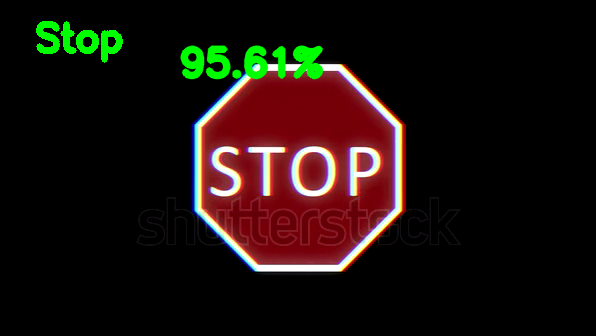

The Traffic signal in the images represents : Stop [14]


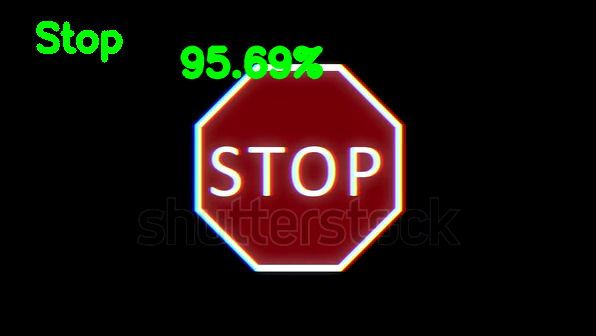

The Traffic signal in the images represents : Stop [14]


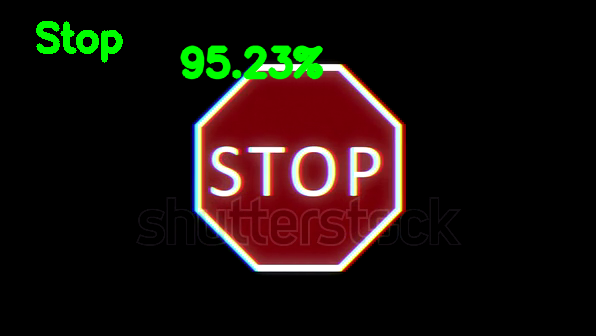

The Traffic signal in the images represents : Stop [14]


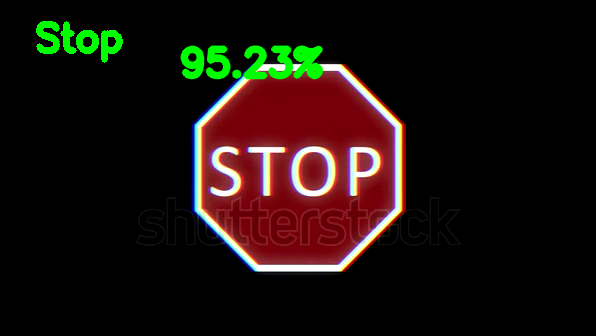

The Traffic signal in the images represents : Stop [14]


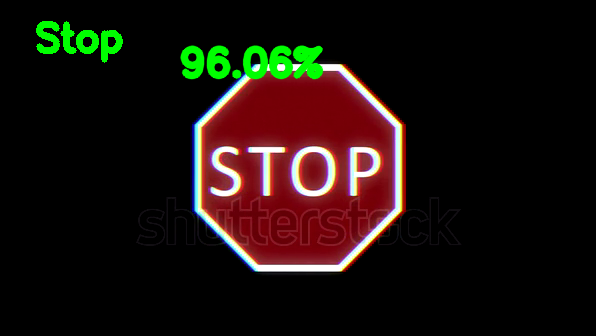

The Traffic signal in the images represents : Stop [14]


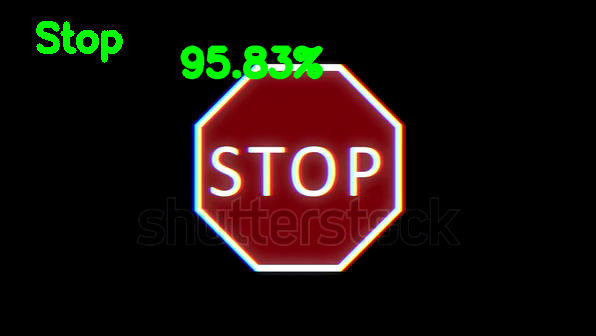

The Traffic signal in the images represents : Stop [14]


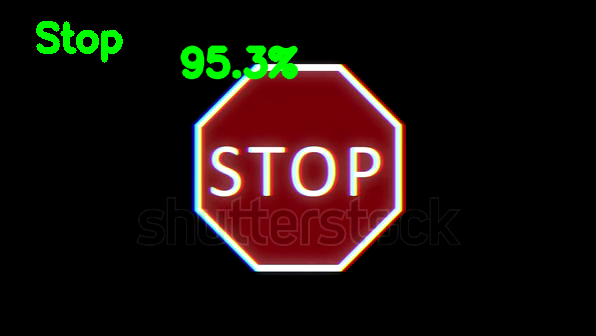

The Traffic signal in the images represents : Stop [14]


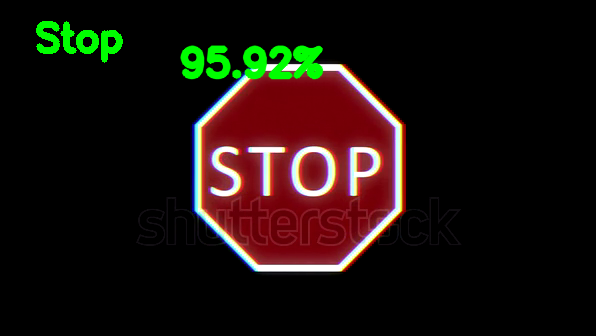

The Traffic signal in the images represents : Stop [14]


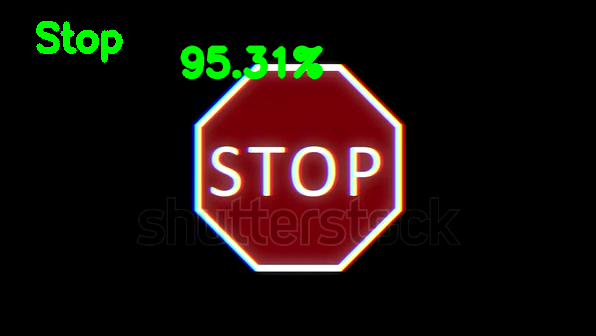

The Traffic signal in the images represents : Stop [14]


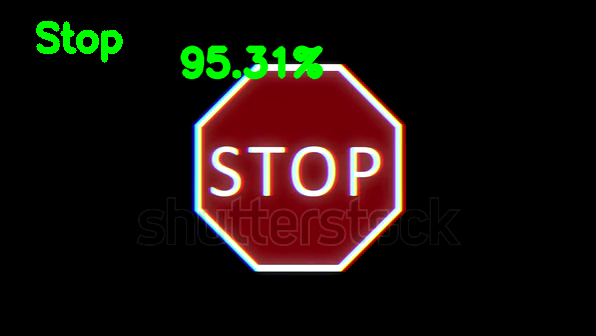

The Traffic signal in the images represents : Stop [14]


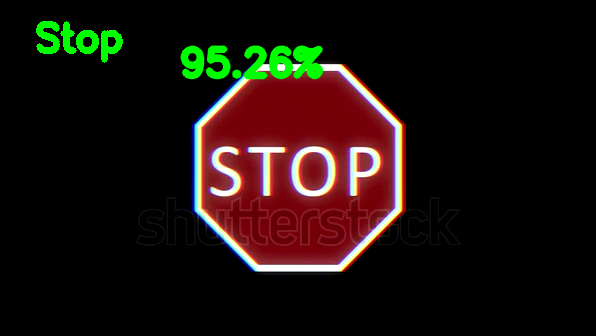

The Traffic signal in the images represents : Stop [14]


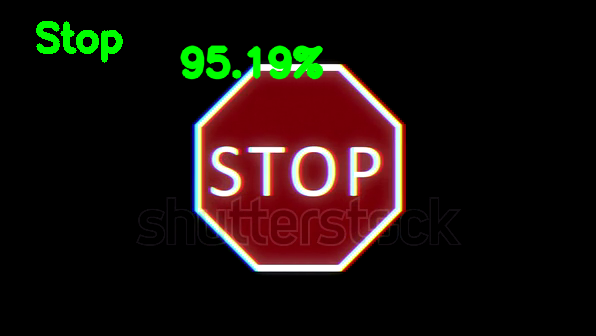

The Traffic signal in the images represents : Stop [14]


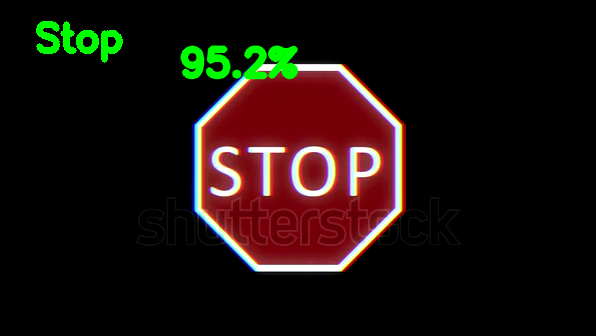

The Traffic signal in the images represents : Stop [14]


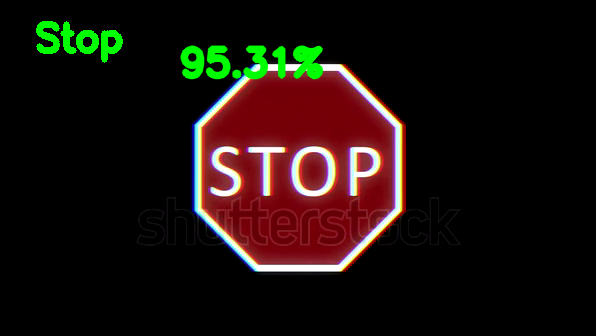

The Traffic signal in the images represents : Stop [14]


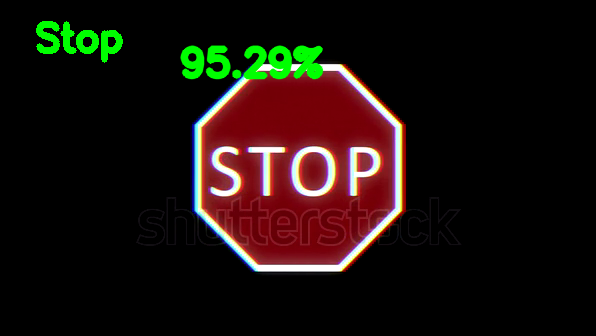

The Traffic signal in the images represents : Stop [14]


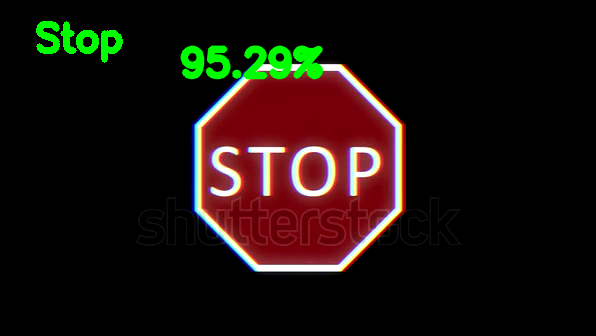

The Traffic signal in the images represents : Stop [14]


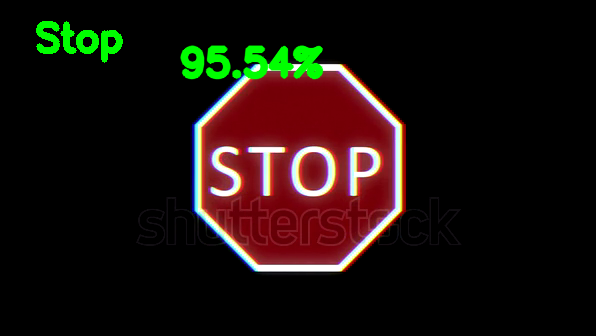

The Traffic signal in the images represents : Stop [14]


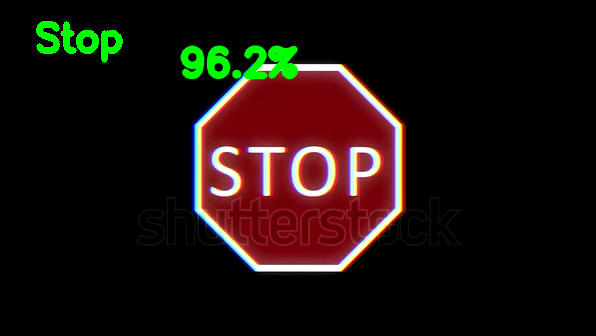

The Traffic signal in the images represents : Stop [14]


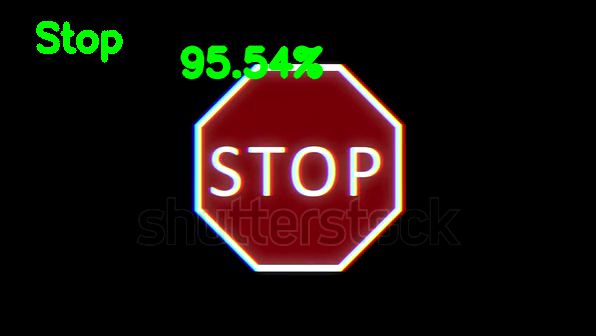

The Traffic signal in the images represents : Stop [14]


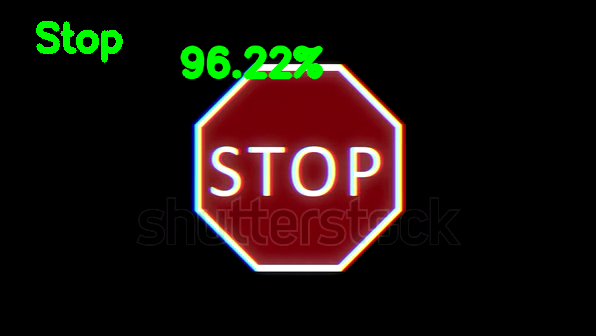

The Traffic signal in the images represents : Stop [14]


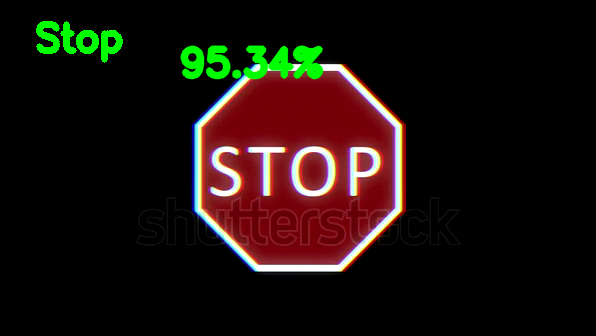

The Traffic signal in the images represents : Stop [14]


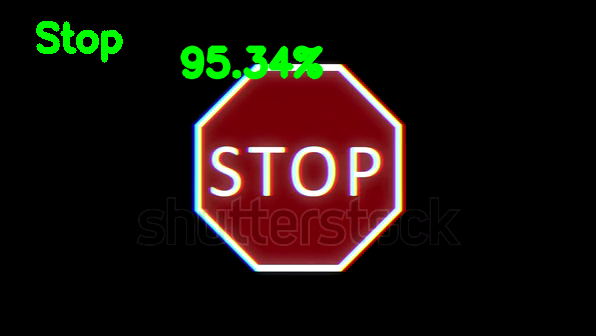

The Traffic signal in the images represents : Stop [14]


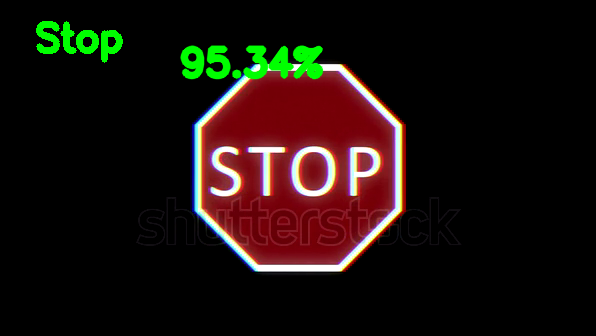

The Traffic signal in the images represents : Stop [14]


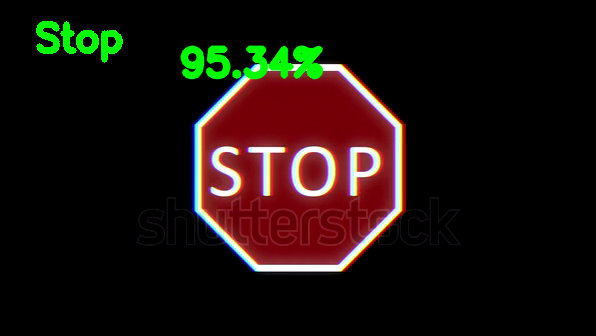

The Traffic signal in the images represents : Stop [14]


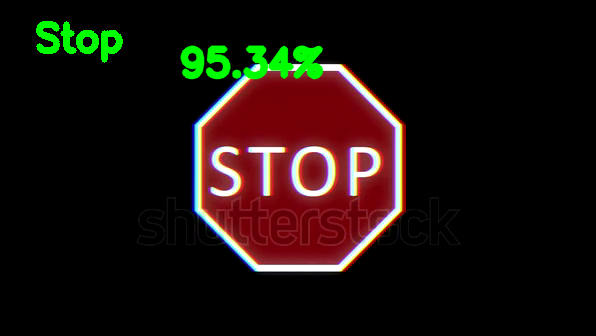

The Traffic signal in the images represents : Stop [14]


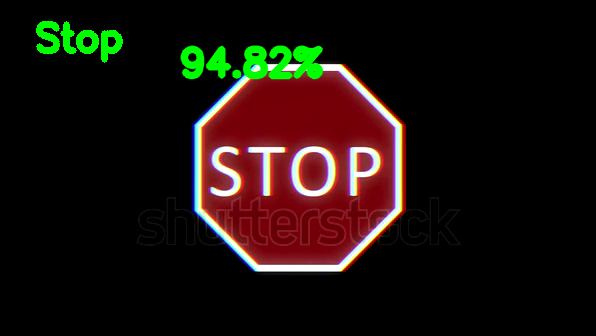

The Traffic signal in the images represents : Stop [14]


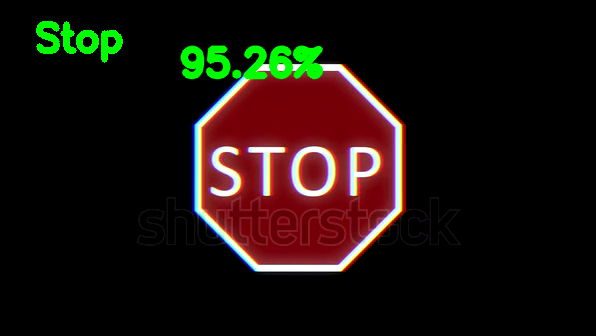

The Traffic signal in the images represents : Stop [14]


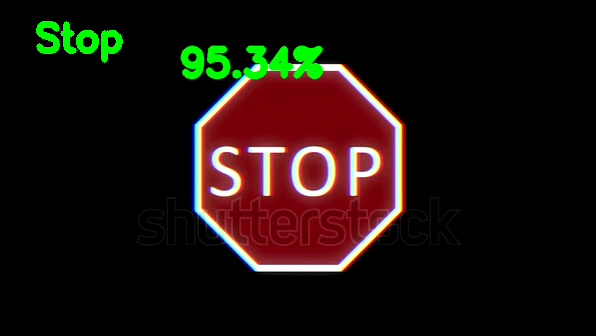

The Traffic signal in the images represents : Stop [14]


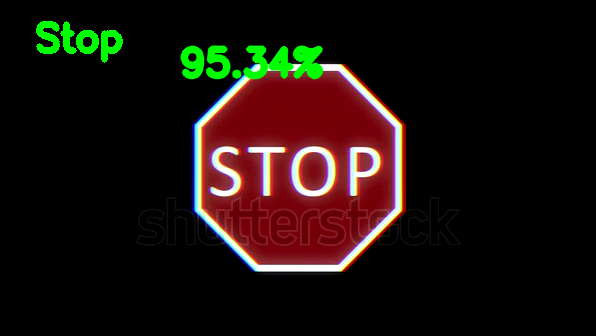

The Traffic signal in the images represents : Stop [14]


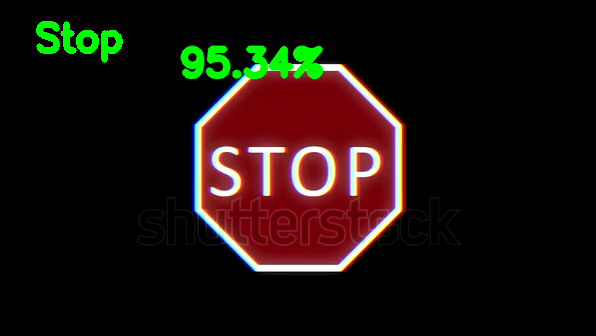

The Traffic signal in the images represents : Stop [14]


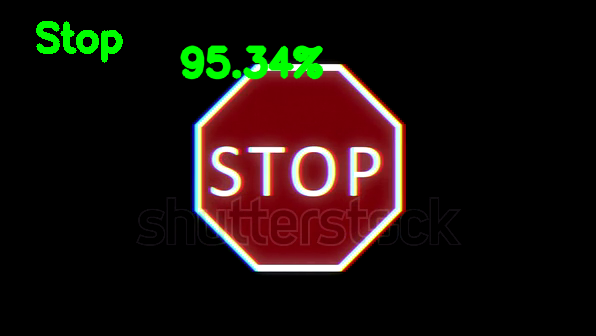

The Traffic signal in the images represents : Stop [14]


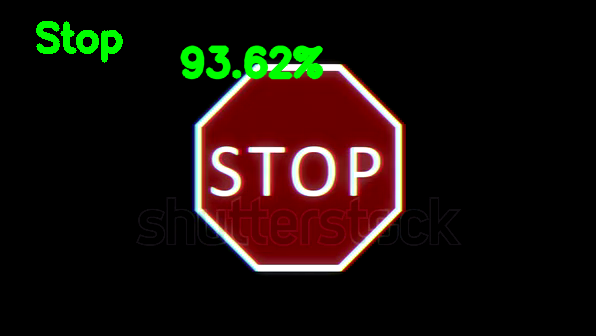

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]


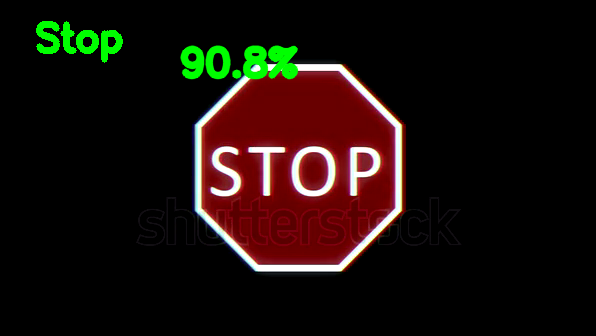

The Traffic signal in the images represents : Stop [14]


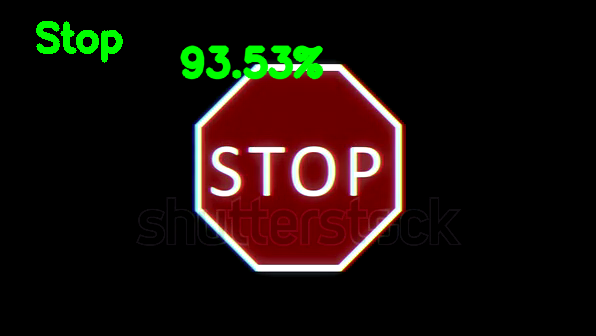

The Traffic signal in the images represents : Stop [14]


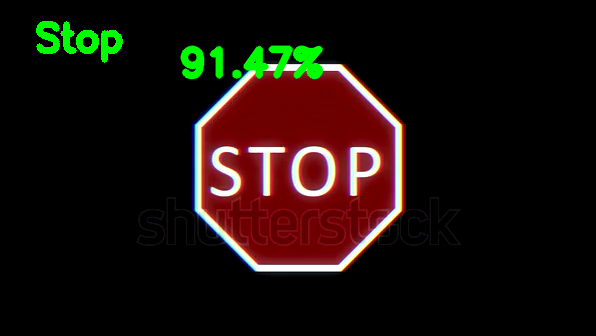

The Traffic signal in the images represents : Stop [14]


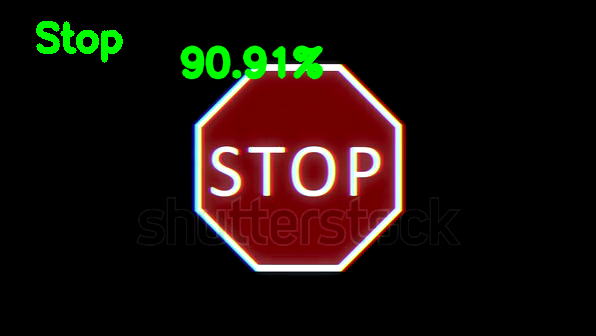

The Traffic signal in the images represents : Stop [14]


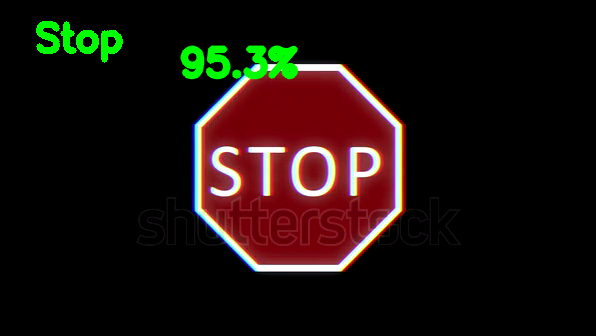

The Traffic signal in the images represents : Stop [14]


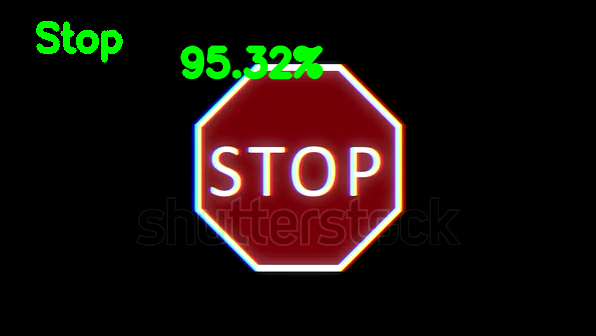

The Traffic signal in the images represents : Stop [14]


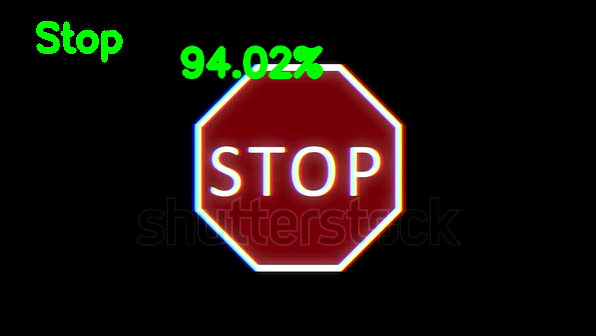

The Traffic signal in the images represents : Stop [14]


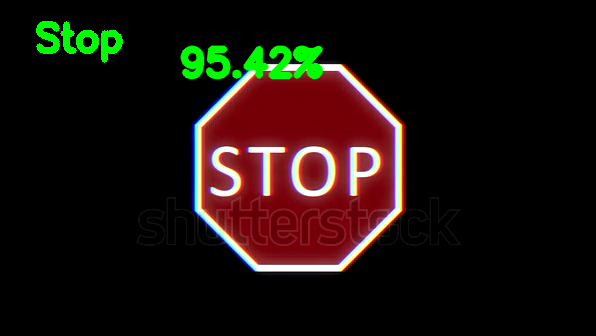

The Traffic signal in the images represents : Stop [14]


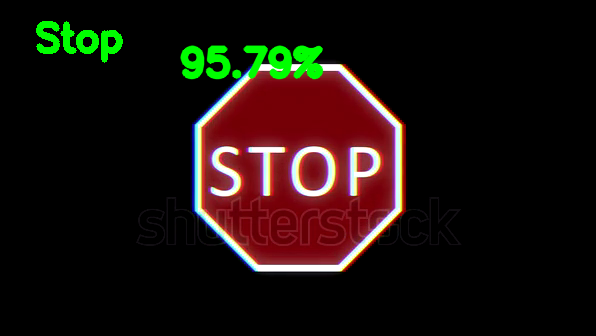

The Traffic signal in the images represents : Stop [14]


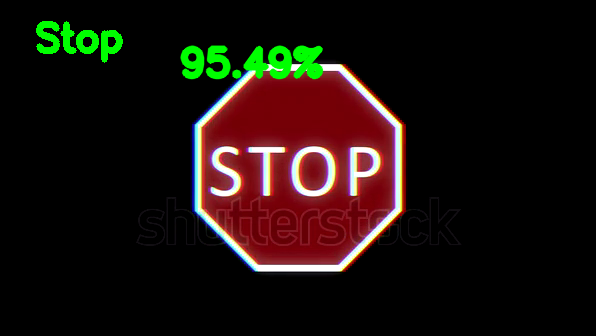

The Traffic signal in the images represents : Stop [14]


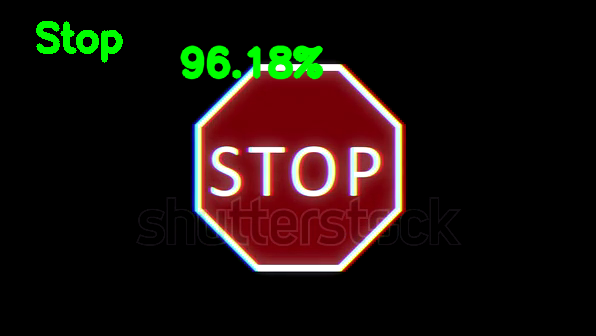

The Traffic signal in the images represents : Stop [14]


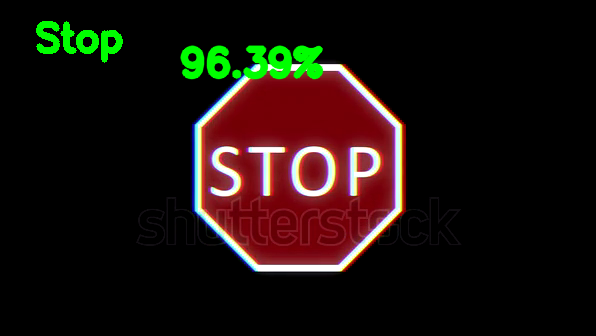

The Traffic signal in the images represents : Stop [14]


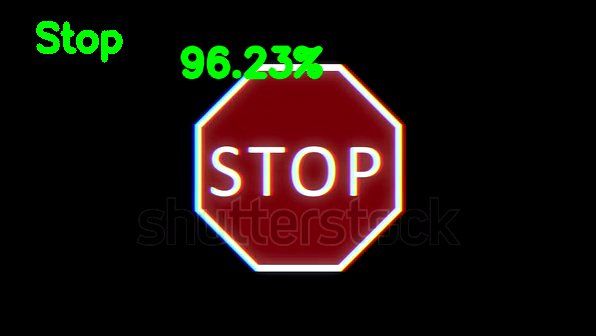

The Traffic signal in the images represents : Stop [14]


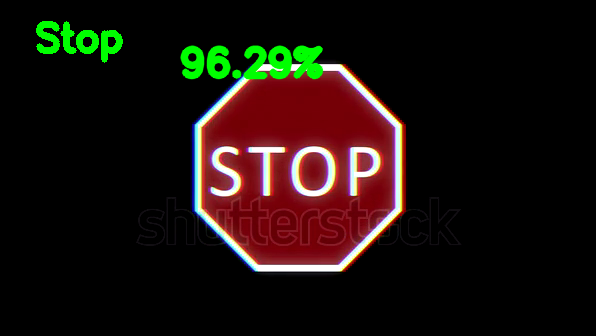

The Traffic signal in the images represents : Stop [14]


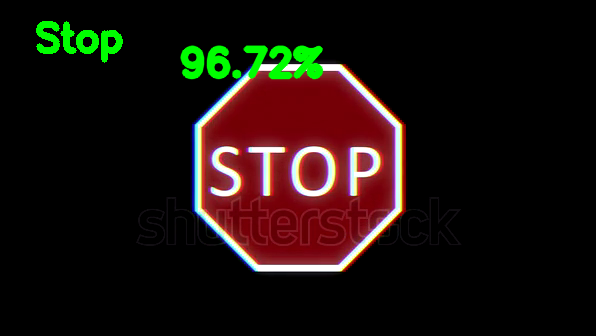

The Traffic signal in the images represents : Stop [14]


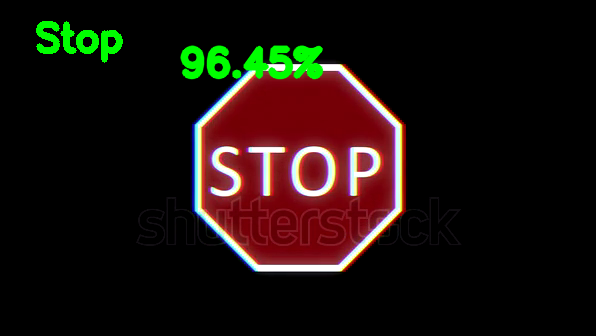

The Traffic signal in the images represents : Stop [14]


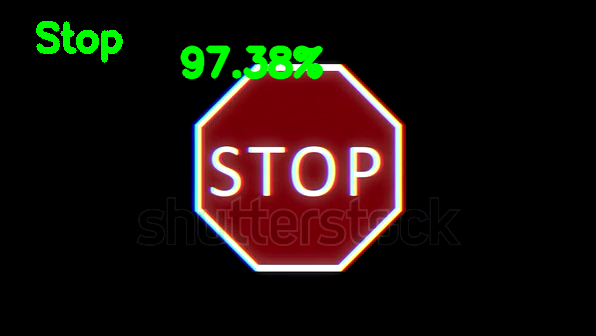

The Traffic signal in the images represents : Stop [14]


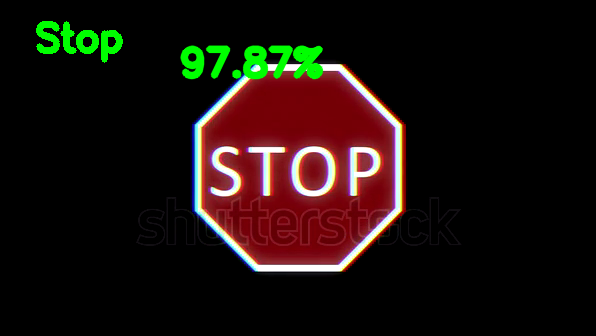

The Traffic signal in the images represents : Stop [14]


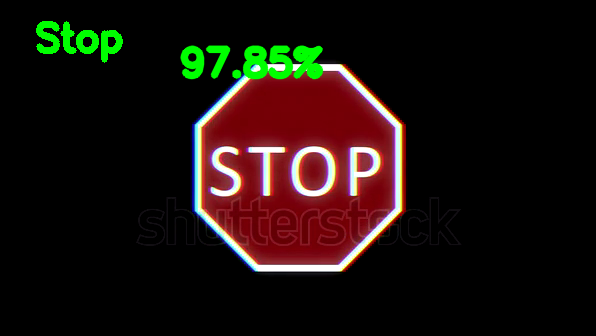

The Traffic signal in the images represents : Stop [14]


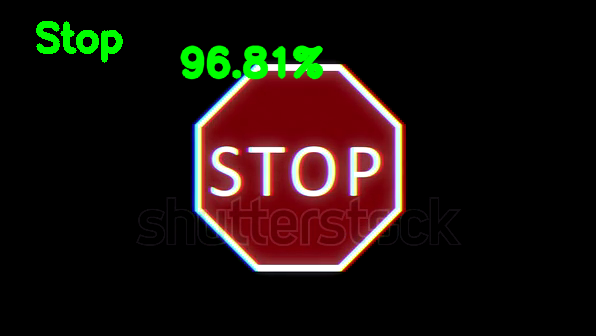

The Traffic signal in the images represents : Stop [14]


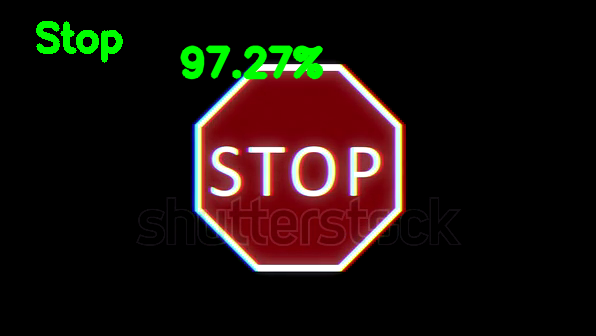

The Traffic signal in the images represents : Stop [14]


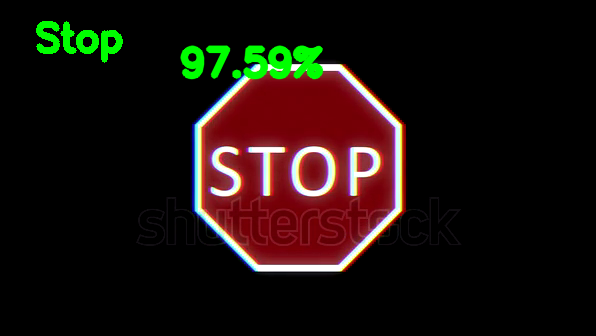

The Traffic signal in the images represents : Stop [14]


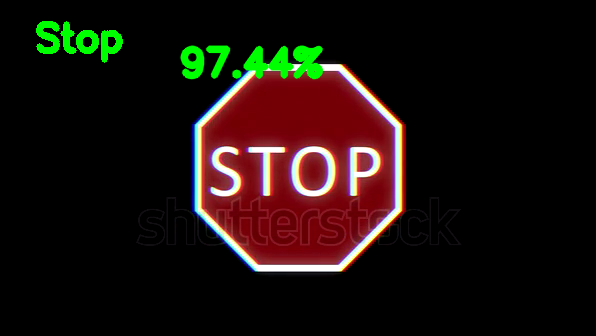

The Traffic signal in the images represents : Stop [14]


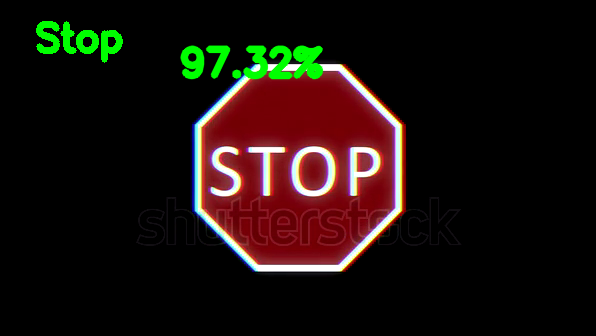

The Traffic signal in the images represents : Stop [14]


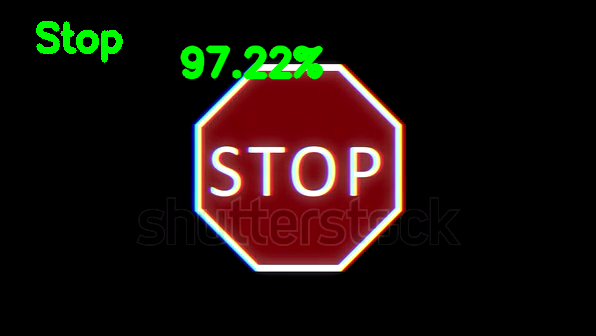

The Traffic signal in the images represents : Stop [14]


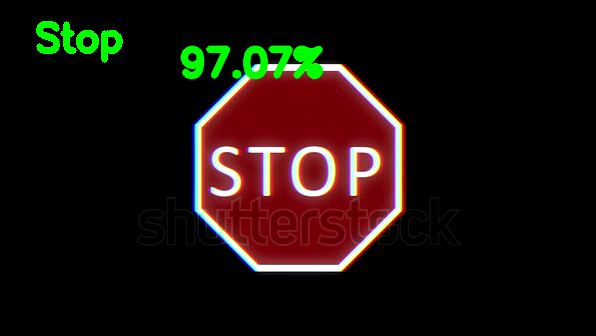

The Traffic signal in the images represents : Stop [14]


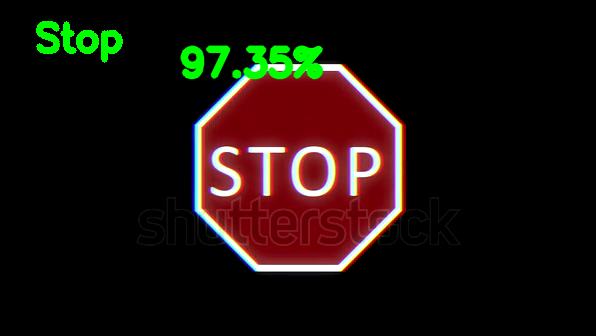

The Traffic signal in the images represents : Stop [14]


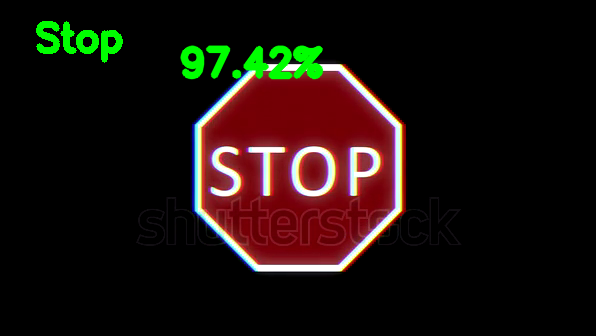

The Traffic signal in the images represents : Stop [14]


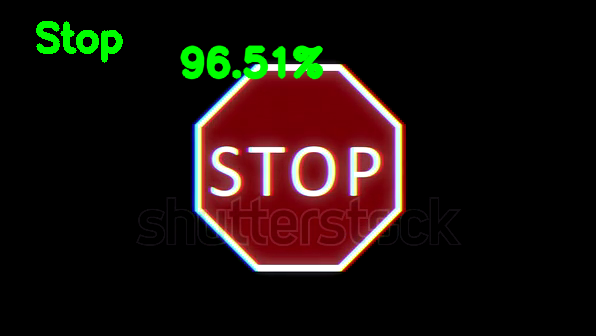

The Traffic signal in the images represents : Stop [14]


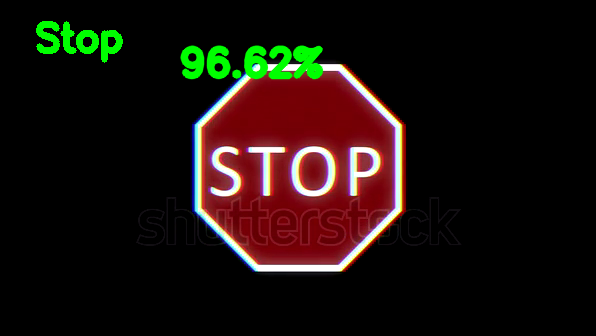

The Traffic signal in the images represents : Stop [14]


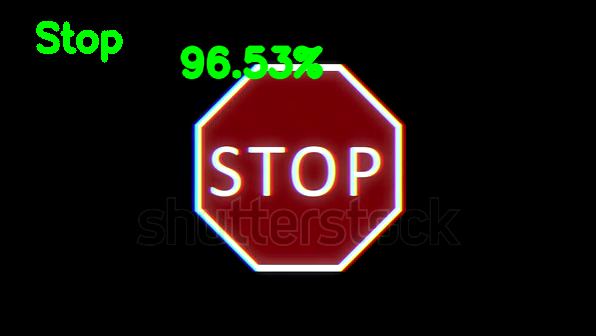

The Traffic signal in the images represents : Stop [14]


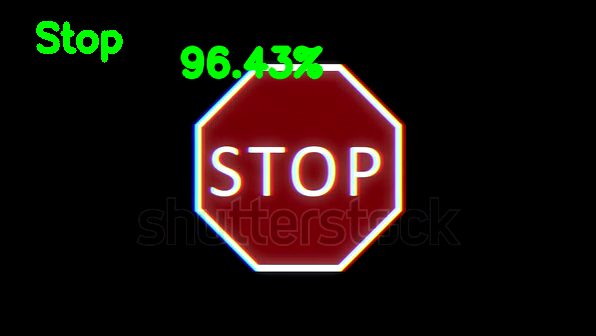

The Traffic signal in the images represents : Stop [14]


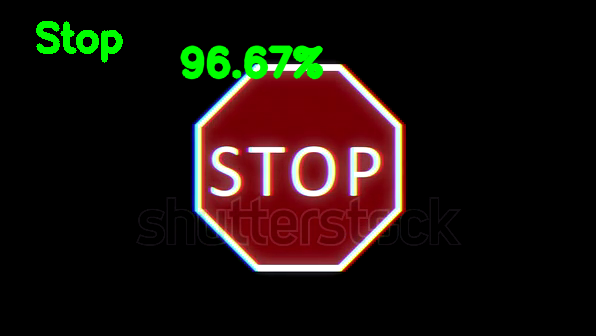

The Traffic signal in the images represents : Stop [14]


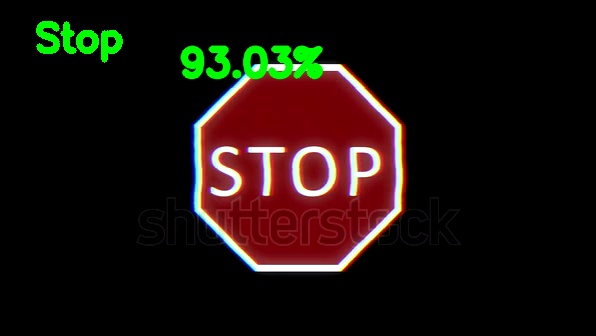

The Traffic signal in the images represents : Stop [14]


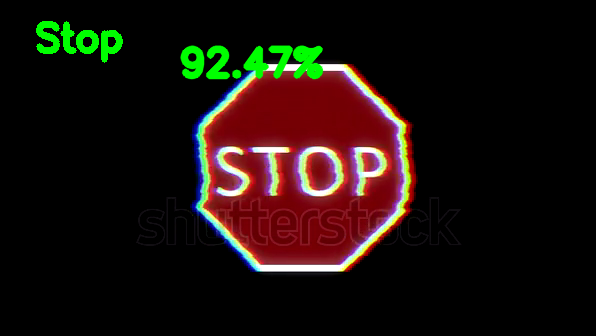

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]


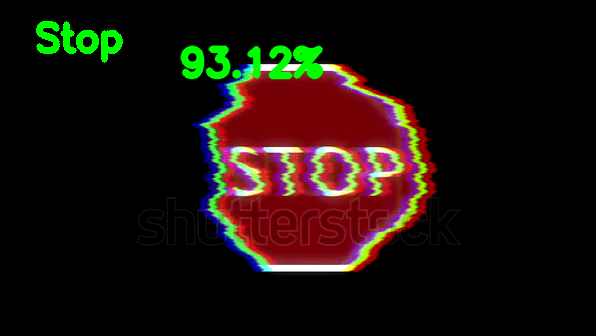

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]


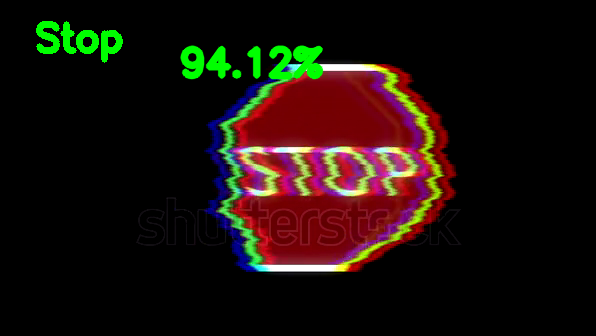

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]


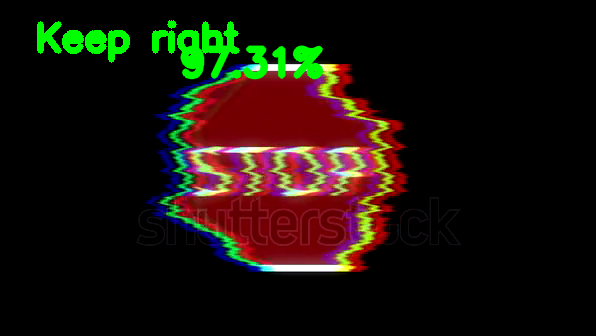

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No passing for vechiles over 3.5 metric tons [10]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Speed limit (50km/h) [2]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : Stop [14]


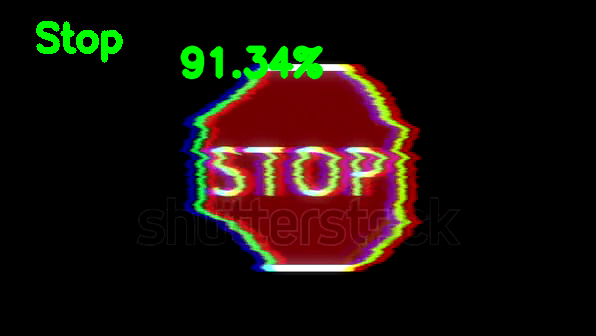

The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Yield [13]


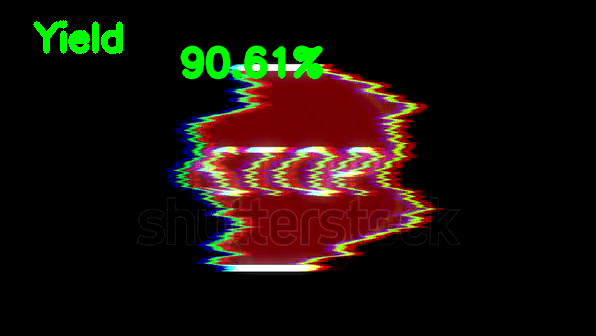

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : Stop [14]


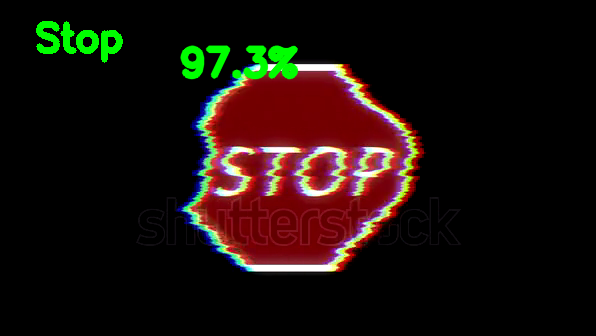

The Traffic signal in the images represents : Stop [14]


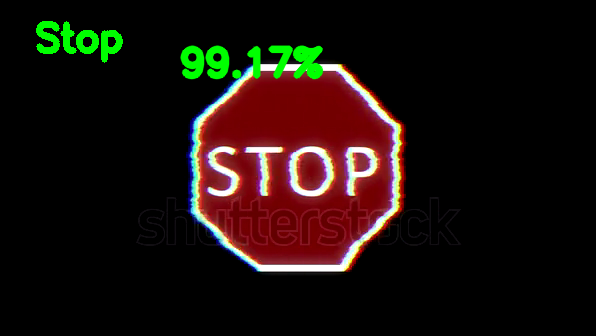

The Traffic signal in the images represents : Stop [14]


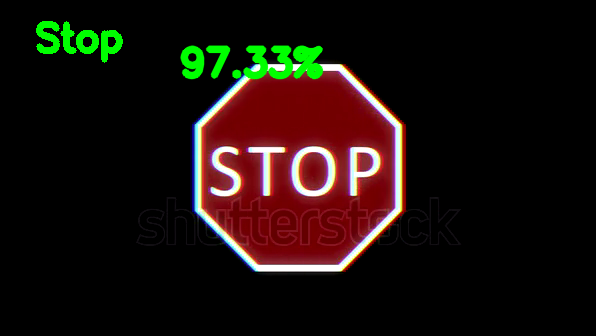

The Traffic signal in the images represents : Stop [14]


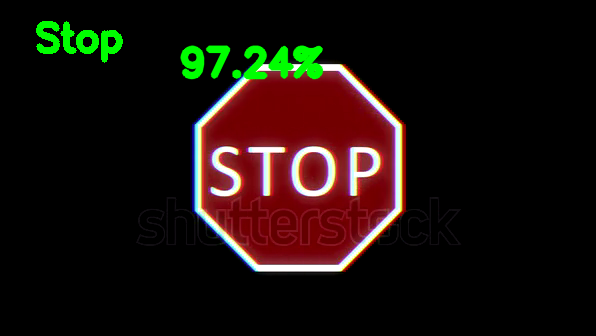

The Traffic signal in the images represents : Stop [14]


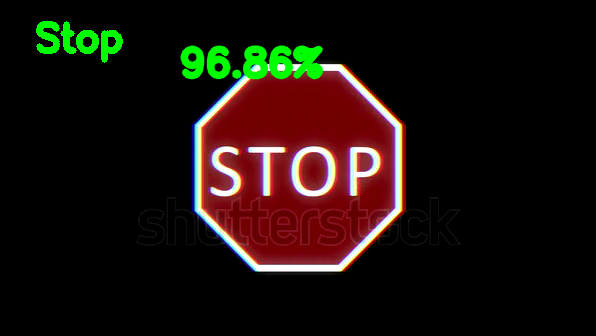

The Traffic signal in the images represents : Stop [14]


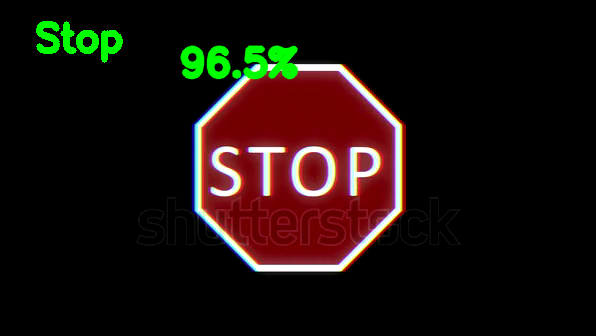

The Traffic signal in the images represents : Stop [14]


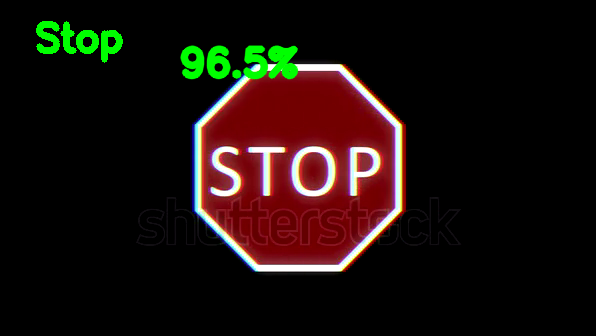

The Traffic signal in the images represents : Stop [14]


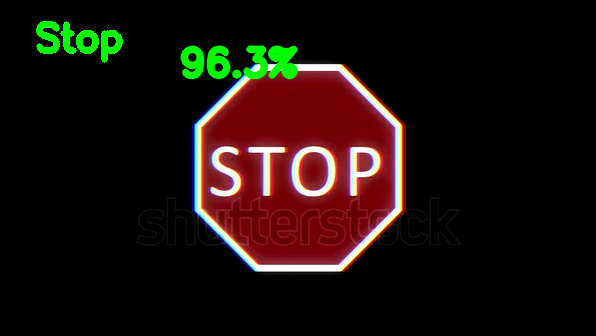

The Traffic signal in the images represents : Stop [14]


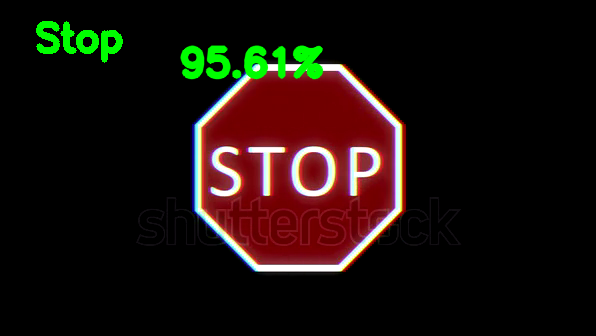

The Traffic signal in the images represents : Stop [14]


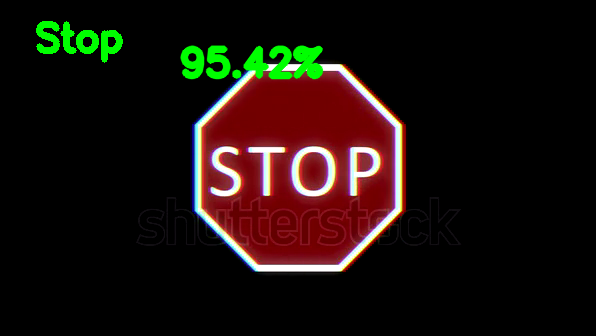

The Traffic signal in the images represents : Stop [14]


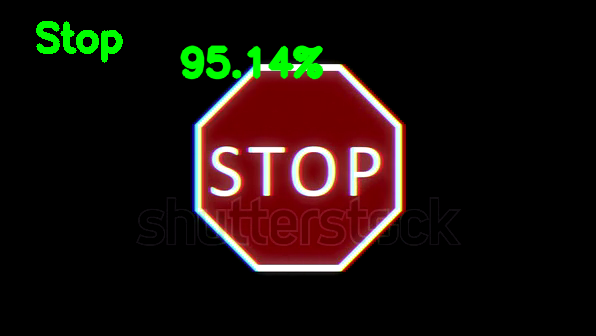

The Traffic signal in the images represents : Stop [14]


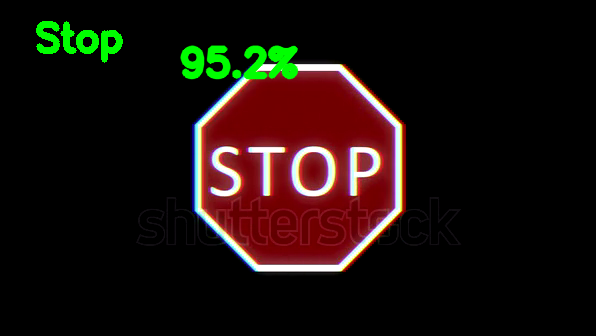

The Traffic signal in the images represents : Stop [14]


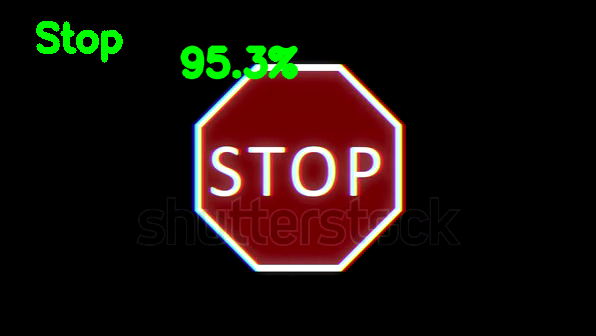

The Traffic signal in the images represents : Stop [14]


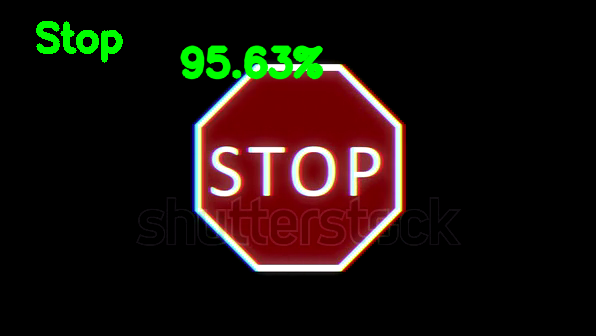

The Traffic signal in the images represents : Stop [14]


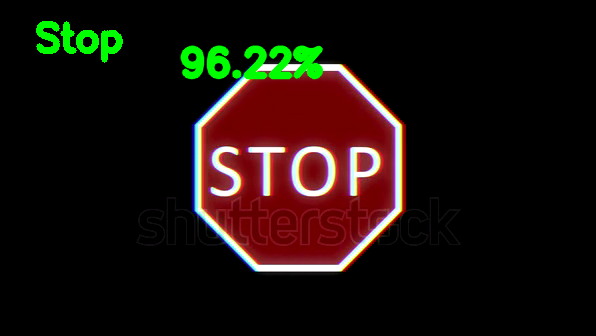

The Traffic signal in the images represents : Stop [14]


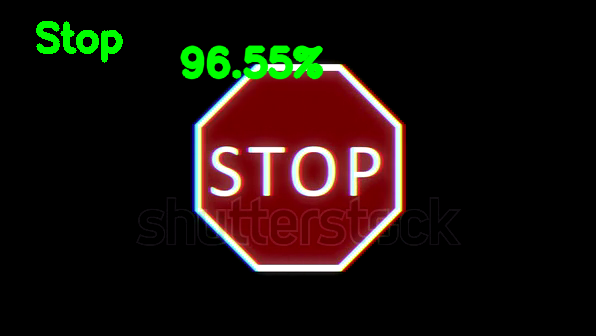

The Traffic signal in the images represents : Stop [14]


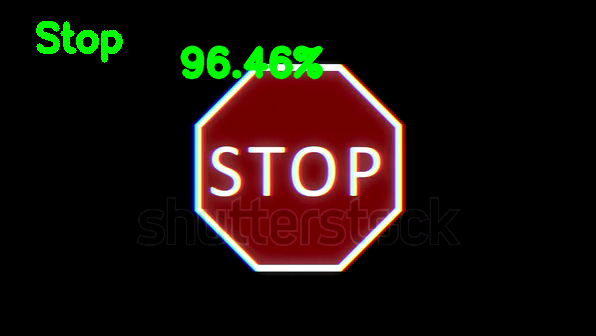

The Traffic signal in the images represents : Stop [14]


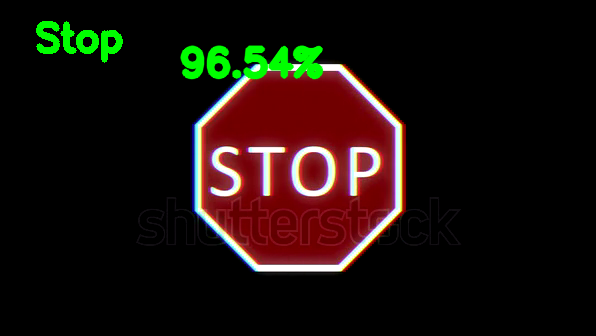

The Traffic signal in the images represents : Stop [14]


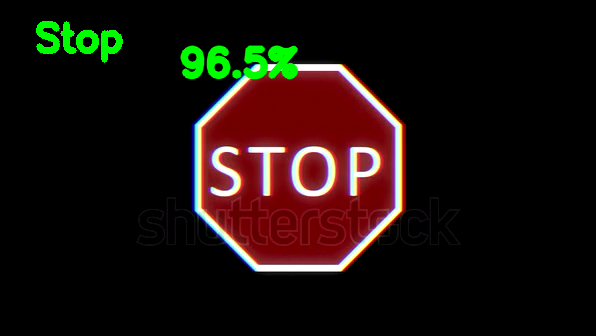

The Traffic signal in the images represents : Stop [14]


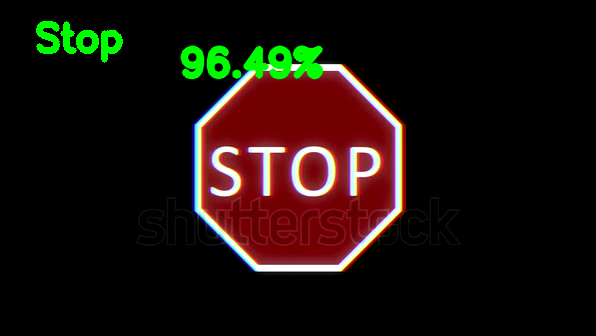

The Traffic signal in the images represents : Stop [14]


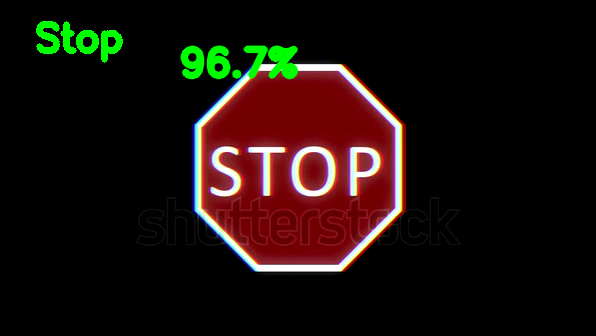

The Traffic signal in the images represents : Stop [14]


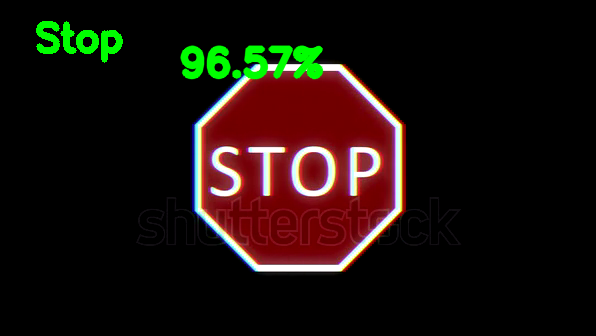

The Traffic signal in the images represents : Stop [14]


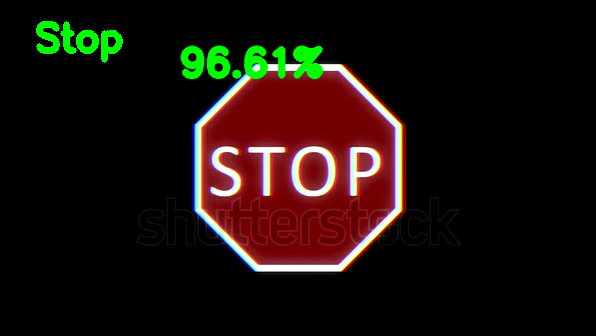

The Traffic signal in the images represents : Stop [14]


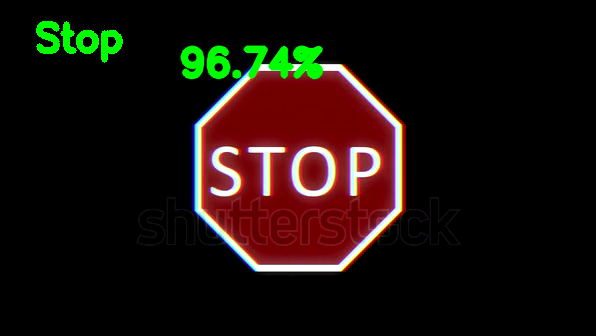

The Traffic signal in the images represents : Stop [14]


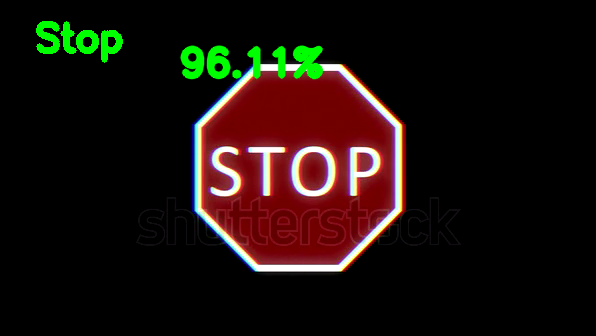

The Traffic signal in the images represents : Stop [14]


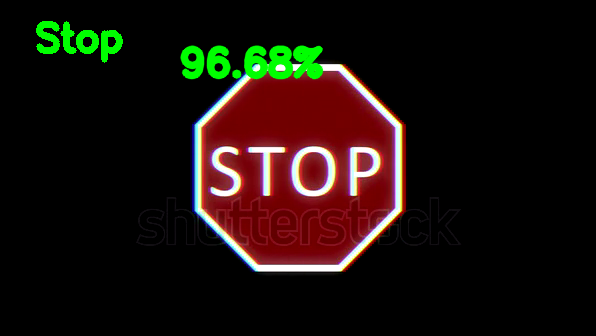

The Traffic signal in the images represents : Stop [14]


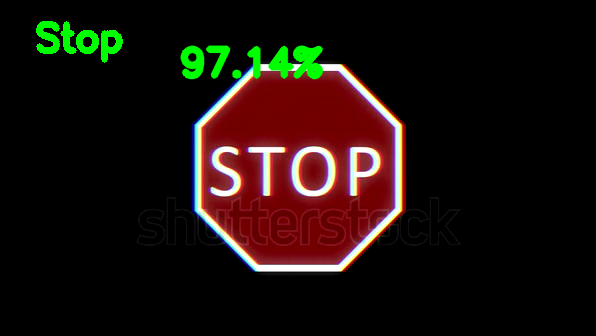

The Traffic signal in the images represents : Stop [14]


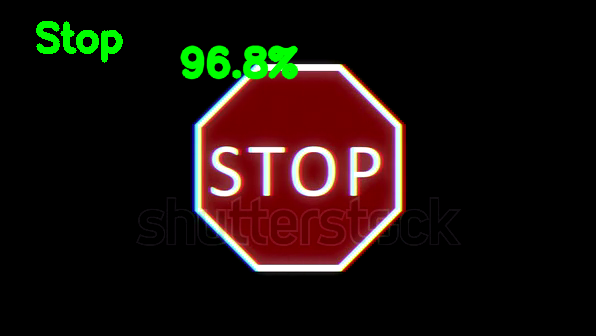

The Traffic signal in the images represents : Stop [14]


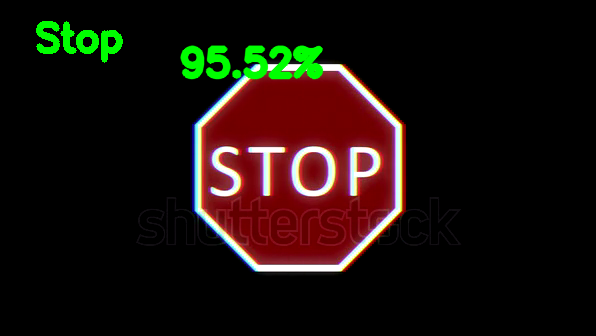

The Traffic signal in the images represents : Stop [14]


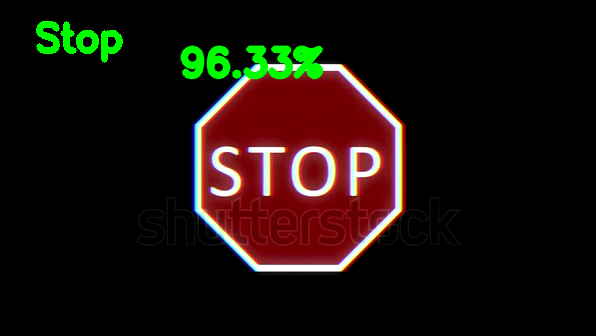

The Traffic signal in the images represents : Stop [14]


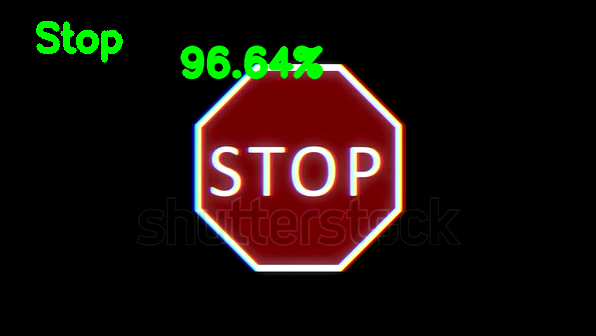

The Traffic signal in the images represents : Stop [14]


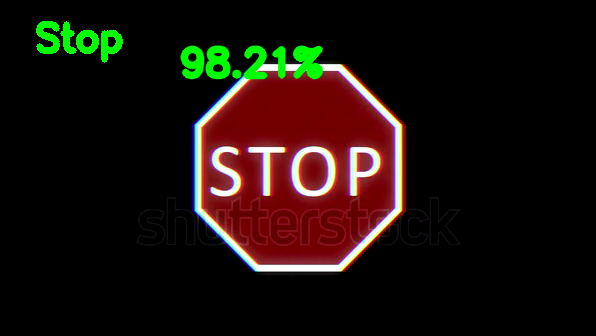

The Traffic signal in the images represents : Stop [14]


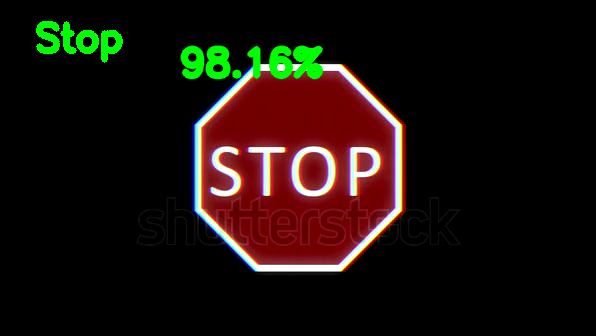

The Traffic signal in the images represents : Stop [14]


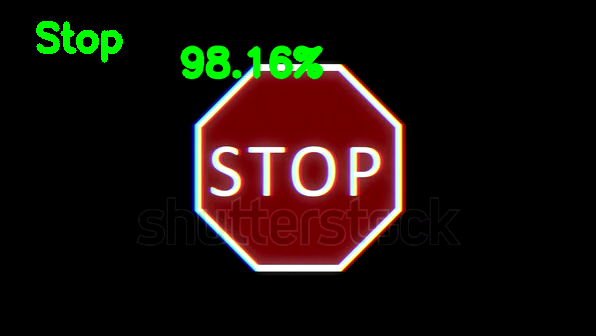

The Traffic signal in the images represents : Stop [14]


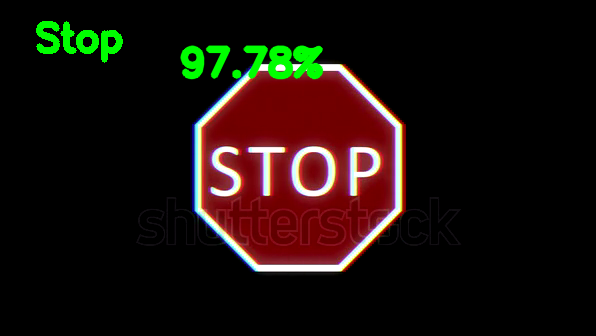

The Traffic signal in the images represents : Stop [14]


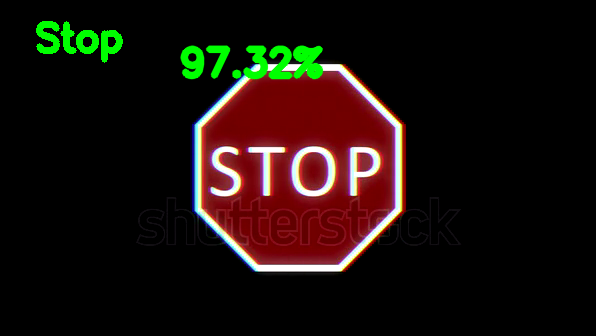

The Traffic signal in the images represents : Stop [14]


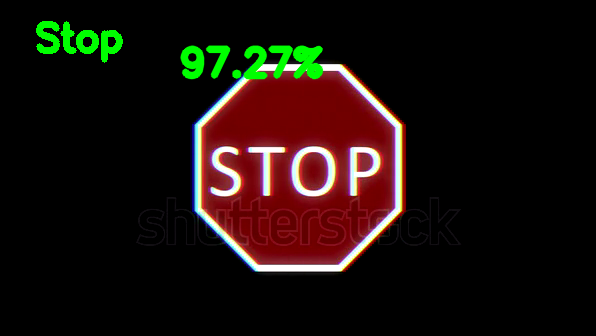

The Traffic signal in the images represents : Stop [14]


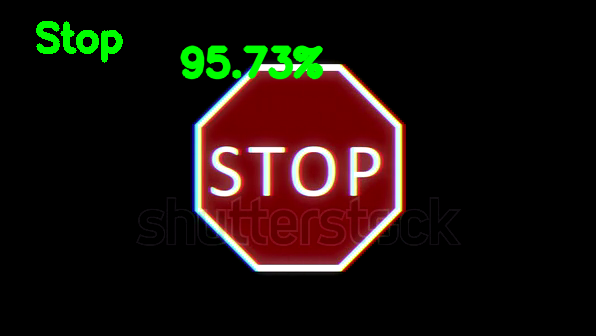

The Traffic signal in the images represents : Stop [14]


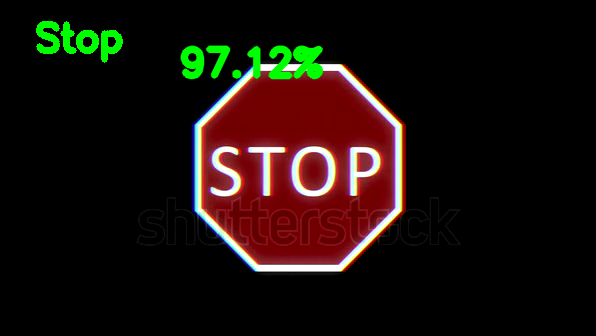

The Traffic signal in the images represents : Stop [14]


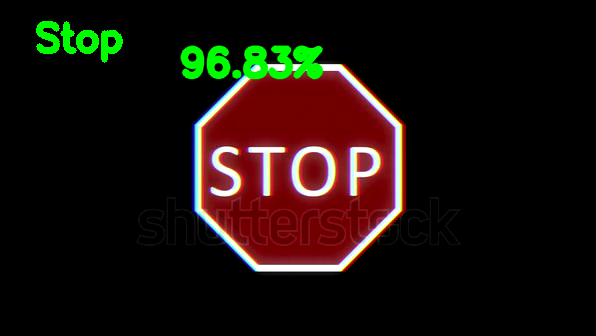

The Traffic signal in the images represents : Stop [14]


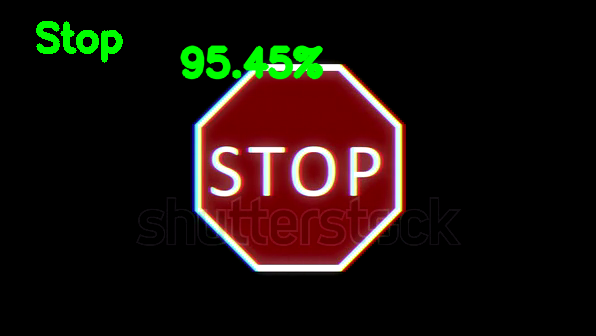

The Traffic signal in the images represents : Stop [14]


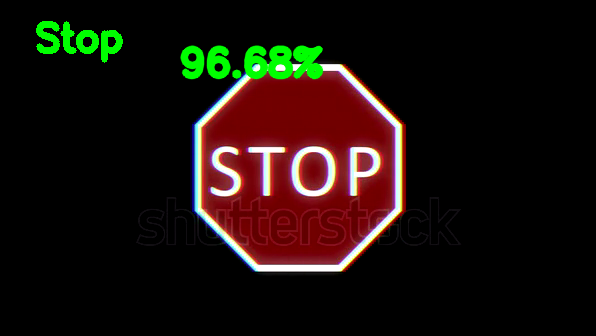

The Traffic signal in the images represents : Stop [14]


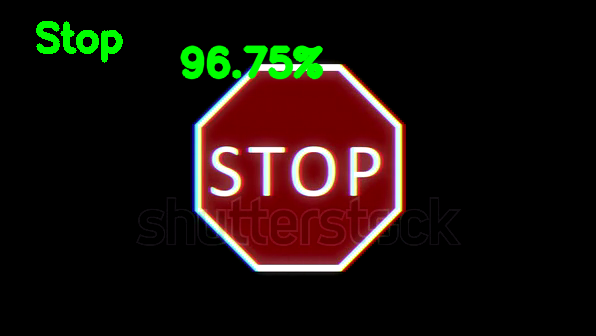

The Traffic signal in the images represents : Stop [14]


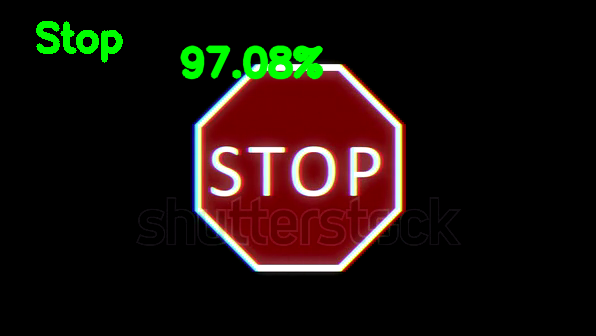

The Traffic signal in the images represents : Stop [14]


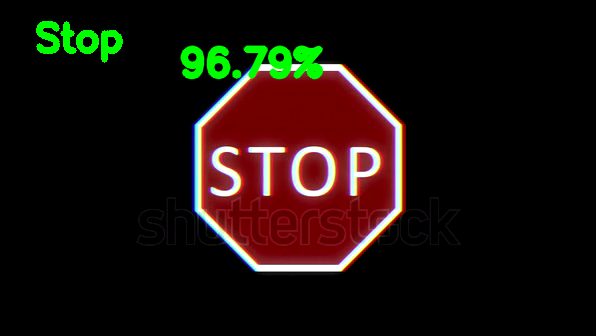

The Traffic signal in the images represents : Stop [14]


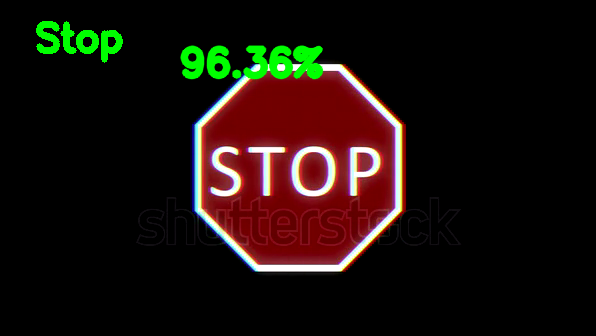

The Traffic signal in the images represents : Stop [14]


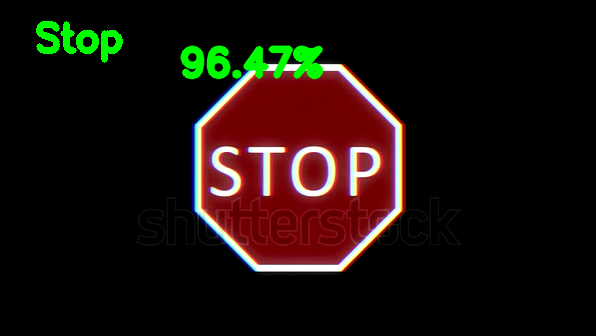

The Traffic signal in the images represents : Stop [14]


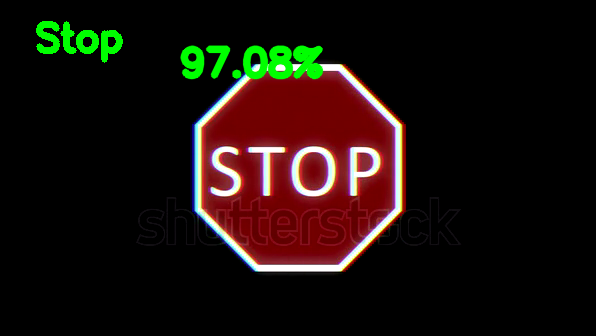

The Traffic signal in the images represents : Stop [14]


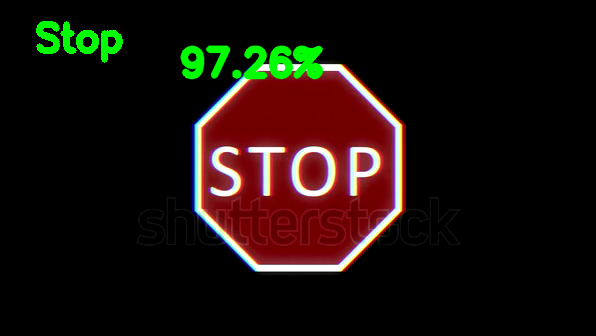

The Traffic signal in the images represents : Stop [14]


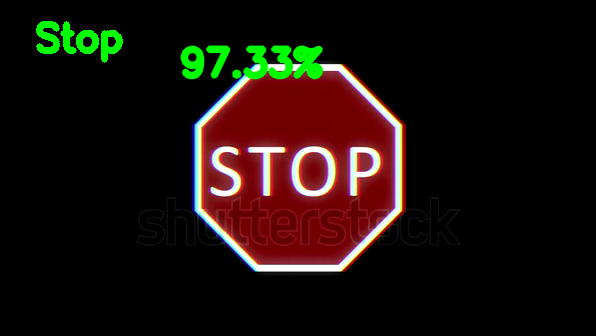

The Traffic signal in the images represents : Stop [14]


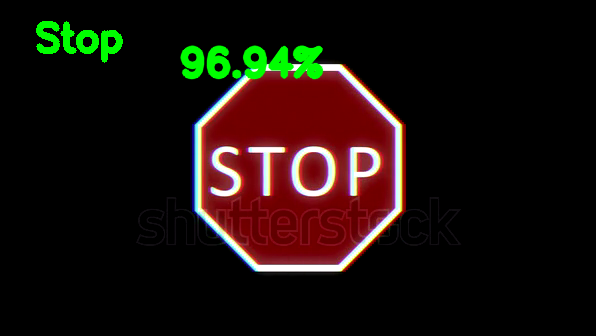

The Traffic signal in the images represents : Stop [14]


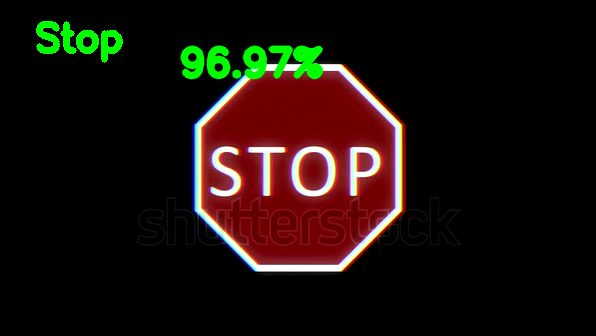

The Traffic signal in the images represents : Stop [14]


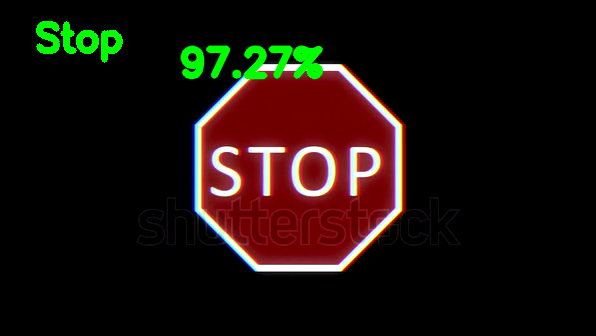

The Traffic signal in the images represents : Stop [14]


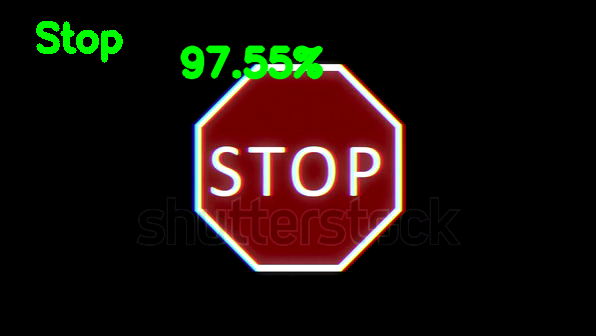

The Traffic signal in the images represents : Stop [14]


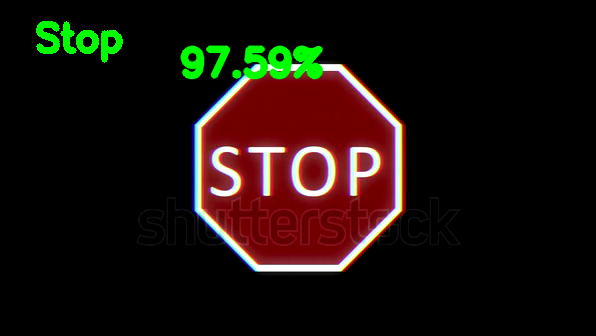

The Traffic signal in the images represents : Stop [14]


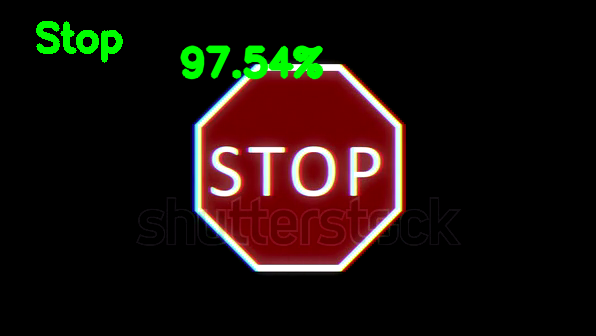

The Traffic signal in the images represents : Stop [14]


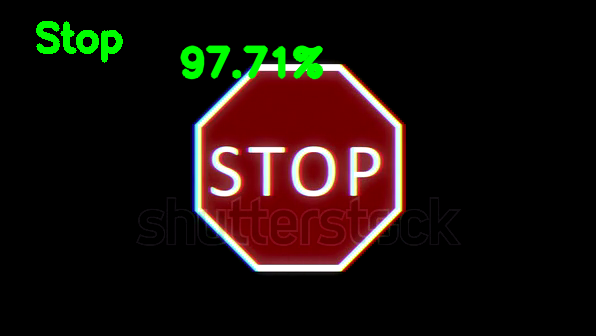

The Traffic signal in the images represents : Stop [14]


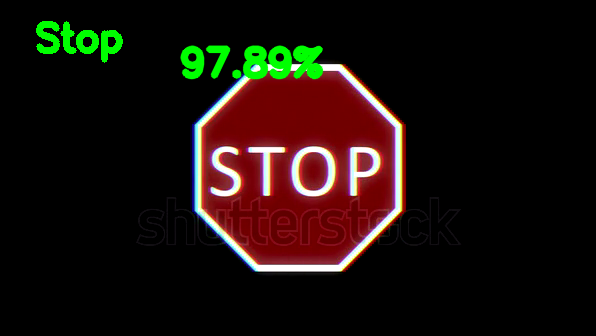

The Traffic signal in the images represents : Stop [14]


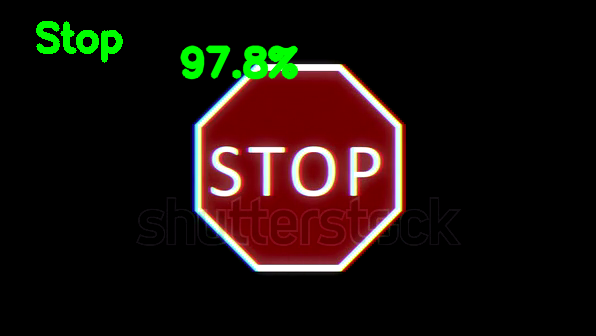

The Traffic signal in the images represents : Stop [14]


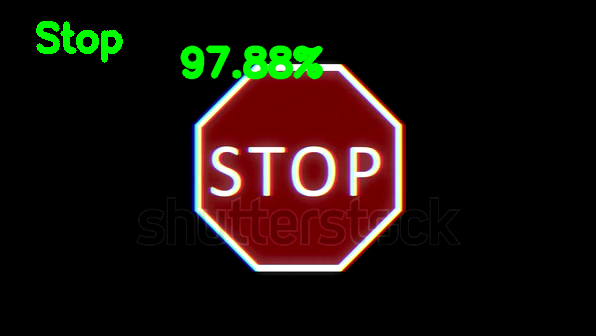

The Traffic signal in the images represents : Stop [14]


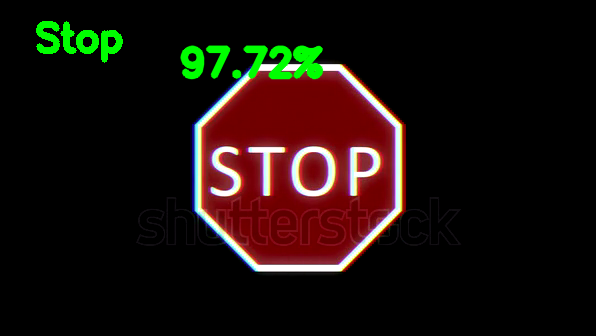

The Traffic signal in the images represents : Stop [14]


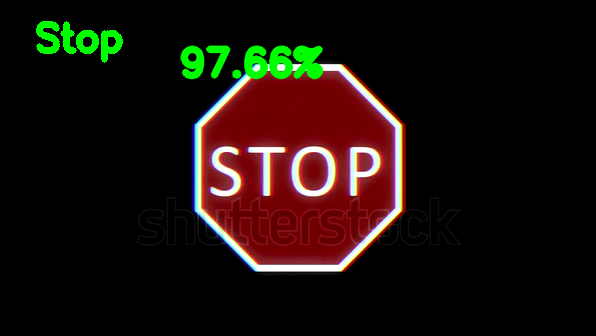

The Traffic signal in the images represents : Stop [14]


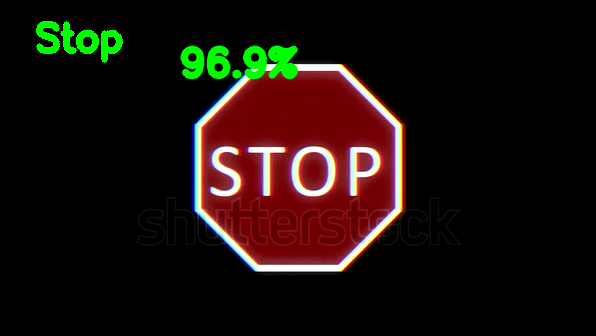

The Traffic signal in the images represents : Stop [14]


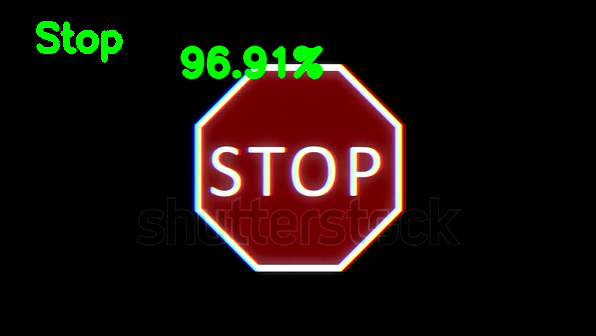

The Traffic signal in the images represents : Stop [14]


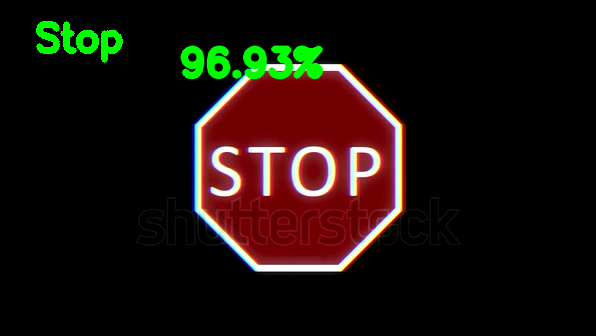

The Traffic signal in the images represents : Stop [14]


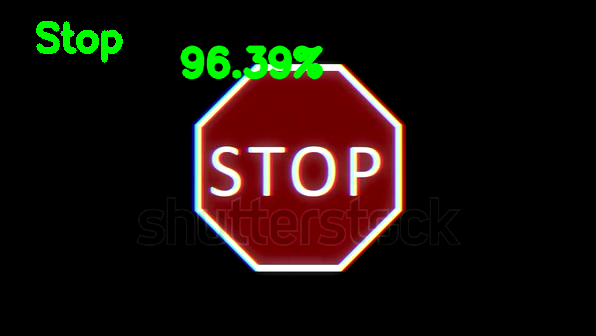

The Traffic signal in the images represents : Stop [14]


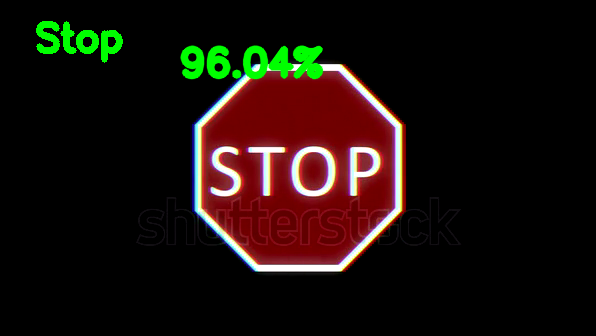

The Traffic signal in the images represents : Stop [14]


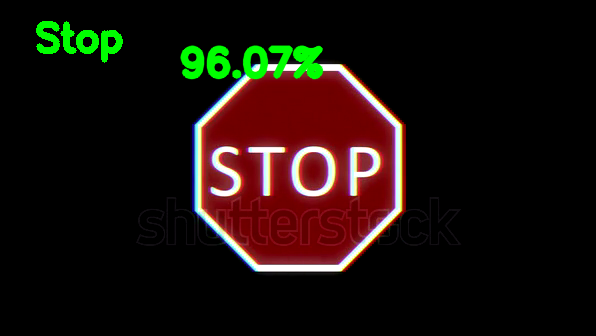

The Traffic signal in the images represents : Stop [14]


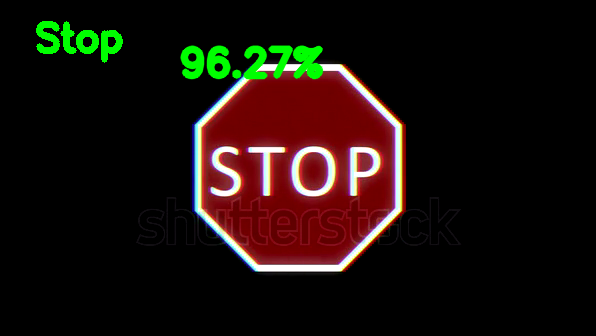

The Traffic signal in the images represents : Stop [14]


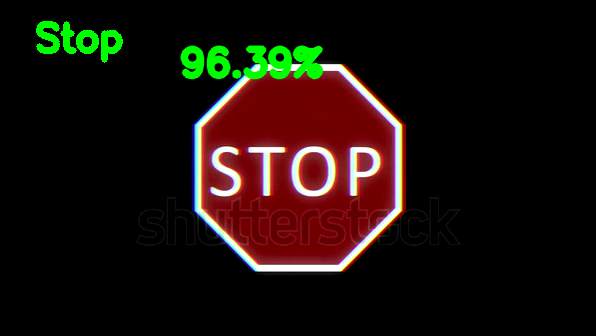

The Traffic signal in the images represents : Stop [14]


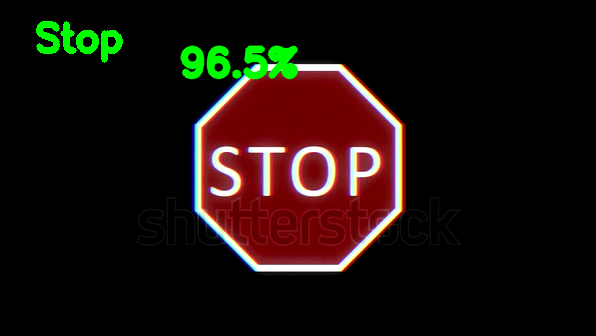

The Traffic signal in the images represents : Stop [14]


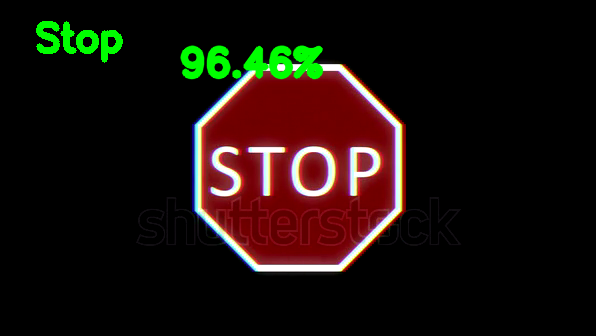

The Traffic signal in the images represents : Stop [14]


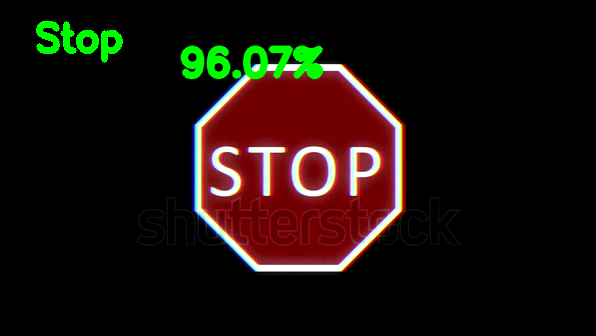

The Traffic signal in the images represents : Stop [14]


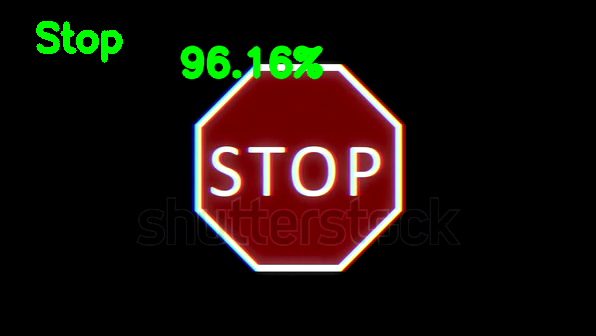

The Traffic signal in the images represents : Stop [14]


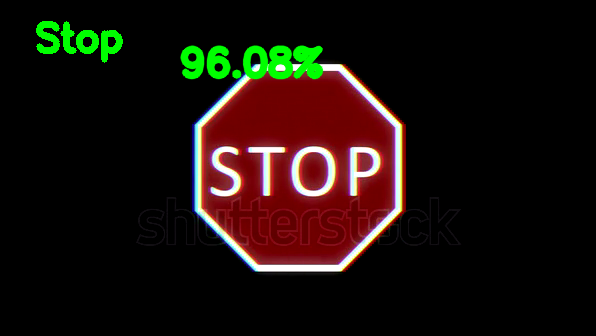

The Traffic signal in the images represents : Stop [14]


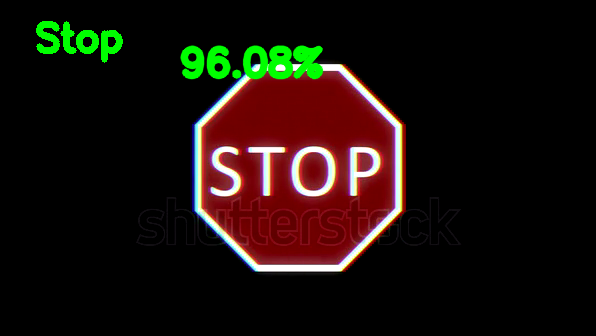

The Traffic signal in the images represents : Stop [14]


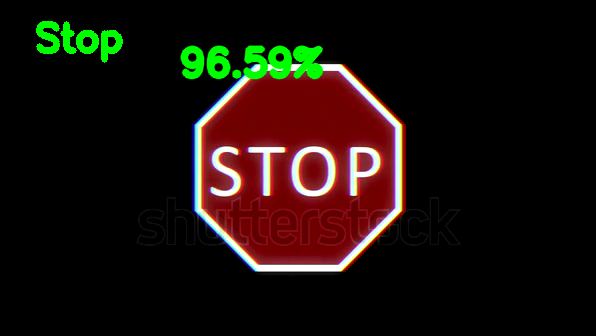

The Traffic signal in the images represents : Stop [14]


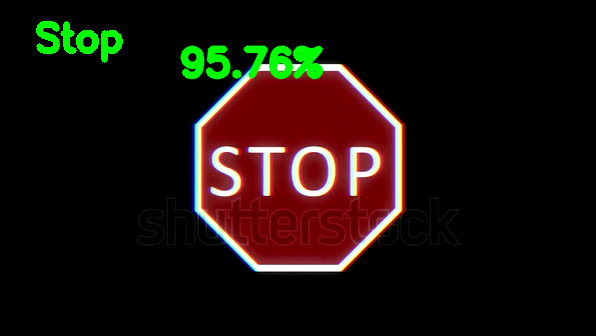

The Traffic signal in the images represents : Stop [14]


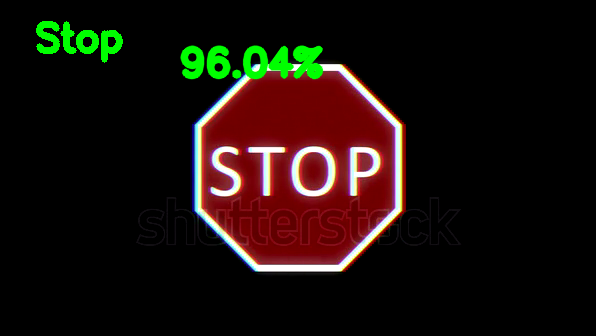

The Traffic signal in the images represents : Stop [14]


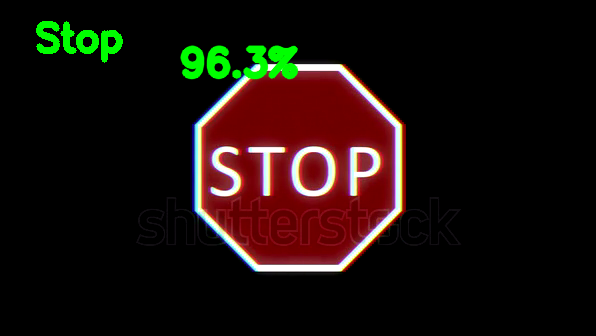

The Traffic signal in the images represents : Stop [14]


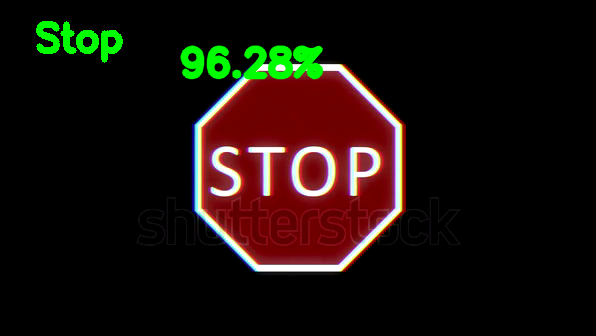

The Traffic signal in the images represents : Stop [14]


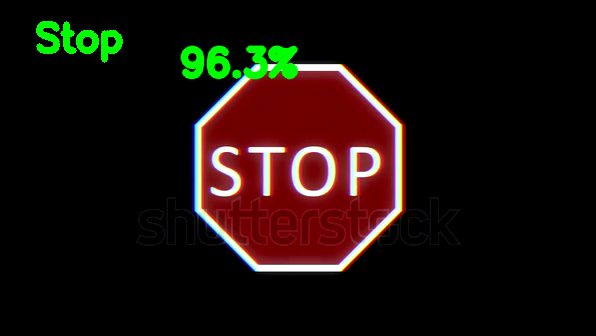

The Traffic signal in the images represents : Stop [14]


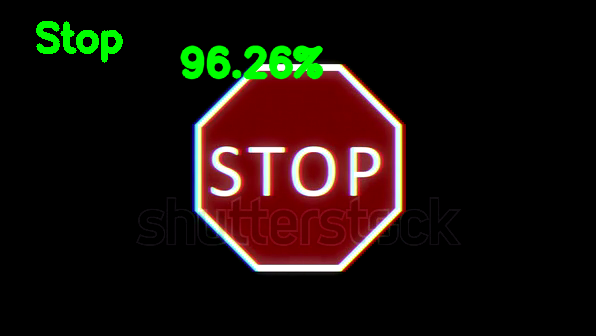

The Traffic signal in the images represents : Stop [14]


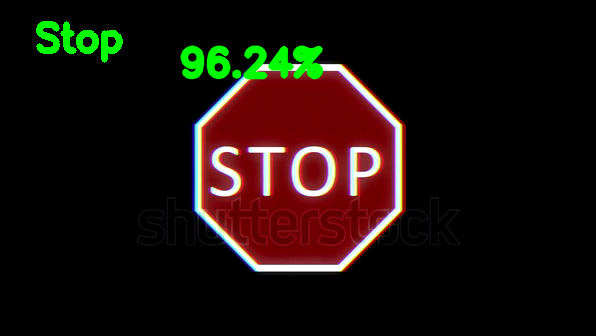

The Traffic signal in the images represents : Stop [14]


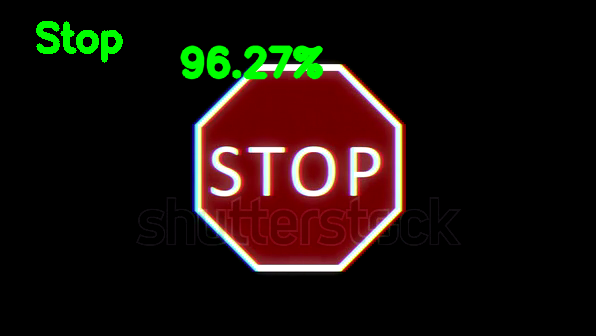

The Traffic signal in the images represents : Stop [14]


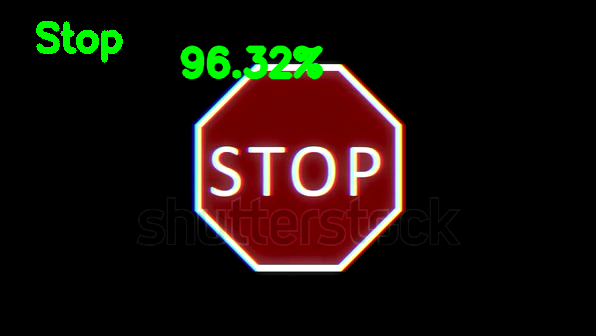

The Traffic signal in the images represents : Stop [14]


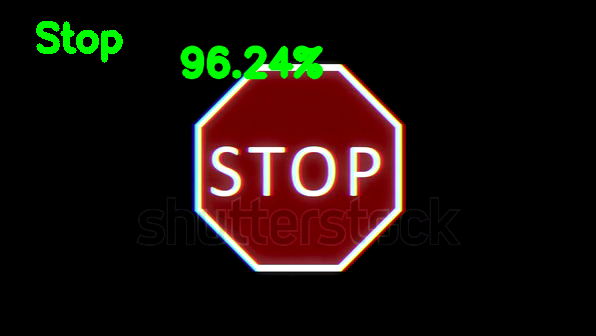

The Traffic signal in the images represents : Stop [14]


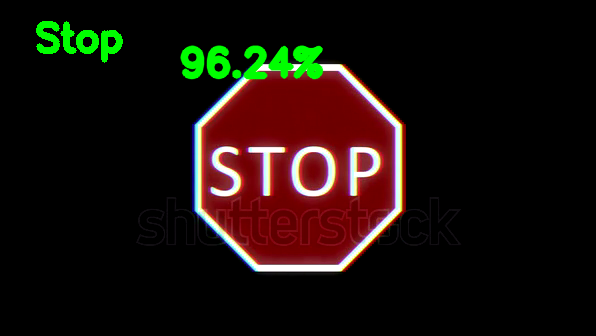

The Traffic signal in the images represents : Stop [14]


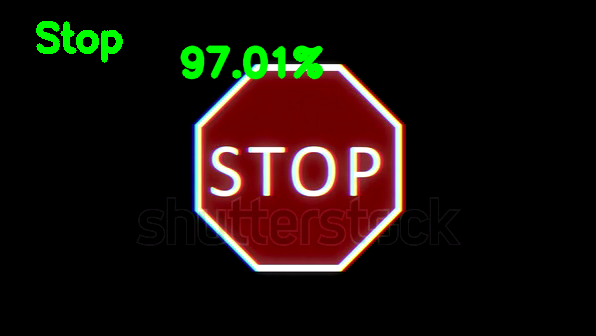

The Traffic signal in the images represents : Stop [14]


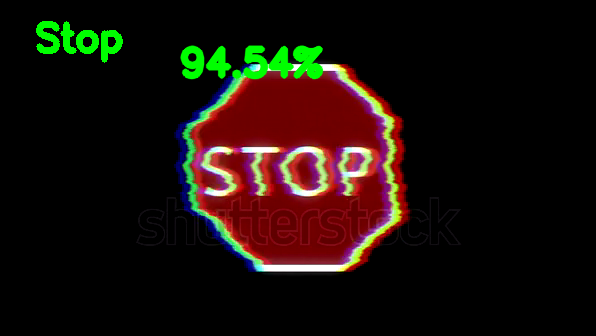

The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No passing for vechiles over 3.5 metric tons [10]
The Traffic signal in the images represents : Keep right [38]


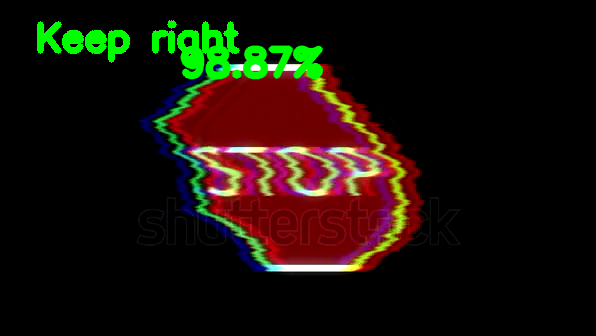

The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : Keep right [38]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Stop [14]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]


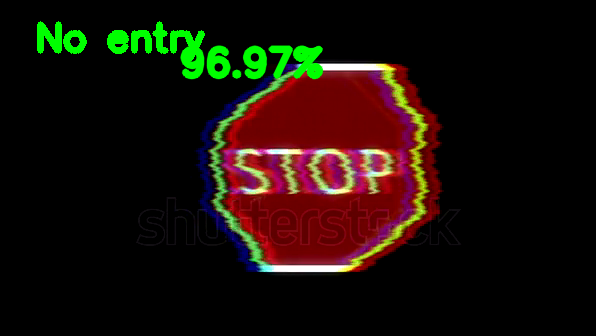

The Traffic signal in the images represents : Speed limit (80km/h) [5]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : No entry [17]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]


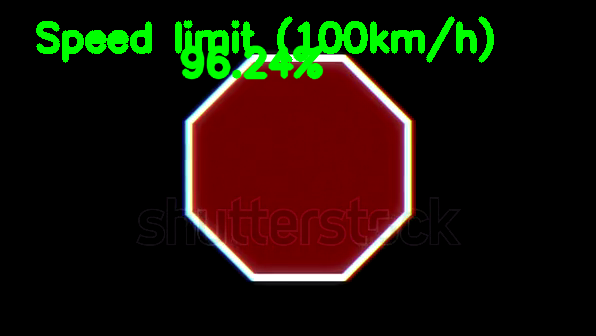

The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Priority road [12]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]


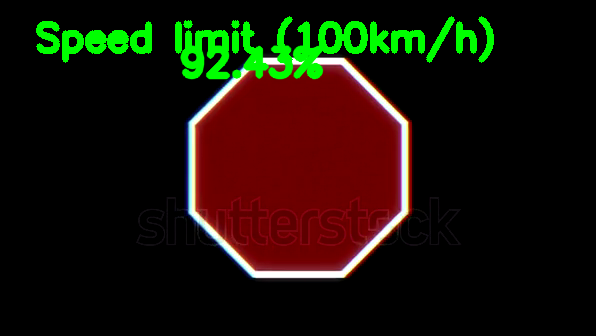

The Traffic signal in the images represents : Speed limit (100km/h) [7]


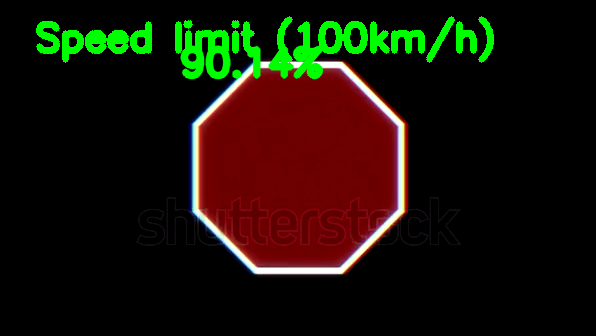

The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (100km/h) [7]


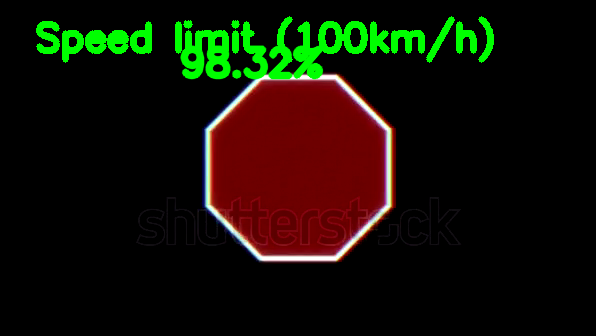

The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : Speed limit (80km/h) [5]
The Traffic signal in the images represents : Speed limit (80km/h) [5]
The Traffic signal in the images represents : No vechiles [15]
The Traffic signal in the images represents : Speed limit (100km/h) [7]
The Traffic signal in the images represents : No vechiles [15]
The Traffic signal in the images represents : No vechiles [15]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : Dangerous curve to the right [20]
The Traffic signal in the images represents : Children crossing [28]
The Traffic signal in the images represents : Children crossing [28]


In [278]:
# loop over frames from the video file stream
while True:
	# read the next frame from the file
	(grabbed, frame) = cap.read()
 
	# if the frame was not grabbed, then we have reached the end
	# of the stream
	if not grabbed:
		break
 
	# if the frame dimensions are empty, grab them
	if W is None or H is None:
		(H, W) = frame.shape[:2]
	# clone the output frame, then convert it from BGR to RGB
	# ordering and resize the frame to a fixed 224x224
	output = frame.copy()
	frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
	frame = cv2.resize(frame, (32,32))
	frame = cv2.equalizeHist(frame)
	frame = frame/255.0
	frame = frame.reshape(1, 32, 32, 1)
	# make predictions on the frame and then update the predictions
	# queue
	preds = model.predict(frame)
	classIndex = model.predict_classes(frame)
	probabilityValue =np.amax(preds)
	print(f'The Traffic signal in the images represents : {label_map[classIndex[0]]} { classIndex}')
	img = cv2.imread(test_image_path)
	text = label_map[classIndex[0]]
	Q.append(preds)
	# perform prediction averaging over the current history of
	# previous predictions
	results = np.array(Q).mean(axis=0)
	i = np.argmax(results)
	#label = CLASSES[i]
	# draw the activity on the output frame
	#text = "activity: {}".format(label)
	if probabilityValue > 0.90:
		cv2.putText(output, text, (35, 50), cv2.FONT_HERSHEY_SIMPLEX,1.25, (0, 255, 0), 5)
		cv2.putText(output, str(round(probabilityValue*100,2) )+"%", (180, 75), font, 1.25, (0, 255, 0), 5, cv2.LINE_AA)
		cv2_imshow(output)


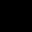

The Traffic signal in the images represents : Children crossing [28]


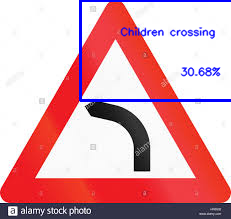

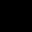

The Traffic signal in the images represents : Children crossing [28]


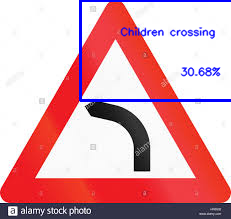

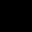

The Traffic signal in the images represents : Dangerous curve to the right [20]


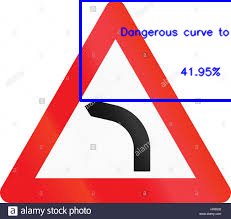

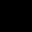

The Traffic signal in the images represents : Dangerous curve to the right [20]


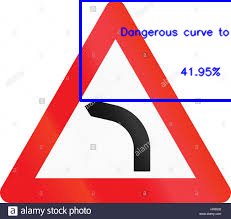

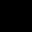

The Traffic signal in the images represents : Dangerous curve to the right [20]


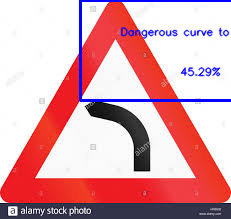

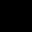

The Traffic signal in the images represents : Dangerous curve to the right [20]


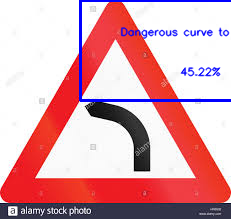

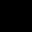

The Traffic signal in the images represents : No vechiles [15]


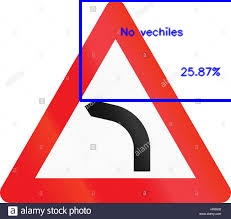

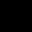

The Traffic signal in the images represents : No vechiles [15]


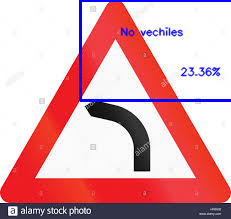

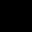

The Traffic signal in the images represents : Yield [13]


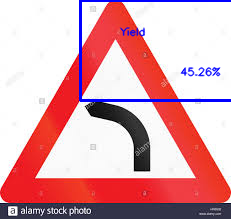

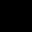

The Traffic signal in the images represents : No vechiles [15]


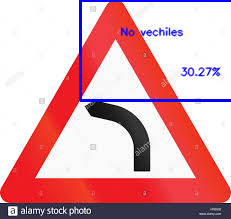

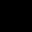

The Traffic signal in the images represents : No vechiles [15]


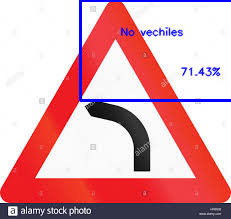

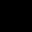

The Traffic signal in the images represents : No vechiles [15]


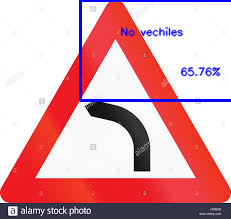

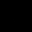

The Traffic signal in the images represents : Priority road [12]


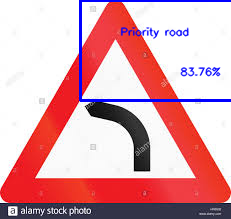

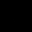

The Traffic signal in the images represents : Speed limit (120km/h) [8]


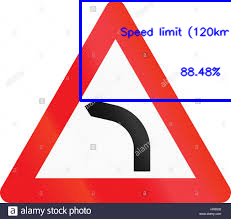

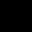

The Traffic signal in the images represents : No vechiles [15]


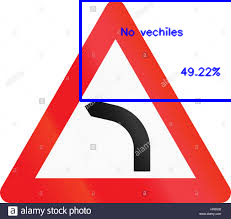

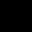

The Traffic signal in the images represents : No vechiles [15]


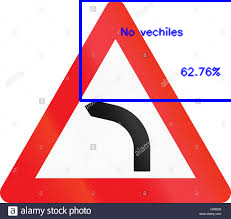

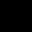

The Traffic signal in the images represents : Speed limit (100km/h) [7]


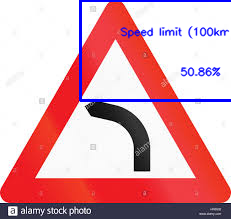

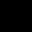

The Traffic signal in the images represents : No vechiles [15]


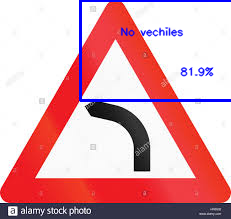

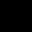

The Traffic signal in the images represents : No vechiles [15]


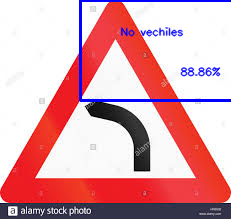

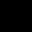

The Traffic signal in the images represents : Priority road [12]


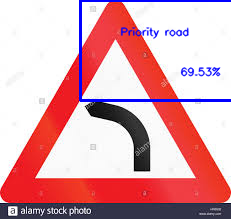

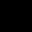

The Traffic signal in the images represents : Priority road [12]


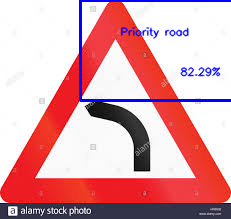

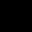

The Traffic signal in the images represents : Priority road [12]


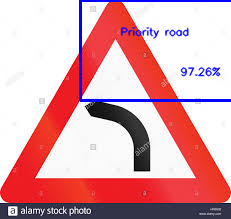

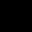

The Traffic signal in the images represents : No vechiles [15]


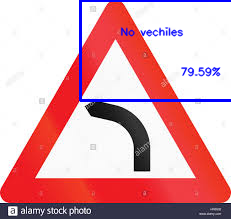

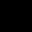

The Traffic signal in the images represents : No vechiles [15]


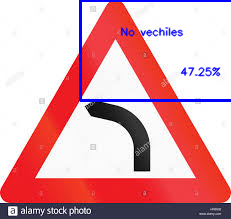

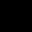

The Traffic signal in the images represents : No vechiles [15]


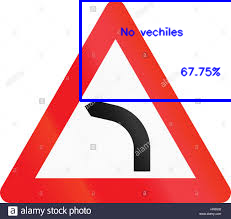

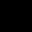

The Traffic signal in the images represents : Speed limit (70km/h) [4]


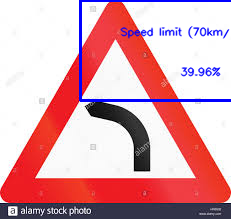

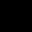

The Traffic signal in the images represents : Speed limit (120km/h) [8]


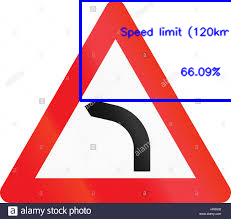

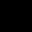

The Traffic signal in the images represents : Speed limit (120km/h) [8]


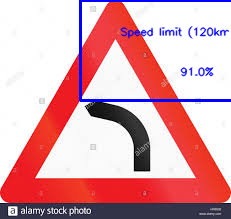

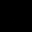

The Traffic signal in the images represents : No vechiles [15]


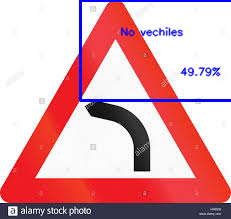

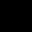

The Traffic signal in the images represents : No vechiles [15]


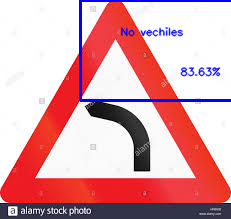

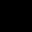

The Traffic signal in the images represents : No vechiles [15]


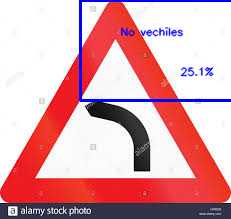

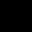

The Traffic signal in the images represents : Priority road [12]


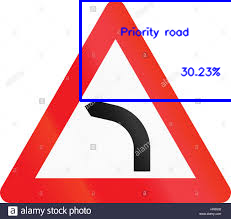

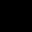

The Traffic signal in the images represents : Priority road [12]


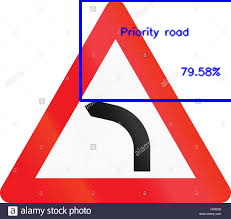

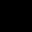

The Traffic signal in the images represents : Priority road [12]


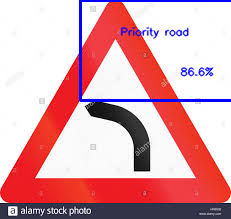

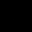

The Traffic signal in the images represents : Priority road [12]


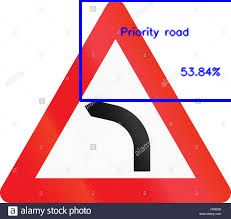

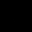

The Traffic signal in the images represents : Priority road [12]


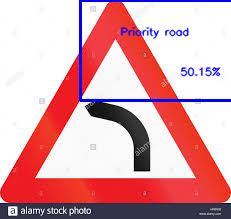

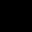

The Traffic signal in the images represents : Priority road [12]


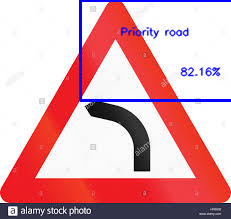

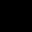

The Traffic signal in the images represents : Priority road [12]


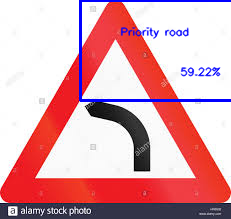

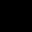

The Traffic signal in the images represents : Roundabout mandatory [40]


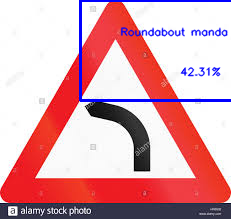

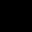

The Traffic signal in the images represents : Roundabout mandatory [40]


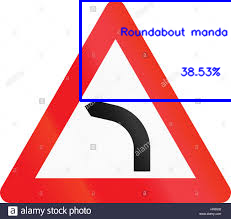

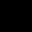

The Traffic signal in the images represents : Stop [14]


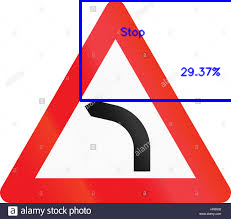

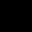

The Traffic signal in the images represents : Priority road [12]


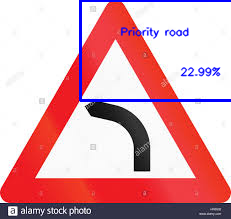

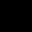

The Traffic signal in the images represents : Stop [14]


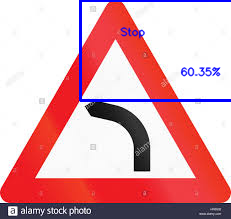

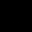

The Traffic signal in the images represents : Stop [14]


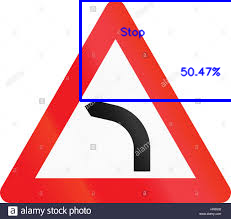

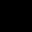

The Traffic signal in the images represents : Roundabout mandatory [40]


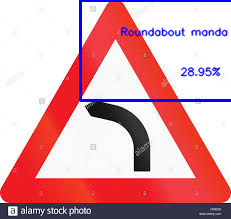

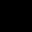

The Traffic signal in the images represents : Roundabout mandatory [40]


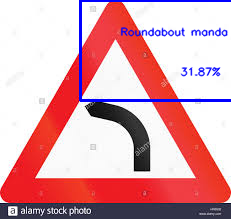

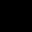

The Traffic signal in the images represents : Roundabout mandatory [40]


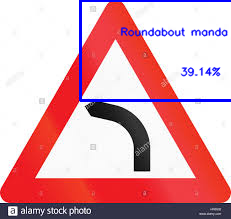

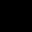

The Traffic signal in the images represents : Roundabout mandatory [40]


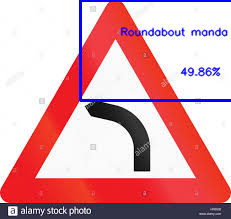

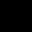

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


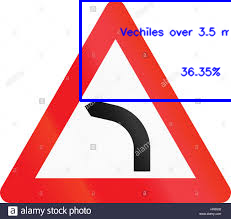

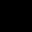

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


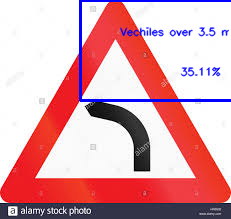

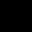

The Traffic signal in the images represents : Roundabout mandatory [40]


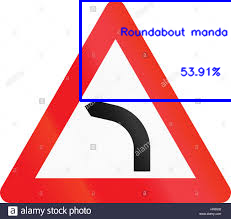

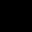

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


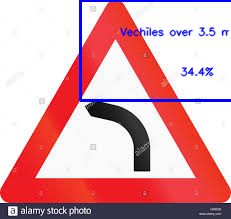

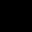

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


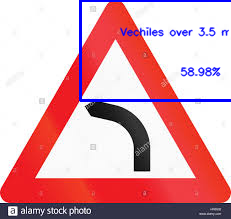

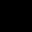

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


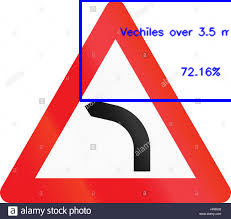

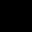

The Traffic signal in the images represents : Roundabout mandatory [40]


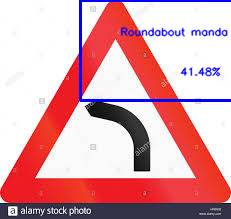

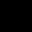

The Traffic signal in the images represents : Roundabout mandatory [40]


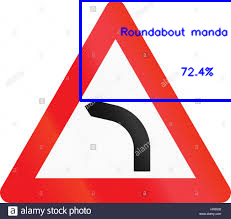

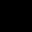

The Traffic signal in the images represents : Roundabout mandatory [40]


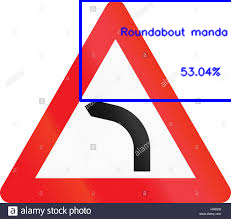

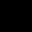

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


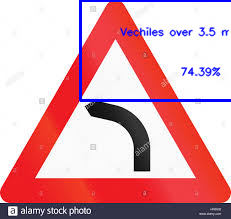

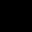

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


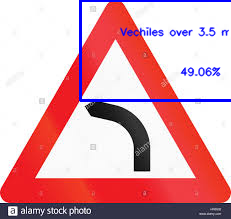

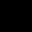

The Traffic signal in the images represents : Roundabout mandatory [40]


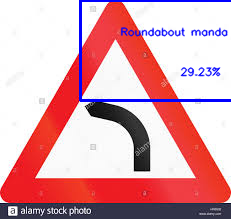

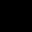

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


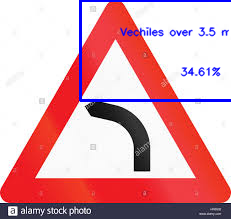

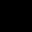

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


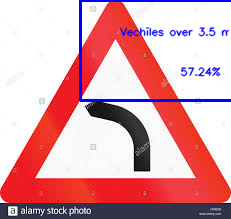

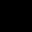

The Traffic signal in the images represents : Stop [14]


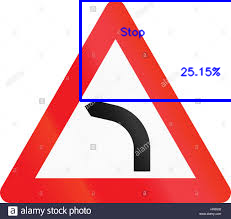

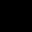

The Traffic signal in the images represents : Priority road [12]


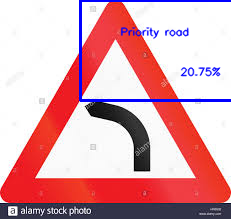

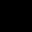

The Traffic signal in the images represents : Priority road [12]


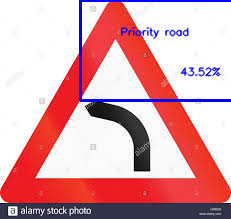

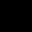

The Traffic signal in the images represents : Priority road [12]


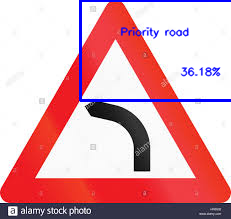

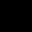

The Traffic signal in the images represents : Stop [14]


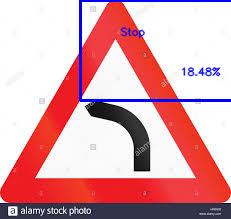

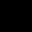

The Traffic signal in the images represents : Priority road [12]


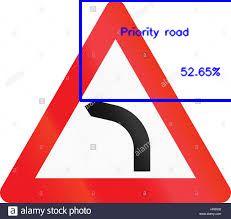

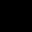

The Traffic signal in the images represents : Priority road [12]


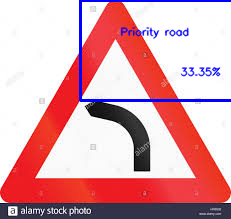

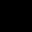

The Traffic signal in the images represents : Priority road [12]


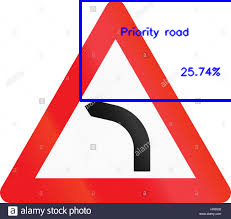

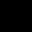

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


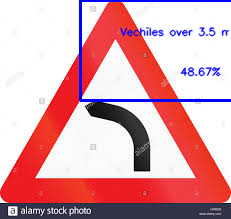

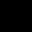

The Traffic signal in the images represents : Roundabout mandatory [40]


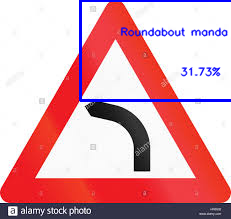

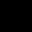

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


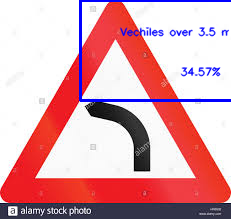

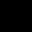

The Traffic signal in the images represents : Keep right [38]


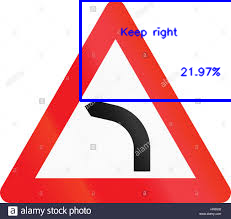

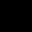

The Traffic signal in the images represents : Priority road [12]


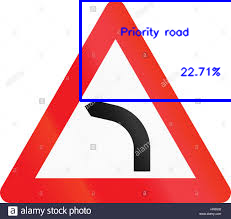

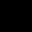

The Traffic signal in the images represents : Priority road [12]


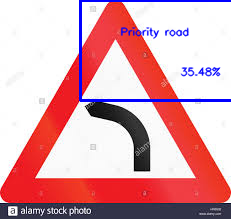

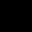

The Traffic signal in the images represents : Priority road [12]


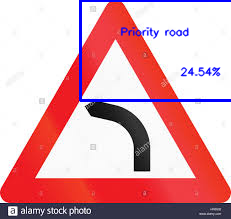

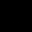

The Traffic signal in the images represents : Priority road [12]


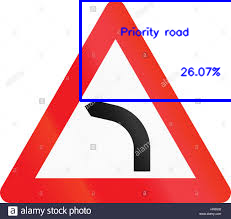

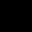

The Traffic signal in the images represents : Priority road [12]


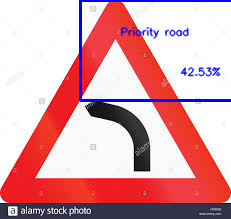

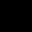

The Traffic signal in the images represents : Priority road [12]


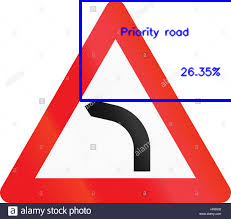

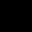

The Traffic signal in the images represents : Priority road [12]


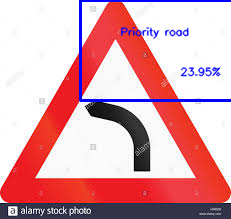

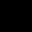

The Traffic signal in the images represents : Priority road [12]


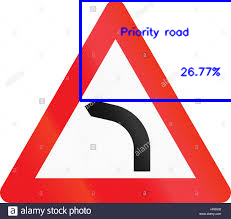

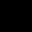

The Traffic signal in the images represents : No vechiles [15]


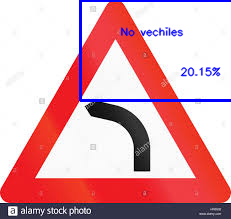

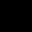

The Traffic signal in the images represents : No vechiles [15]


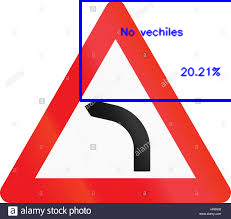

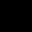

The Traffic signal in the images represents : No vechiles [15]


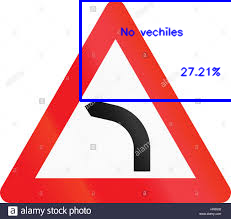

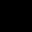

The Traffic signal in the images represents : Roundabout mandatory [40]


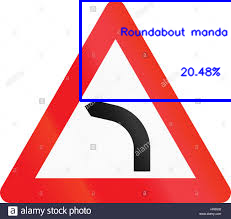

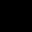

The Traffic signal in the images represents : No vechiles [15]


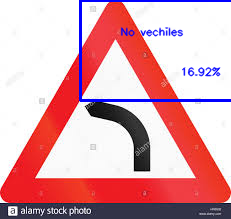

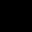

The Traffic signal in the images represents : Stop [14]


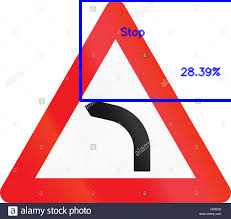

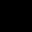

The Traffic signal in the images represents : Stop [14]


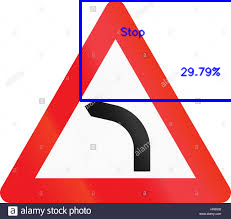

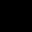

The Traffic signal in the images represents : Speed limit (120km/h) [8]


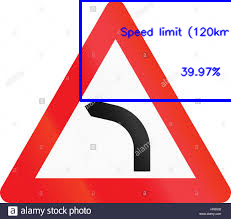

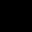

The Traffic signal in the images represents : Speed limit (120km/h) [8]


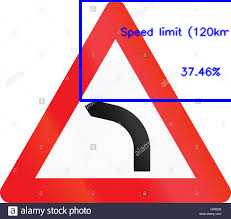

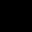

The Traffic signal in the images represents : Speed limit (120km/h) [8]


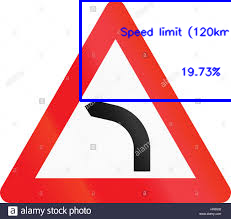

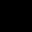

The Traffic signal in the images represents : Speed limit (120km/h) [8]


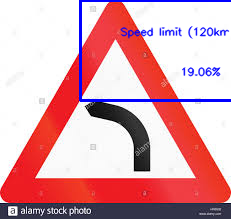

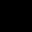

The Traffic signal in the images represents : Speed limit (120km/h) [8]


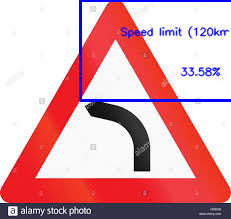

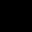

The Traffic signal in the images represents : Speed limit (120km/h) [8]


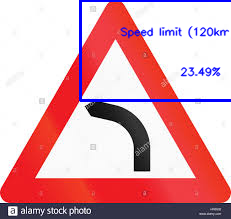

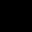

The Traffic signal in the images represents : Speed limit (120km/h) [8]


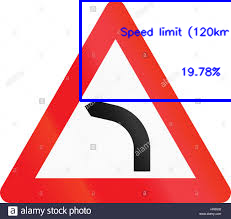

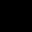

The Traffic signal in the images represents : Speed limit (120km/h) [8]


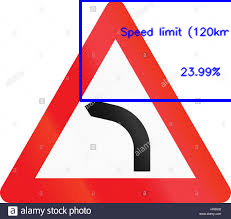

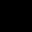

The Traffic signal in the images represents : Speed limit (120km/h) [8]


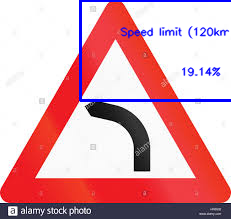

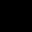

The Traffic signal in the images represents : Priority road [12]


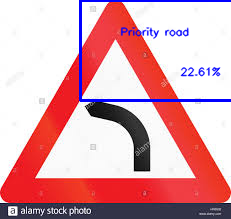

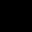

The Traffic signal in the images represents : Priority road [12]


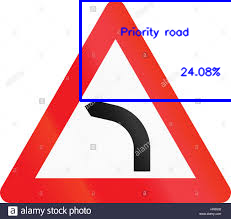

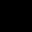

The Traffic signal in the images represents : Roundabout mandatory [40]


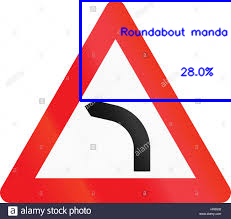

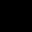

The Traffic signal in the images represents : Speed limit (120km/h) [8]


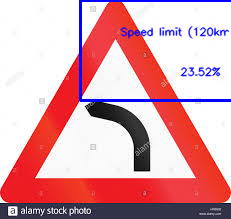

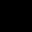

The Traffic signal in the images represents : Speed limit (120km/h) [8]


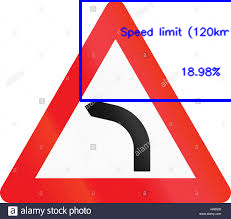

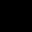

The Traffic signal in the images represents : Priority road [12]


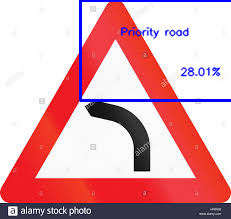

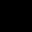

The Traffic signal in the images represents : Priority road [12]


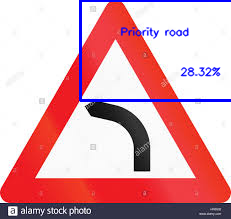

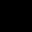

The Traffic signal in the images represents : Priority road [12]


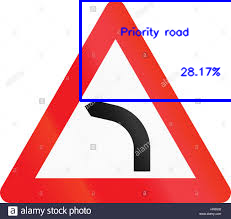

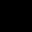

The Traffic signal in the images represents : Priority road [12]


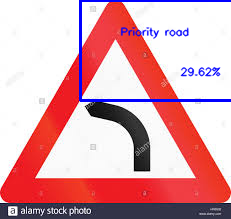

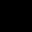

The Traffic signal in the images represents : Roundabout mandatory [40]


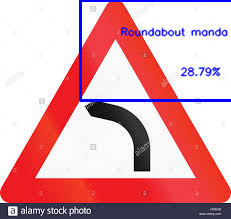

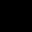

The Traffic signal in the images represents : Turn left ahead [34]


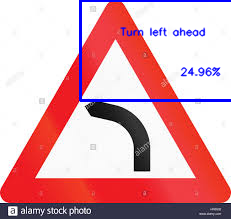

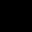

The Traffic signal in the images represents : Speed limit (120km/h) [8]


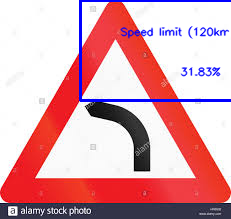

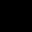

The Traffic signal in the images represents : Turn left ahead [34]


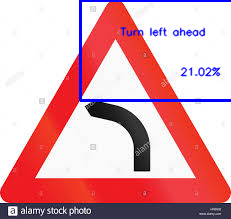

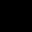

The Traffic signal in the images represents : Priority road [12]


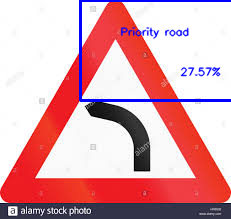

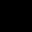

The Traffic signal in the images represents : Stop [14]


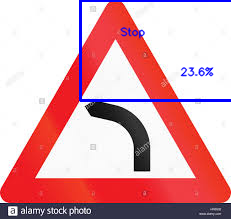

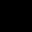

The Traffic signal in the images represents : Priority road [12]


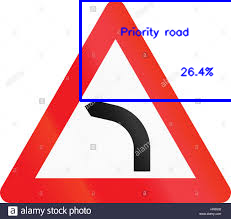

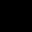

The Traffic signal in the images represents : Priority road [12]


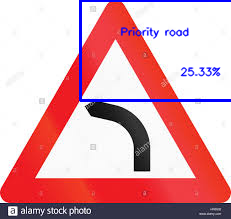

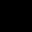

The Traffic signal in the images represents : Speed limit (120km/h) [8]


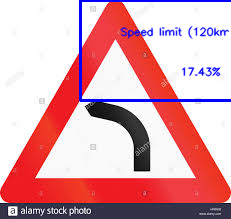

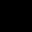

The Traffic signal in the images represents : Speed limit (120km/h) [8]


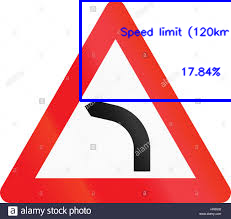

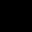

The Traffic signal in the images represents : Speed limit (120km/h) [8]


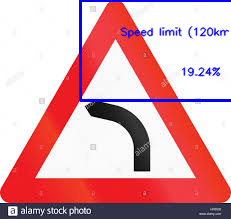

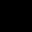

The Traffic signal in the images represents : Speed limit (120km/h) [8]


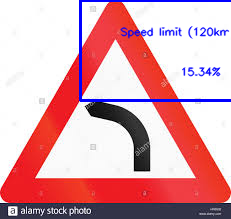

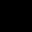

The Traffic signal in the images represents : Priority road [12]


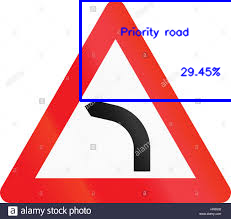

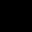

The Traffic signal in the images represents : Priority road [12]


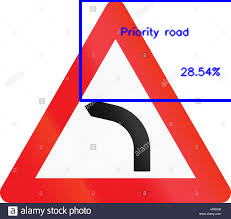

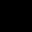

The Traffic signal in the images represents : Priority road [12]


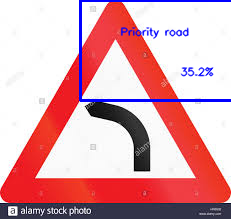

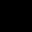

The Traffic signal in the images represents : Priority road [12]


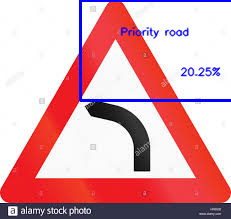

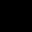

The Traffic signal in the images represents : Priority road [12]


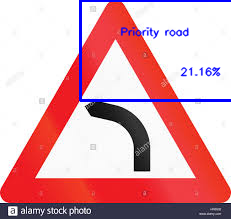

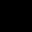

The Traffic signal in the images represents : Turn left ahead [34]


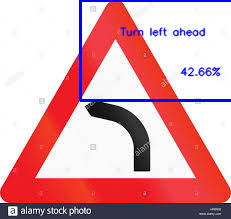

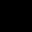

The Traffic signal in the images represents : Roundabout mandatory [40]


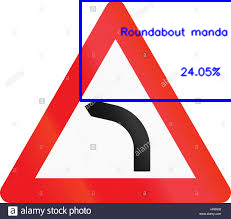

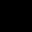

The Traffic signal in the images represents : Roundabout mandatory [40]


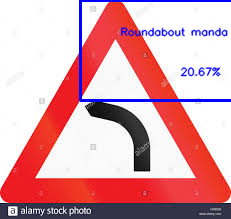

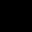

The Traffic signal in the images represents : Roundabout mandatory [40]


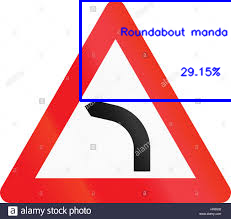

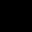

The Traffic signal in the images represents : Roundabout mandatory [40]


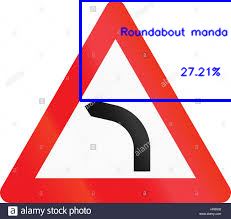

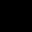

The Traffic signal in the images represents : Speed limit (120km/h) [8]


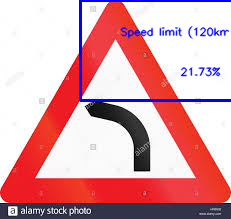

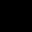

The Traffic signal in the images represents : Priority road [12]


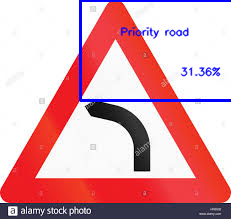

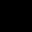

The Traffic signal in the images represents : Priority road [12]


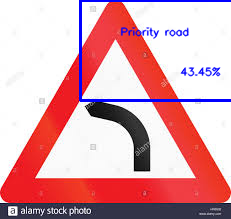

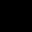

The Traffic signal in the images represents : Priority road [12]


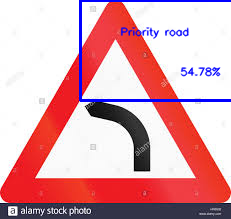

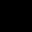

The Traffic signal in the images represents : Priority road [12]


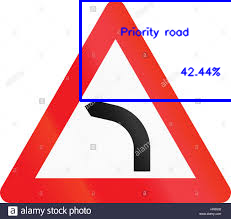

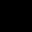

The Traffic signal in the images represents : Stop [14]


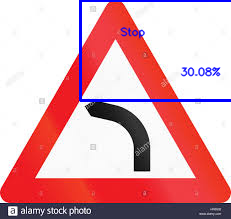

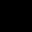

The Traffic signal in the images represents : Stop [14]


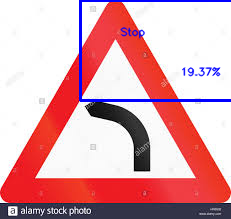

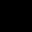

The Traffic signal in the images represents : Stop [14]


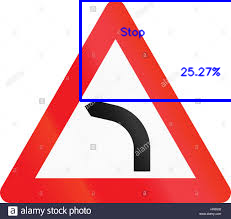

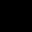

The Traffic signal in the images represents : Stop [14]


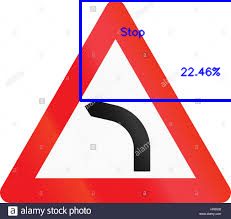

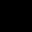

The Traffic signal in the images represents : No passing [9]


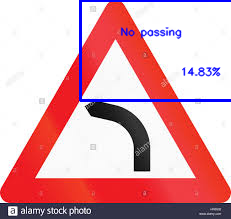

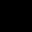

The Traffic signal in the images represents : Roundabout mandatory [40]


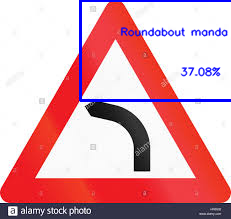

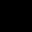

The Traffic signal in the images represents : Priority road [12]


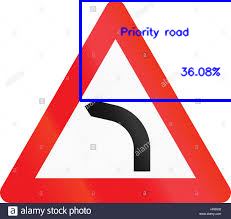

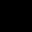

The Traffic signal in the images represents : Roundabout mandatory [40]


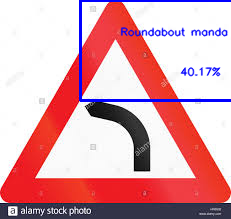

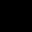

The Traffic signal in the images represents : Priority road [12]


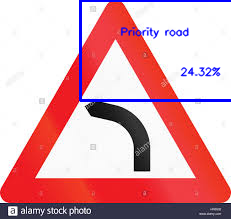

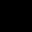

The Traffic signal in the images represents : Stop [14]


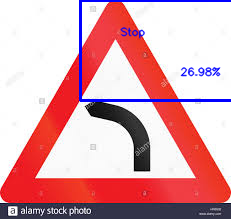

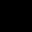

The Traffic signal in the images represents : Priority road [12]


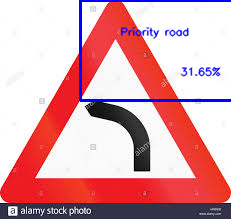

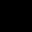

The Traffic signal in the images represents : Priority road [12]


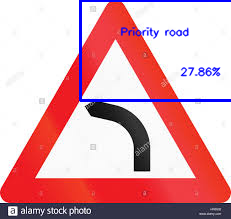

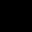

The Traffic signal in the images represents : Priority road [12]


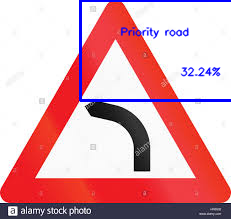

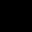

The Traffic signal in the images represents : Priority road [12]


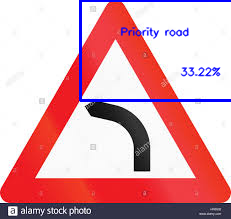

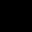

The Traffic signal in the images represents : Priority road [12]


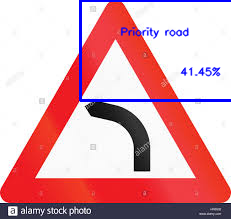

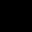

The Traffic signal in the images represents : Priority road [12]


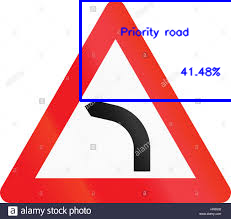

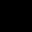

The Traffic signal in the images represents : Priority road [12]


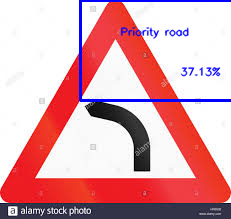

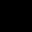

The Traffic signal in the images represents : Priority road [12]


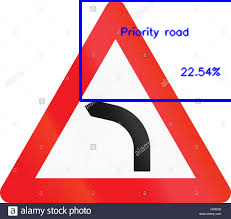

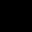

The Traffic signal in the images represents : Speed limit (120km/h) [8]


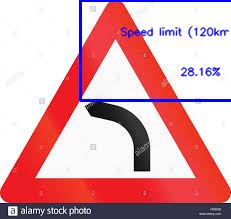

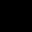

The Traffic signal in the images represents : Priority road [12]


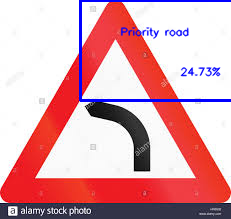

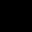

The Traffic signal in the images represents : No vechiles [15]


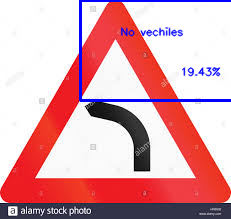

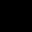

The Traffic signal in the images represents : Priority road [12]


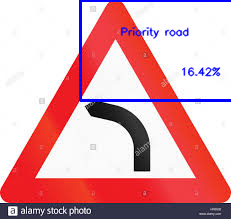

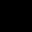

The Traffic signal in the images represents : No vechiles [15]


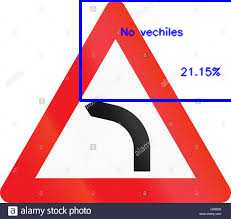

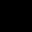

The Traffic signal in the images represents : Priority road [12]


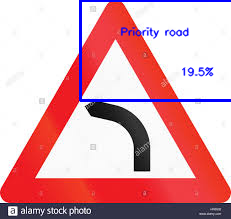

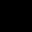

The Traffic signal in the images represents : Stop [14]


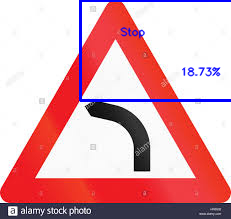

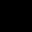

The Traffic signal in the images represents : Stop [14]


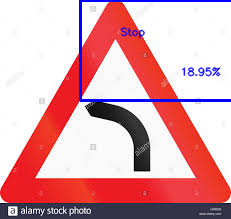

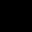

The Traffic signal in the images represents : Stop [14]


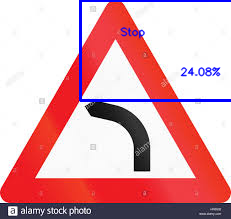

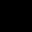

The Traffic signal in the images represents : Stop [14]


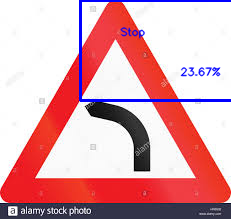

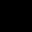

The Traffic signal in the images represents : Stop [14]


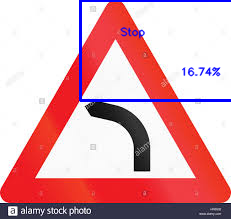

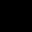

The Traffic signal in the images represents : Stop [14]


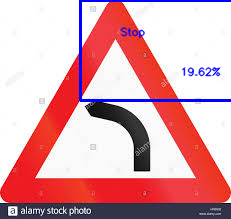

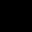

The Traffic signal in the images represents : Stop [14]


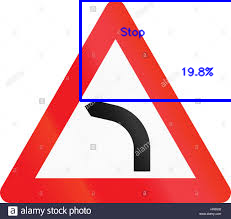

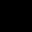

The Traffic signal in the images represents : Stop [14]


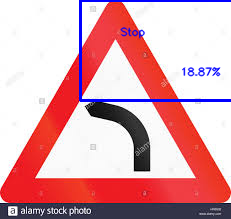

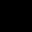

The Traffic signal in the images represents : Stop [14]


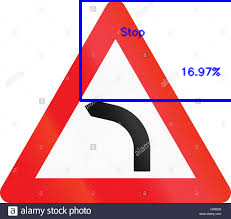

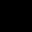

The Traffic signal in the images represents : Stop [14]


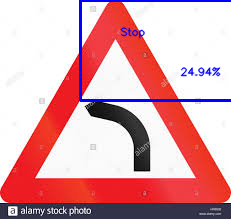

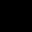

The Traffic signal in the images represents : Speed limit (120km/h) [8]


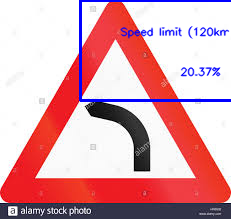

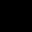

The Traffic signal in the images represents : Speed limit (120km/h) [8]


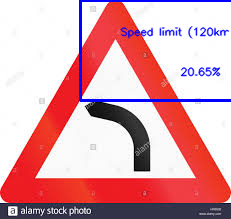

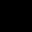

The Traffic signal in the images represents : Speed limit (60km/h) [3]


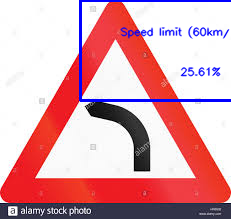

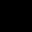

The Traffic signal in the images represents : Speed limit (120km/h) [8]


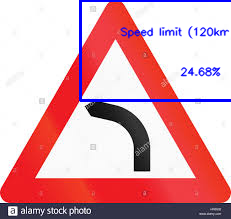

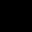

The Traffic signal in the images represents : Speed limit (60km/h) [3]


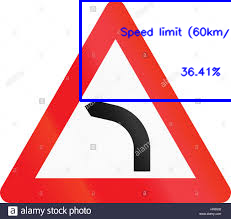

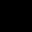

The Traffic signal in the images represents : Priority road [12]


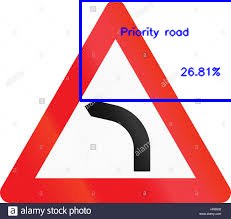

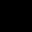

The Traffic signal in the images represents : No vechiles [15]


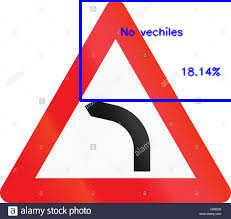

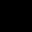

The Traffic signal in the images represents : Roundabout mandatory [40]


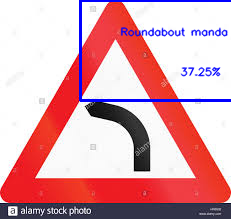

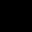

The Traffic signal in the images represents : Priority road [12]


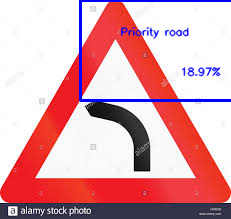

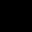

The Traffic signal in the images represents : No passing [9]


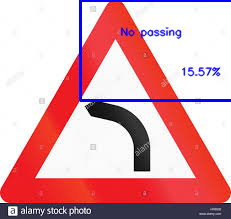

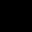

The Traffic signal in the images represents : Priority road [12]


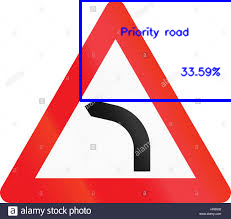

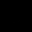

The Traffic signal in the images represents : Priority road [12]


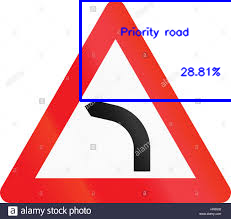

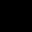

The Traffic signal in the images represents : Priority road [12]


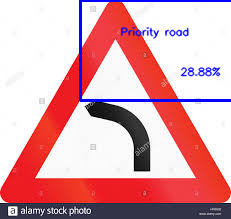

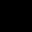

The Traffic signal in the images represents : Stop [14]


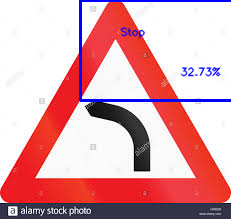

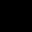

The Traffic signal in the images represents : Stop [14]


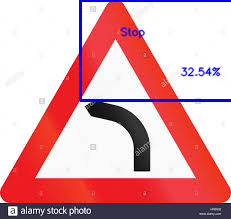

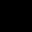

The Traffic signal in the images represents : Stop [14]


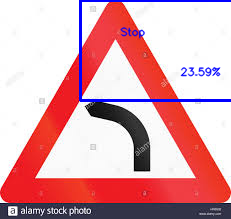

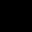

The Traffic signal in the images represents : Priority road [12]


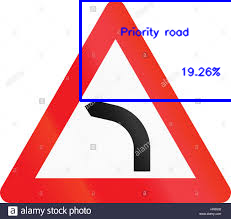

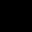

The Traffic signal in the images represents : Roundabout mandatory [40]


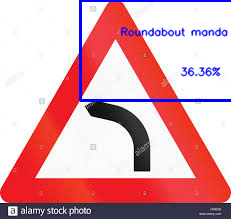

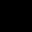

The Traffic signal in the images represents : Roundabout mandatory [40]


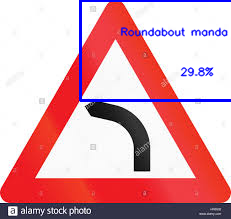

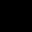

The Traffic signal in the images represents : Priority road [12]


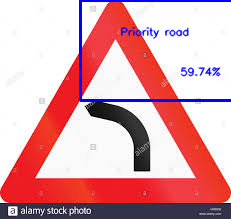

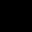

The Traffic signal in the images represents : Priority road [12]


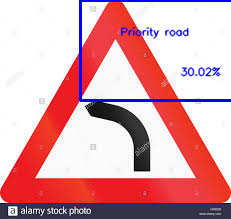

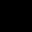

The Traffic signal in the images represents : Priority road [12]


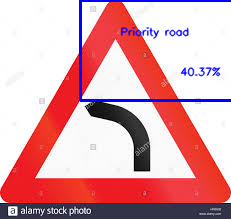

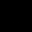

The Traffic signal in the images represents : Roundabout mandatory [40]


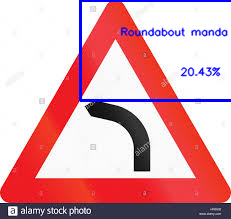

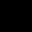

The Traffic signal in the images represents : Priority road [12]


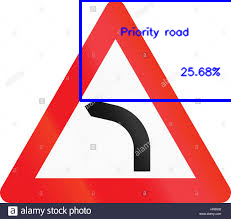

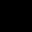

The Traffic signal in the images represents : Priority road [12]


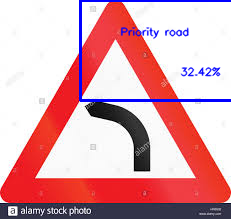

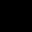

The Traffic signal in the images represents : Priority road [12]


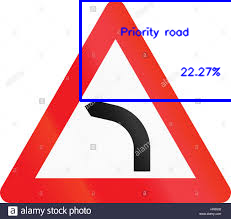

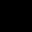

The Traffic signal in the images represents : Priority road [12]


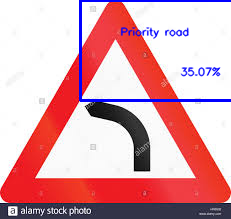

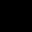

The Traffic signal in the images represents : No passing [9]


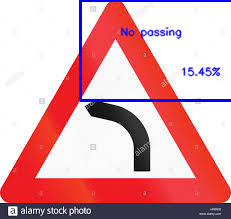

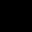

The Traffic signal in the images represents : Turn left ahead [34]


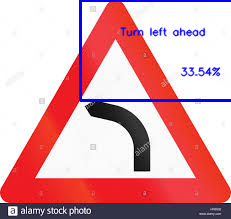

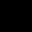

The Traffic signal in the images represents : Priority road [12]


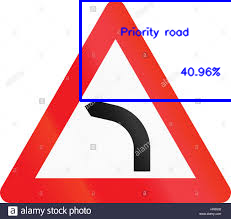

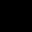

The Traffic signal in the images represents : Roundabout mandatory [40]


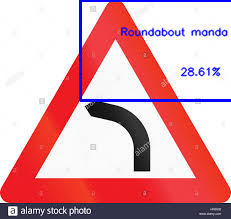

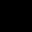

The Traffic signal in the images represents : Stop [14]


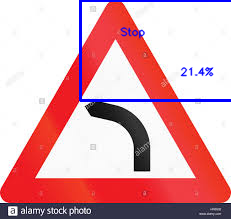

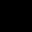

The Traffic signal in the images represents : Turn left ahead [34]


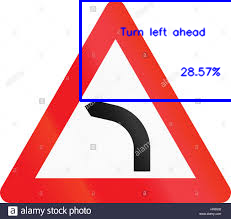

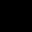

The Traffic signal in the images represents : Roundabout mandatory [40]


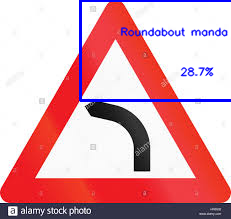

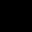

The Traffic signal in the images represents : Priority road [12]


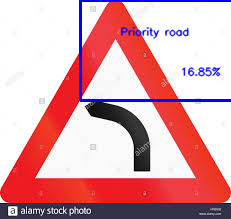

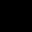

The Traffic signal in the images represents : Priority road [12]


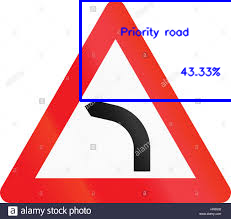

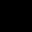

The Traffic signal in the images represents : Priority road [12]


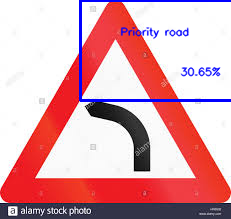

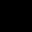

The Traffic signal in the images represents : Priority road [12]


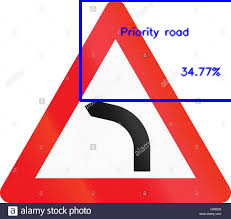

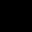

The Traffic signal in the images represents : Stop [14]


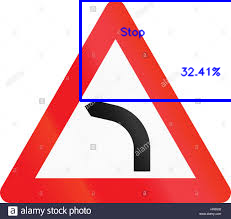

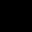

The Traffic signal in the images represents : Stop [14]


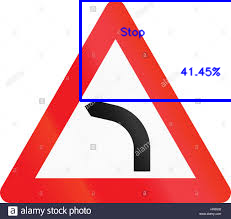

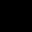

The Traffic signal in the images represents : Stop [14]


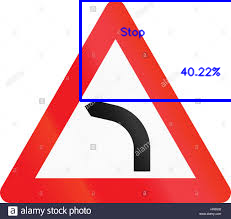

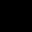

The Traffic signal in the images represents : Stop [14]


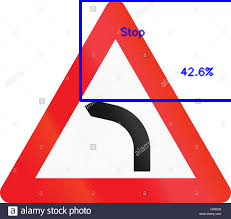

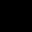

The Traffic signal in the images represents : Stop [14]


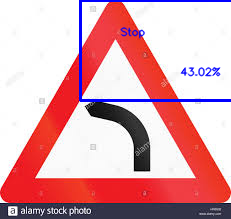

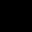

The Traffic signal in the images represents : Speed limit (120km/h) [8]


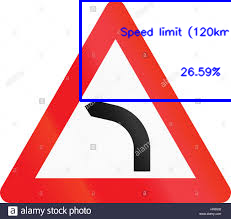

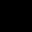

The Traffic signal in the images represents : Stop [14]


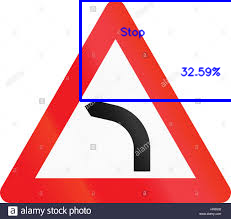

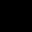

The Traffic signal in the images represents : No vechiles [15]


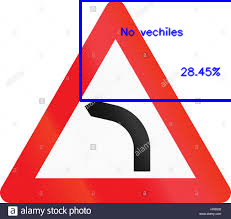

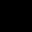

The Traffic signal in the images represents : Stop [14]


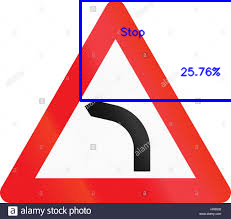

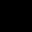

The Traffic signal in the images represents : Stop [14]


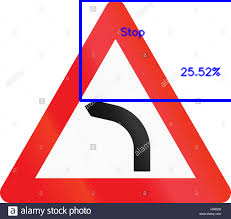

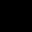

The Traffic signal in the images represents : Stop [14]


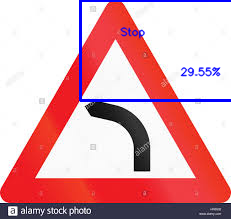

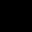

The Traffic signal in the images represents : Stop [14]


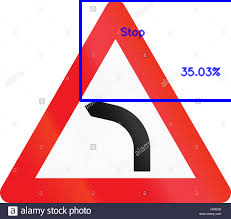

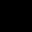

The Traffic signal in the images represents : Stop [14]


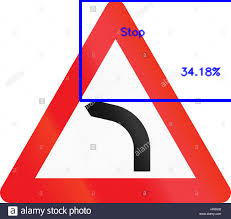

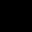

The Traffic signal in the images represents : Stop [14]


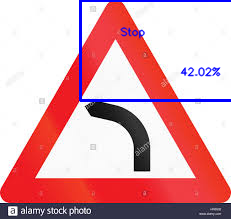

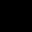

The Traffic signal in the images represents : Stop [14]


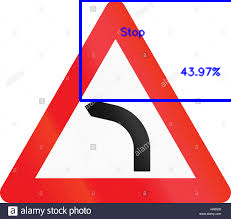

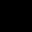

The Traffic signal in the images represents : Stop [14]


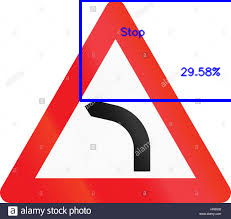

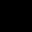

The Traffic signal in the images represents : Priority road [12]


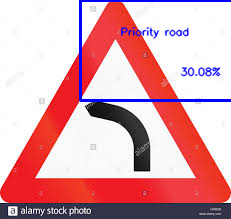

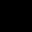

The Traffic signal in the images represents : Priority road [12]


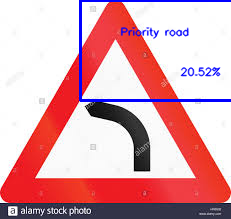

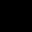

The Traffic signal in the images represents : Priority road [12]


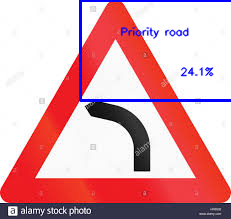

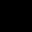

The Traffic signal in the images represents : Priority road [12]


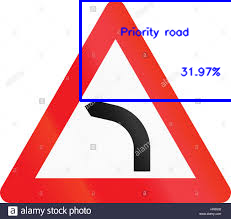

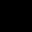

The Traffic signal in the images represents : Priority road [12]


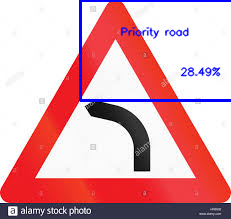

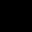

The Traffic signal in the images represents : No vechiles [15]


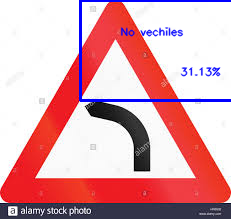

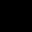

The Traffic signal in the images represents : No vechiles [15]


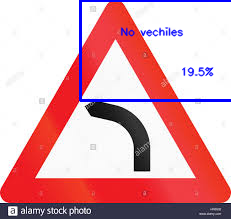

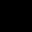

The Traffic signal in the images represents : No vechiles [15]


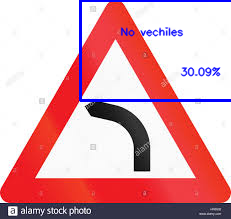

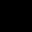

The Traffic signal in the images represents : Speed limit (120km/h) [8]


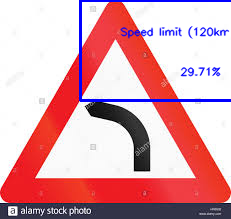

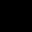

The Traffic signal in the images represents : Speed limit (120km/h) [8]


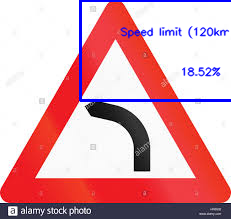

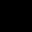

The Traffic signal in the images represents : No vechiles [15]


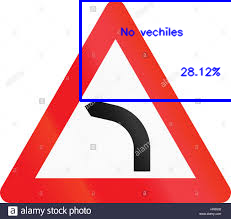

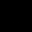

The Traffic signal in the images represents : Speed limit (120km/h) [8]


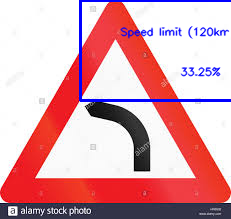

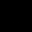

The Traffic signal in the images represents : Stop [14]


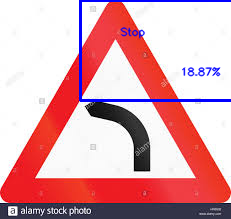

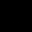

The Traffic signal in the images represents : Speed limit (120km/h) [8]


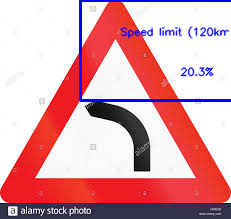

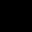

The Traffic signal in the images represents : Speed limit (120km/h) [8]


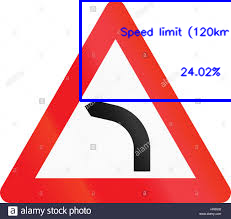

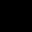

The Traffic signal in the images represents : Stop [14]


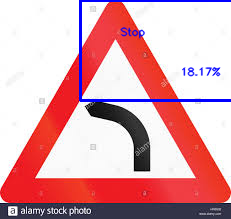

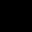

The Traffic signal in the images represents : Stop [14]


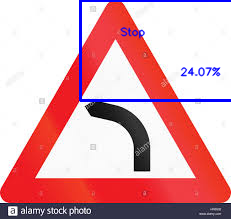

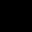

The Traffic signal in the images represents : No vechiles [15]


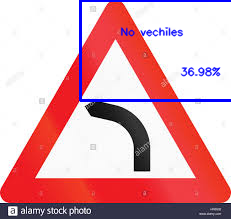

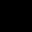

The Traffic signal in the images represents : Stop [14]


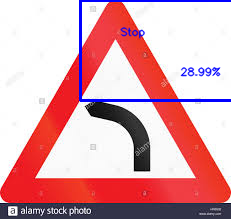

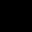

The Traffic signal in the images represents : No vechiles [15]


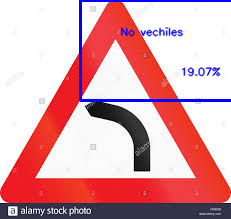

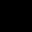

The Traffic signal in the images represents : Speed limit (120km/h) [8]


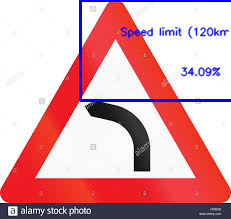

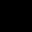

The Traffic signal in the images represents : No vechiles [15]


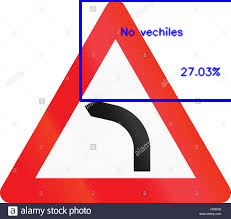

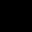

The Traffic signal in the images represents : Speed limit (120km/h) [8]


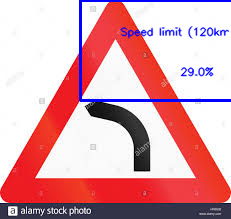

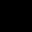

The Traffic signal in the images represents : No vechiles [15]


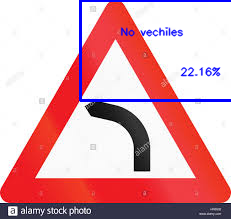

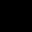

The Traffic signal in the images represents : Speed limit (120km/h) [8]


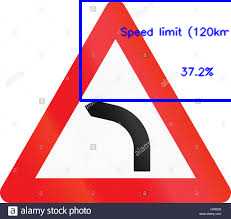

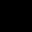

The Traffic signal in the images represents : Speed limit (120km/h) [8]


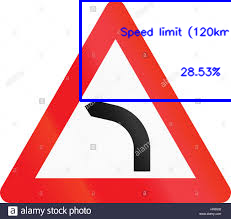

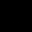

The Traffic signal in the images represents : No vechiles [15]


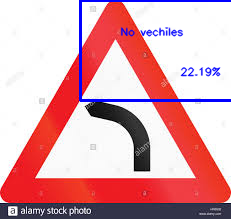

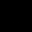

The Traffic signal in the images represents : Turn left ahead [34]


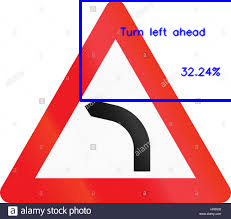

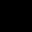

The Traffic signal in the images represents : Speed limit (120km/h) [8]


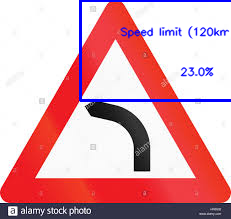

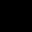

The Traffic signal in the images represents : Speed limit (120km/h) [8]


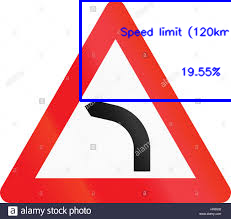

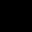

The Traffic signal in the images represents : Speed limit (120km/h) [8]


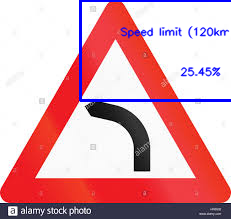

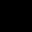

The Traffic signal in the images represents : Speed limit (120km/h) [8]


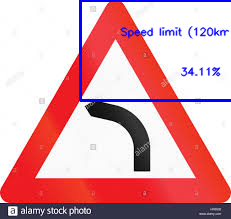

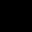

The Traffic signal in the images represents : Speed limit (120km/h) [8]


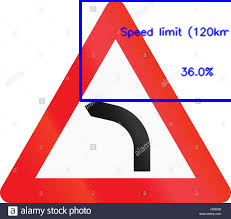

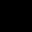

The Traffic signal in the images represents : Speed limit (120km/h) [8]


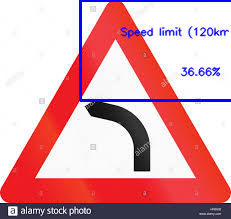

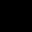

The Traffic signal in the images represents : Speed limit (120km/h) [8]


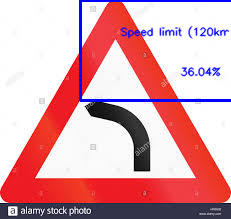

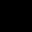

The Traffic signal in the images represents : Speed limit (120km/h) [8]


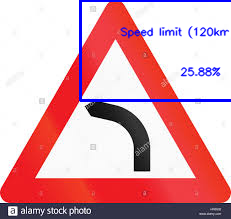

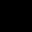

The Traffic signal in the images represents : Speed limit (120km/h) [8]


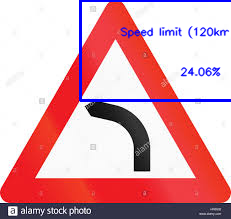

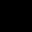

The Traffic signal in the images represents : No vechiles [15]


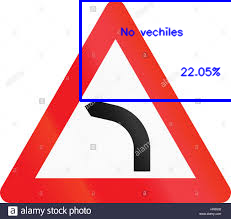

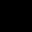

The Traffic signal in the images represents : Speed limit (120km/h) [8]


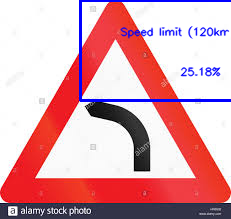

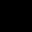

The Traffic signal in the images represents : Speed limit (120km/h) [8]


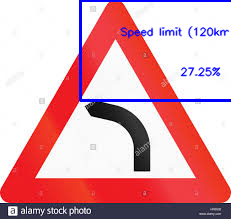

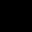

The Traffic signal in the images represents : Speed limit (120km/h) [8]


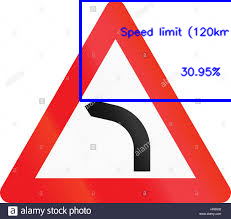

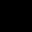

The Traffic signal in the images represents : Speed limit (120km/h) [8]


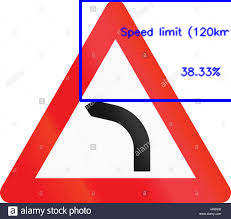

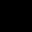

The Traffic signal in the images represents : No vechiles [15]


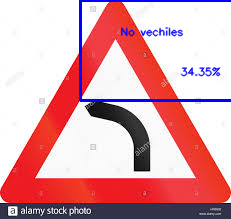

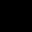

The Traffic signal in the images represents : Speed limit (120km/h) [8]


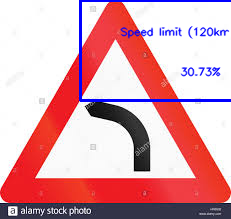

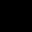

The Traffic signal in the images represents : Speed limit (60km/h) [3]


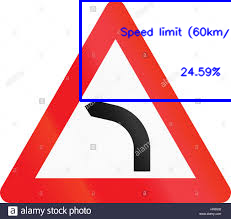

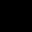

The Traffic signal in the images represents : Speed limit (120km/h) [8]


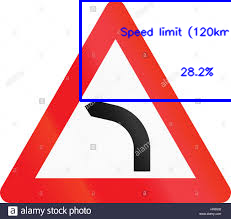

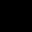

The Traffic signal in the images represents : Speed limit (120km/h) [8]


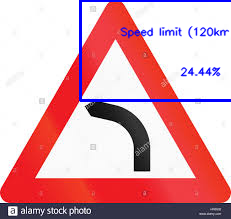

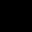

The Traffic signal in the images represents : Speed limit (120km/h) [8]


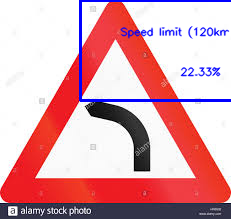

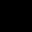

The Traffic signal in the images represents : Speed limit (120km/h) [8]


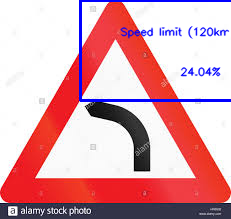

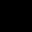

The Traffic signal in the images represents : Speed limit (120km/h) [8]


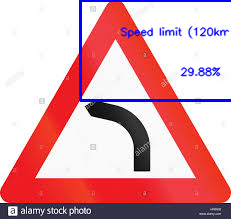

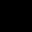

The Traffic signal in the images represents : Speed limit (120km/h) [8]


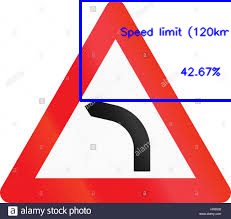

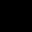

The Traffic signal in the images represents : Speed limit (120km/h) [8]


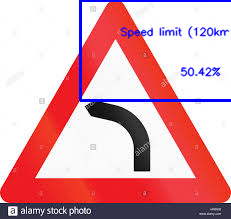

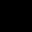

The Traffic signal in the images represents : Speed limit (120km/h) [8]


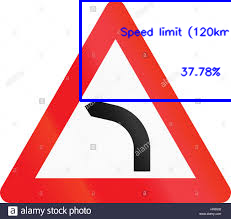

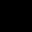

The Traffic signal in the images represents : Speed limit (120km/h) [8]


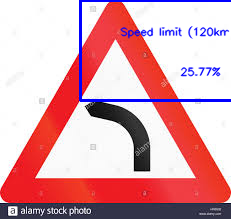

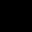

The Traffic signal in the images represents : Speed limit (120km/h) [8]


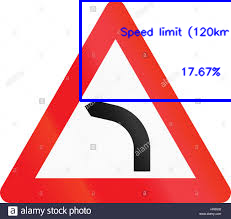

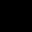

The Traffic signal in the images represents : Stop [14]


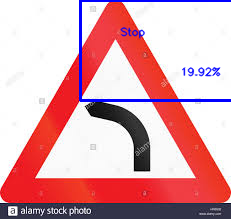

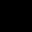

The Traffic signal in the images represents : Speed limit (60km/h) [3]


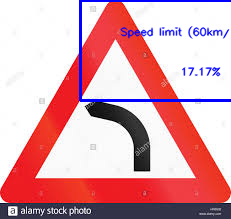

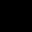

The Traffic signal in the images represents : Speed limit (120km/h) [8]


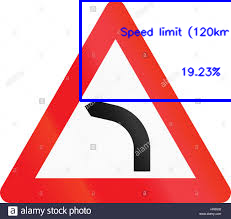

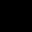

The Traffic signal in the images represents : No passing [9]


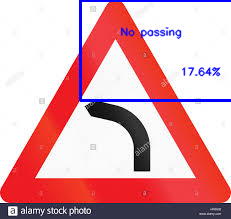

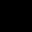

The Traffic signal in the images represents : Speed limit (120km/h) [8]


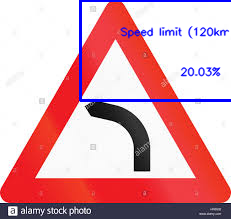

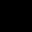

The Traffic signal in the images represents : Speed limit (120km/h) [8]


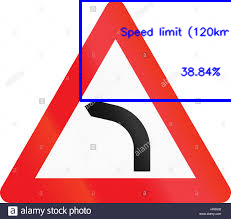

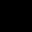

The Traffic signal in the images represents : Speed limit (120km/h) [8]


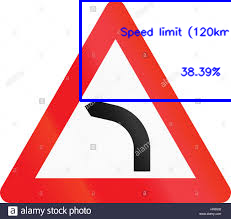

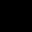

The Traffic signal in the images represents : Speed limit (120km/h) [8]


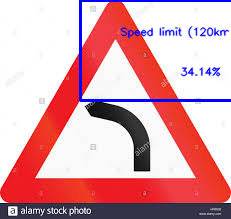

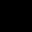

The Traffic signal in the images represents : Speed limit (60km/h) [3]


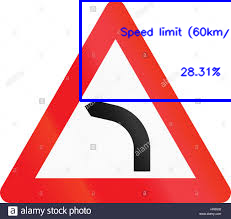

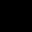

The Traffic signal in the images represents : Speed limit (60km/h) [3]


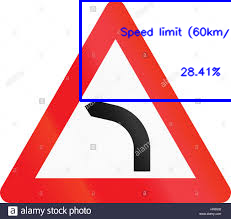

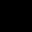

The Traffic signal in the images represents : Speed limit (120km/h) [8]


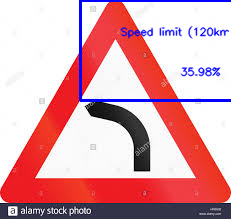

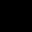

The Traffic signal in the images represents : Speed limit (60km/h) [3]


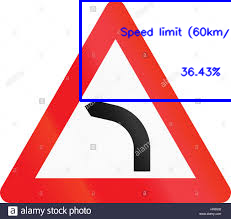

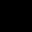

The Traffic signal in the images represents : Speed limit (60km/h) [3]


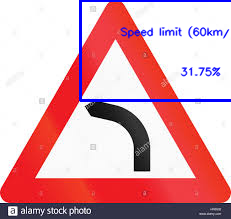

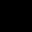

The Traffic signal in the images represents : Speed limit (120km/h) [8]


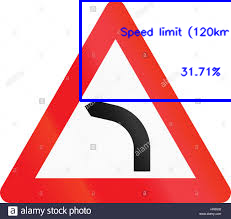

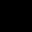

The Traffic signal in the images represents : No vechiles [15]


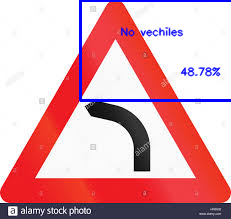

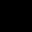

The Traffic signal in the images represents : No vechiles [15]


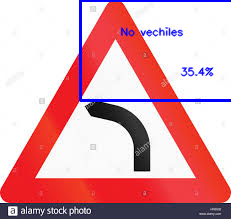

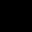

The Traffic signal in the images represents : No vechiles [15]


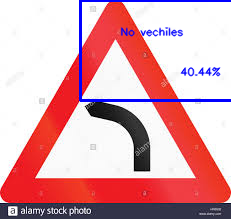

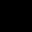

The Traffic signal in the images represents : No vechiles [15]


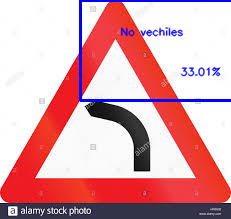

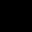

The Traffic signal in the images represents : Stop [14]


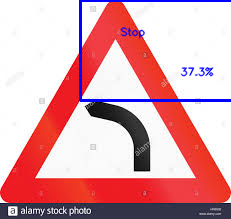

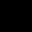

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


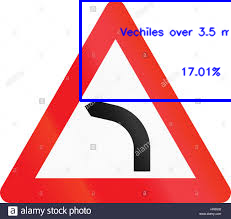

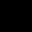

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


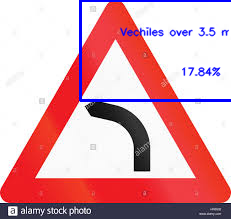

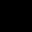

The Traffic signal in the images represents : Priority road [12]


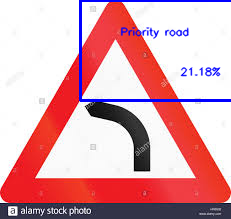

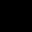

The Traffic signal in the images represents : Priority road [12]


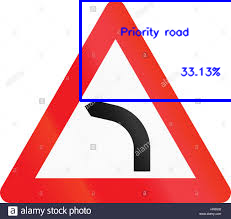

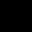

The Traffic signal in the images represents : Roundabout mandatory [40]


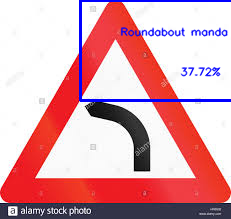

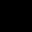

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


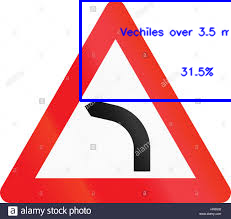

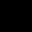

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


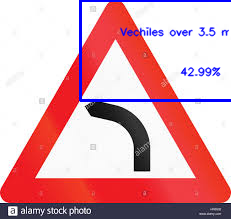

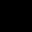

The Traffic signal in the images represents : Roundabout mandatory [40]


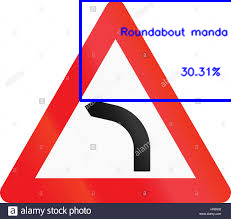

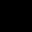

The Traffic signal in the images represents : Keep right [38]


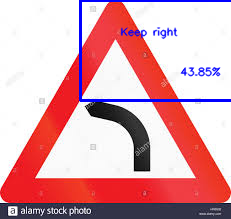

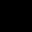

The Traffic signal in the images represents : Keep right [38]


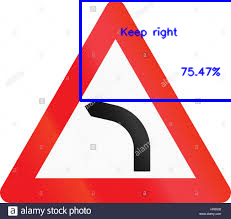

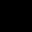

The Traffic signal in the images represents : Priority road [12]


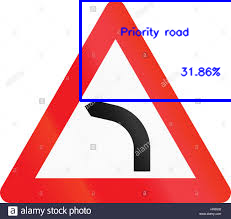

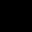

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


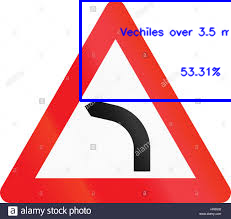

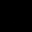

The Traffic signal in the images represents : Stop [14]


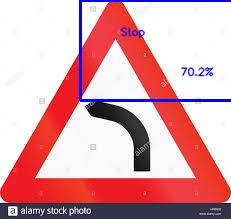

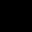

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


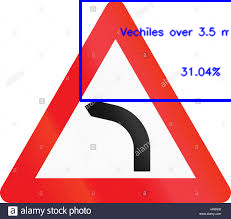

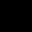

The Traffic signal in the images represents : Priority road [12]


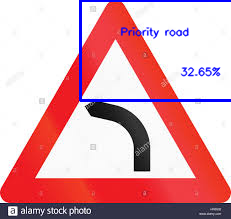

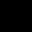

The Traffic signal in the images represents : Priority road [12]


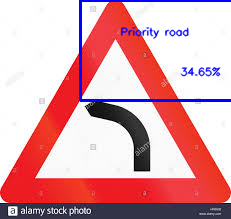

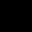

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


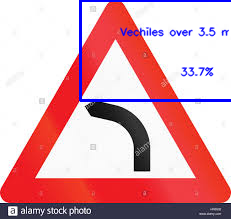

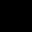

The Traffic signal in the images represents : Keep right [38]


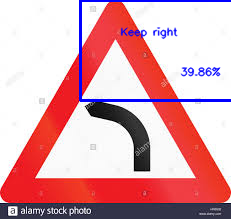

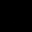

The Traffic signal in the images represents : Priority road [12]


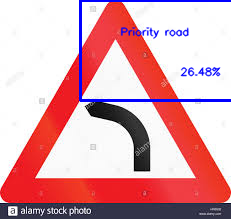

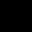

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


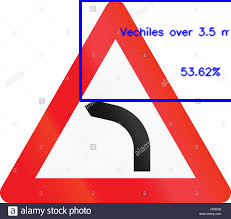

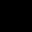

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


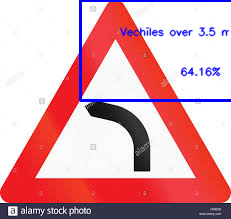

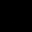

The Traffic signal in the images represents : Vechiles over 3.5 metric tons prohibited [16]


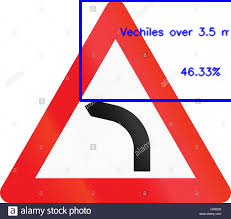

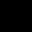

The Traffic signal in the images represents : Roundabout mandatory [40]


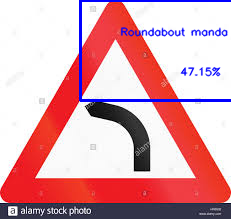

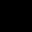

The Traffic signal in the images represents : Yield [13]


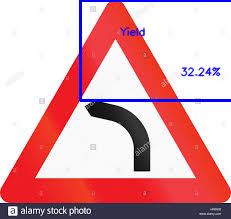

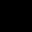

The Traffic signal in the images represents : Priority road [12]


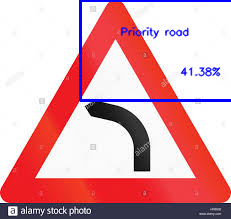

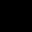

The Traffic signal in the images represents : No vechiles [15]


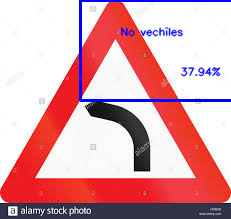

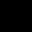

The Traffic signal in the images represents : Roundabout mandatory [40]


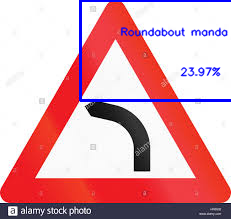

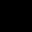

The Traffic signal in the images represents : Priority road [12]


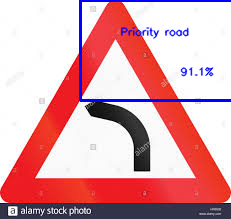

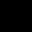

The Traffic signal in the images represents : Keep right [38]


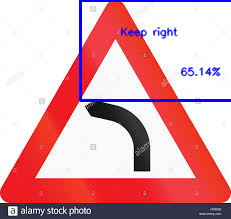

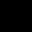

The Traffic signal in the images represents : Priority road [12]


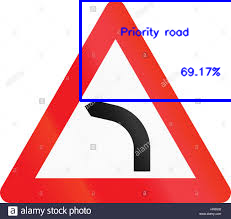

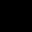

The Traffic signal in the images represents : Priority road [12]


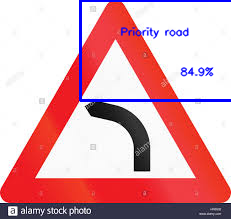

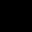

The Traffic signal in the images represents : Priority road [12]


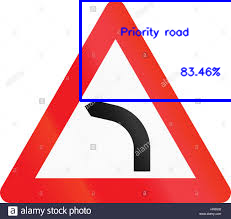

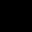

The Traffic signal in the images represents : No vechiles [15]


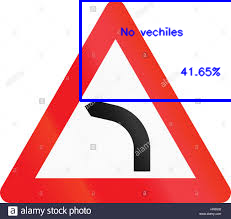

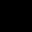

The Traffic signal in the images represents : Priority road [12]


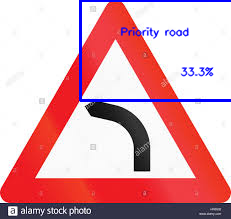

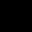

The Traffic signal in the images represents : No vechiles [15]


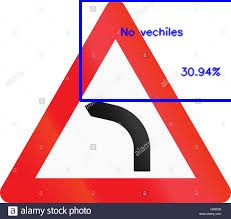

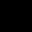

The Traffic signal in the images represents : No vechiles [15]


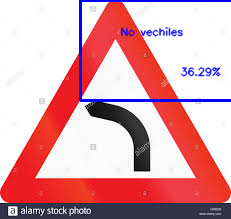

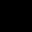

The Traffic signal in the images represents : No vechiles [15]


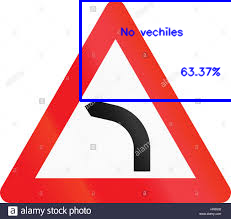

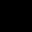

The Traffic signal in the images represents : No vechiles [15]


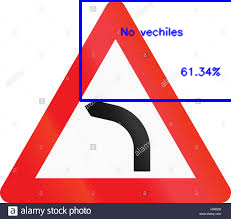

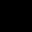

The Traffic signal in the images represents : No vechiles [15]


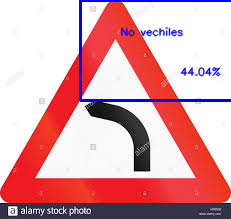

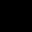

The Traffic signal in the images represents : Speed limit (100km/h) [7]


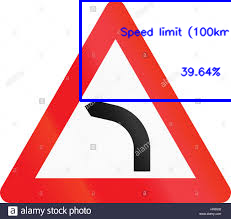

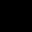

The Traffic signal in the images represents : No vechiles [15]


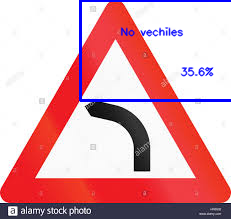

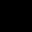

The Traffic signal in the images represents : Speed limit (100km/h) [7]


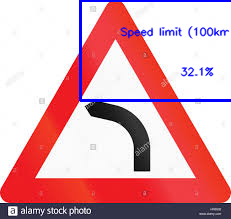

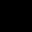

The Traffic signal in the images represents : Speed limit (120km/h) [8]


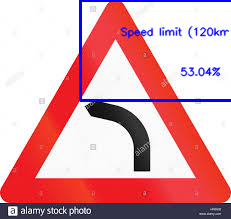

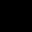

The Traffic signal in the images represents : No vechiles [15]


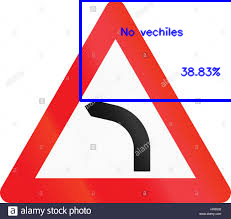

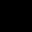

The Traffic signal in the images represents : No vechiles [15]


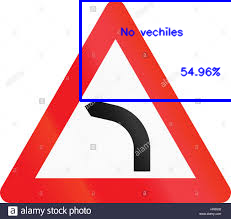

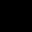

The Traffic signal in the images represents : Priority road [12]


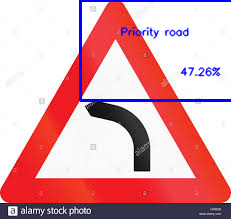

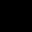

The Traffic signal in the images represents : No vechiles [15]


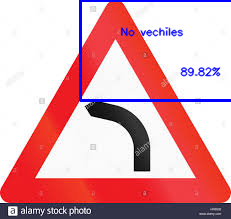

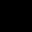

The Traffic signal in the images represents : Speed limit (100km/h) [7]


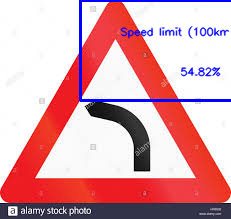

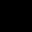

The Traffic signal in the images represents : No vechiles [15]


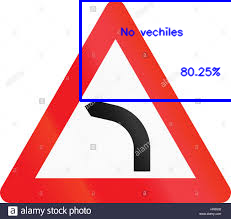

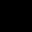

The Traffic signal in the images represents : No vechiles [15]


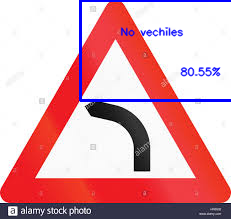

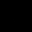

The Traffic signal in the images represents : No vechiles [15]


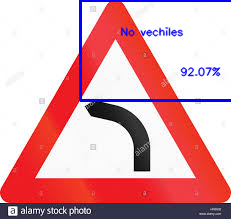

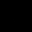

The Traffic signal in the images represents : No vechiles [15]


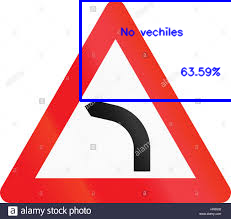

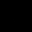

The Traffic signal in the images represents : No vechiles [15]


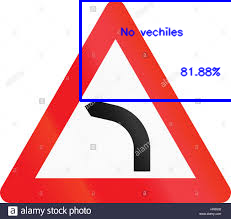

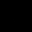

The Traffic signal in the images represents : No vechiles [15]


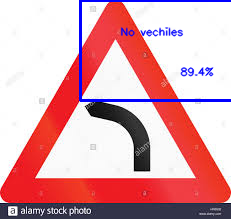

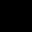

The Traffic signal in the images represents : No vechiles [15]


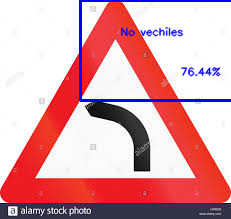

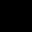

The Traffic signal in the images represents : No vechiles [15]


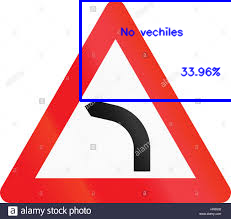

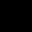

The Traffic signal in the images represents : No vechiles [15]


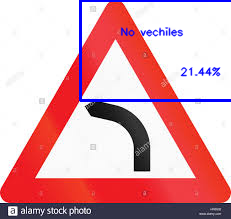

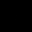

The Traffic signal in the images represents : No vechiles [15]


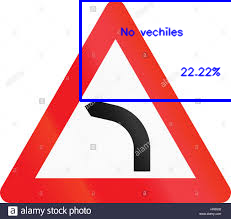

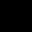

The Traffic signal in the images represents : Dangerous curve to the right [20]


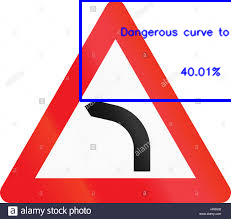

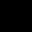

The Traffic signal in the images represents : Dangerous curve to the right [20]


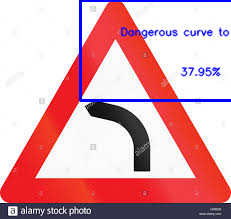

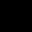

The Traffic signal in the images represents : Dangerous curve to the right [20]


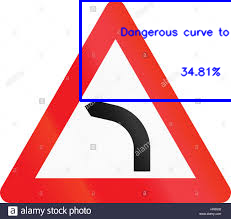

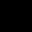

The Traffic signal in the images represents : Dangerous curve to the right [20]


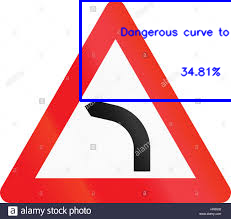

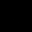

The Traffic signal in the images represents : Children crossing [28]


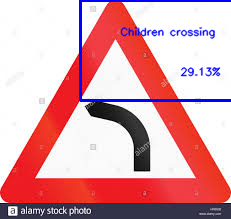

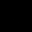

The Traffic signal in the images represents : Children crossing [28]


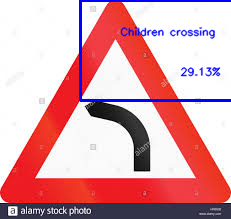

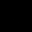

The Traffic signal in the images represents : Children crossing [28]


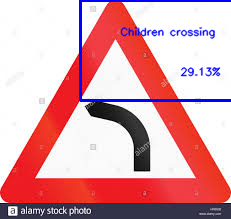

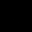

The Traffic signal in the images represents : Children crossing [28]


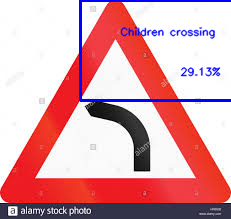

In [246]:
while True:
  # READ IMAGE
  success,img = cap.read()
  cap.set(3, frameWidth)
  cap.set(4, frameHeight)
  cap.set(10, brightness)
 
  # PROCESS IMAGE
  if success:
    img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, (32,32)) 
    img = cv2.equalizeHist(img)
    img = img/255.0
    cv2_imshow(img)
    img = img.reshape(1, 32, 32, 1)
    make_predictions(img)
  else :
    break
 